In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

!pip install dgl -f https://data.dgl.ai/wheels/repo.html

import dgl
import torch
import torch.nn as nn
import torch.nn.functional as F
import urllib.request
import pandas as pd
import dgl.data
import dgl
from dgl.data import DGLDataset
import torch
import os
import itertools
import dgl.nn as dglnn
from dgl.nn import GraphConv


from scipy.spatial import Delaunay
from sklearn.metrics import f1_score
import numpy as np

Mounted at /content/gdrive
Looking in links: https://data.dgl.ai/wheels/repo.html
     |████████████████████████████████| 5.7 MB 401 kB/s 
Setting the default backend to "pytorch". You can change it in the ~/.dgl/config.json file or export the DGLBACKEND environment variable.  Valid options are: pytorch, mxnet, tensorflow (all lowercase)


DGL backend not selected or invalid.  Assuming PyTorch for now.
Using backend: pytorch


In [ ]:
def save(self):
    # save graphs and labels
    graph_path = os.path.join(self.save_path, self.mode + '_dgl_graph.bin')
    save_graphs(graph_path, self.graphs, {'labels': self.labels})
    # save other information in python dict
    info_path = os.path.join(self.save_path, self.mode + '_info.pkl')
    save_info(info_path, {'num_classes': self.num_classes})

def load(self):
    # load processed data from directory `self.save_path`
    graph_path = os.path.join(self.save_path, self.mode + '_dgl_graph.bin')
    self.graphs, label_dict = load_graphs(graph_path)
    self.labels = label_dict['labels']
    info_path = os.path.join(self.save_path, self.mode + '_info.pkl')
    self.num_classes = load_info(info_path)['num_classes']

def has_cache(self):
    # check whether there are processed data in `self.save_path`
    graph_path = os.path.join(self.save_path, self.mode + '_dgl_graph.bin')
    info_path = os.path.join(self.save_path, self.mode + '_info.pkl')
    return os.path.exists(graph_path) and os.path.exists(info_path)

168

In [2]:
def sim2ed(simp):
  src = []
  dst = []
  for i in simp:
    src.append(i[0])
    dst.append(i[1])
    src.append(i[1])
    dst.append(i[2])
    src.append(i[2])
    dst.append(i[0])
  return src,dst

def int2str(ord):
  int_2_str = [chr(i) for i in ord]
  int_2_str = ''.join(int_2_str)
  return int_2_str

In [3]:
from dgl import save_graphs, load_graphs
from dgl.data.utils import makedirs, save_info, load_info

src = []
dst = []
result = 0
class gds(DGLDataset):
    def __init__(self):
        super().__init__(name='gds')

        #self.save_path = 'gdrive/MyDrive/Graph/save'
        #self.num_classes = 1


    def process(self):
      
      self.graphs = []
      self.labels = []
      self.fname = []
      self.chart_type = []

      for folder in os.listdir('gdrive/MyDrive/csv'):

        if folder == ".DS_Store":
          continue

        for file in os.listdir('gdrive/MyDrive/csv/' + folder):
          
          g_pd = pd.read_csv('gdrive/MyDrive/csv/' + folder + '/' + file)
          ids = len(g_pd['id'])

          

          

          #feat = g_pd[["chart_1", "chart_2", "chart_3", "chart_4", "chart_5", "chart_6", "chart_7", "chart_8", "chart_9", "chart_10", "chart_11", "chart_12", "chart_13", "chart_14", "chart_15"]]
          feat = g_pd[["chart_1", "chart_2", "chart_3", "chart_4", "chart_5", "chart_6", "chart_7", "chart_8", "chart_9", "chart_10", "chart_11", "chart_12", "chart_13", "chart_14", "chart_15", "width", "height", "x0", "x1", "x2", "x3", "y0", "y1", "y2", "y3"]]


          bbox = g_pd[["x0", "x1", "x2", "x3", "y0", "y1", "y2", "y3"]]
          bbox_x = (g_pd["x1"] - g_pd["x0"])/2 + g_pd["x0"]
          bbox_y = (g_pd["y1"] - g_pd["y0"])/2 + g_pd["y0"]
          frames = [bbox_x, bbox_y]

         
          result = pd.concat(frames, axis=1)
          
        
          label = g_pd['class']
          src = []
          dst = []
       
          try:
            tri = Delaunay(result)
            src, dst = sim2ed(tri.simplices)
            g = dgl.graph((src, dst))
            g.ndata['feat'] = torch.from_numpy(feat.to_numpy())
            g.ndata['label'] = torch.from_numpy(label.astype('category').cat.codes.to_numpy())
          except:
            g = dgl.graph((g_pd['id'], g_pd['id']))
            print(torch.from_numpy(feat.to_numpy()).shape)
            print(label.astype('category').cat.codes.to_numpy().shape)
            g.ndata['feat'] = torch.from_numpy(feat.to_numpy())
            g.ndata['label'] = torch.from_numpy(label.astype('category').cat.codes.to_numpy())

            """
            g_path = "/"+folder+"/"+file
            g_path = [ord(i) for i in g_path]
            g_path = np.array(g_path, dtype=np.int)
            print(g_path)
            #g.ntypes['fname'] = torch.from_numpy(g_path)
            g.nty = g_path
            """
            
         
            
          self.graphs.append(g)
         
          self.labels.append(label)
          self.fname.append("/"+folder+"/"+file)
          self.chart_type.append(folder)

          
    def __getitem__(self, i):
        return self.graphs[i], self.labels[i], self.fname[i], self.chart_type[i]

    def __len__(self):
        return len(self.graphs)

    """
    def save(self):
        # save graphs and labels
        graph_path = os.path.join(self.save_path, 'csv.bin')
        save_graphs(graph_path, self.graphs, {'labels': self.labels})
        # save other information in python dict
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        save_info(info_path, {'num_classes': self.num_classes})

    def load(self):
        # load processed data from directory `self.save_path`
        graph_path = os.path.join(self.save_path, 'csv.bin')
        self.graphs, label_dict = load_graphs(graph_path)
        self.labels = label_dict['labels']
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        self.num_classes = load_info(info_path)['num_classes']

    def has_cache(self):
        # check whether there are processed data in `self.save_path`
        graph_path = os.path.join(self.save_path, 'csv.bin')
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        return os.path.exists(graph_path) and os.path.exists(info_path)
    """

dataset = gds()
graph, label, fname_0, chart_type_0 = dataset[0]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:58: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)


torch.Size([2, 25])
(2,)
torch.Size([6, 25])
(6,)


In [4]:
src = []
dst = []
result = 0
class gds_test(DGLDataset):
    def __init__(self):
        super().__init__(name='gds_test')



    def process(self):
      
      self.graphs = []
      self.labels = []
      self.fname = []
      self.chart_type = []

      for file in os.listdir('gdrive/MyDrive/csv_test/split_1/csv/'):

        if file == ".DS_Store":
          continue

      
        
        g_pd = pd.read_csv('gdrive/MyDrive/csv_test/split_1/csv/' + file)
        ids = len(g_pd['id'])

        

        

        #feat = g_pd[["chart_1", "chart_2", "chart_3", "chart_4", "chart_5", "chart_6", "chart_7", "chart_8", "chart_9", "chart_10", "chart_11", "chart_12", "chart_13", "chart_14", "chart_15"]]
        feat = g_pd[["chart_1", "chart_2", "chart_3", "chart_4", "chart_5", "chart_6", "chart_7", "chart_8", "chart_9", "chart_10", "chart_11", "chart_12", "chart_13", "chart_14", "chart_15", "width", "height", "x0", "x1", "x2", "x3", "y0", "y1", "y2", "y3"]]


        bbox = g_pd[["x0", "x1", "x2", "x3", "y0", "y1", "y2", "y3"]]
        bbox_x = (g_pd["x1"] - g_pd["x0"])/2 + g_pd["x0"]
        bbox_y = (g_pd["y1"] - g_pd["y0"])/2 + g_pd["y0"]
        frames = [bbox_x, bbox_y]

        
        result = pd.concat(frames, axis=1)
        
      
        label = g_pd['class']
        src = []
        dst = []
      
        try:
          tri = Delaunay(result)
          src, dst = sim2ed(tri.simplices)
          g = dgl.graph((src, dst))
          g.ndata['feat'] = torch.from_numpy(feat.to_numpy())
          g.ndata['label'] = torch.from_numpy(label.astype('category').cat.codes.to_numpy())
        except:
          g = dgl.graph((g_pd['id'], g_pd['id']))
          print(torch.from_numpy(feat.to_numpy()).shape)
          print(label.astype('category').cat.codes.to_numpy().shape)
          g.ndata['feat'] = torch.from_numpy(feat.to_numpy())
          g.ndata['label'] = torch.from_numpy(label.astype('category').cat.codes.to_numpy())

          
        
          
        self.graphs.append(g)
        
        self.labels.append(label)
        self.fname.append(file)
        #self.fname.append("/split_1/csv/"+file)
        self.chart_type.append(g_pd['chart_type'][0])

          
    def __getitem__(self, i):
        return self.graphs[i], self.labels[i], self.fname[i], self.chart_type[i]

    def __len__(self):
        return len(self.graphs)

    """
    def save(self):
        # save graphs and labels
        graph_path = os.path.join(self.save_path, 'csv.bin')
        save_graphs(graph_path, self.graphs, {'labels': self.labels})
        # save other information in python dict
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        save_info(info_path, {'num_classes': self.num_classes})

    def load(self):
        # load processed data from directory `self.save_path`
        graph_path = os.path.join(self.save_path, 'csv.bin')
        self.graphs, label_dict = load_graphs(graph_path)
        self.labels = label_dict['labels']
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        self.num_classes = load_info(info_path)['num_classes']

    def has_cache(self):
        # check whether there are processed data in `self.save_path`
        graph_path = os.path.join(self.save_path, 'csv.bin')
        info_path = os.path.join(self.save_path, 'csv_info.pkl')
        return os.path.exists(graph_path) and os.path.exists(info_path)
    """

dataset_test = gds_test()
graph, label, fname_0, chart_type_0 = dataset_test[0]

In [ ]:
###
    def save(self):
        # save graphs and labels
        graph_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '.bin')
        save_graphs(graph_path, self.graphs, {'labels': self.labels})
        # save other information in python dict
        info_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '_info.pkl')
        save_info(info_path, {'num_classes': self.num_classes})

    def load(self):
        # load processed data from directory `self.save_path`
        graph_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '.bin')
        self.graphs, label_dict = load_graphs(graph_path)
        self.labels = label_dict['labels']
        info_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '_info.pkl')
        self.num_classes = load_info(info_path)['num_classes']

    def has_cache(self):
        # check whether there are processed data in `self.save_path`
        graph_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '.bin')
        info_path = os.path.join(self.save_path, self.graphs.ndata['fname'] + '_info.pkl')
        return os.path.exists(graph_path) and os.path.exists(info_path)
    ###

In [5]:
class GCN(nn.Module):
    def __init__(self, in_feats, h_feats, num_classes):
        super(GCN, self).__init__()
        self.conv1 = dglnn.SAGEConv(
            in_feats=in_feats, out_feats=h_feats, aggregator_type='mean')
        self.conv2 = dglnn.SAGEConv(
            in_feats=h_feats, out_feats=num_classes, aggregator_type='mean')

    def forward(self, g, in_feat):
        h = self.conv1(g, in_feat)
        h = F.relu(h)
        h = self.conv2(g, h)
        return h


In [6]:
def train(g, model, optimizer):
    
    best_val_acc = 0
    best_test_acc = 0

    features = g.ndata['feat']
    labels = g.ndata['label']
    print("Labels",labels)
  
    
    for e in range(20): 
      
        logits = model(g, features.float()).type(torch.float)
        logits = torch.squeeze(logits)
        #lg = torch.sigmoid(logits)
        
    
       

        labels = labels.type(torch.float)

        loss = torch.nn.functional.binary_cross_entropy_with_logits(logits, labels)
    
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if e == 0 or e == 19:
          lg = torch.sigmoid(logits)
          print("Sig",lg)
          print("Labels",labels)
          print("Loss", loss)


In [10]:
def eval(g, model):
    
    model.eval()
    best_val_acc = 0
    best_test_acc = 0

    features = g.ndata['feat']
    labels = g.ndata['label']
    #print("Features",features[0][0:15])
    #print("Labels",labels)

    with torch.no_grad():
      torch.set_grad_enabled(False)
      logits = model(g, features.float()).type(torch.float)
      
      logits = torch.squeeze(logits)
          

      labels = labels.type(torch.float)
      lg = torch.sigmoid(logits)
      
      threshold = torch.tensor([0.5])
      # preds = (lg>threshold).float()*1
      preds = (lg>threshold).float()


      #print("Preds",preds)
    
      f1 = f1_score(labels.numpy(), preds.numpy())
      #print("F1 Score ",f1)

      acc  = (torch.sum(labels == preds)/labels.shape[0])*100

      #print("Accuracy ",acc)
      return f1, preds, labels


In [8]:
model = GCN(graph.ndata['feat'].shape[1], 16, 1)
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

checkpoint = torch.load('gdrive/MyDrive/Graph/g9-model.ckpt')


model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch'] + 1
loss = checkpoint['loss']


#train(graph, model, optimizer)

In [ ]:
epochs = 40

for ep in range(epochs):
  for g_i, g_val in enumerate(dataset):
    #print("gval",g_val[0].ndata['label'])
    train(g_val[0], model, optimizer)


torch.save({
        'epoch': 40,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': 0
        }, './g9-model.ckpt')

Streaming output truncated to the last 5000 lines.
Loss tensor(0.2625, grad_fn=<BinaryCrossEntropyWithLogitsBackward0>)
Labels tensor([0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0],
       dtype=torch.int8)
Sig tensor([9.5192e-03, 2.2335e-06, 8.8014e-01, 8.3562e-01, 9.8863e-01, 9.8583e-01,
        9.7842e-01, 9.7398e-01, 9.7037e-01, 9.3299e-01, 8.8747e-01, 5.5607e-01,
        9.3002e-01, 7.2824e-01, 2.7647e-01, 3.6575e-01, 7.7217e-01, 6.5279e-01,
        6.9791e-01, 9.8178e-01, 4.6151e-03, 5.0027e-03, 1.6147e-03],
       grad_fn=<SigmoidBackward0>)
Labels tensor([0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 0., 0., 0.])
Loss tensor(0.2153, grad_fn=<BinaryCrossEntropyWithLogitsBackward0>)
Sig tensor([3.0274e-02, 1.5930e-06, 8.9501e-01, 8.7806e-01, 9.9293e-01, 9.8844e-01,
        9.8456e-01, 9.8126e-01, 9.7884e-01, 9.5529e-01, 9.2127e-01, 6.5793e-01,
        9.1956e-01, 9.0394e-01, 6.7262e-01, 7.0308e-01, 9.2880e-01, 8.331

In [26]:
def plot_bbox(img, preds, labels, bbox):


  for i in range(bbox.shape[0]):
    if (preds[i] == labels[i]) and (labels[i]==1):
      img = cv2.rectangle(img, (bbox[i][0],bbox[i][4]), (bbox[i][2],bbox[i][6]), (0, 255, 0), 2)
    elif (preds[i] == labels[i]) and (labels[i]==0):
      img = cv2.rectangle(img, (bbox[i][0],bbox[i][4]), (bbox[i][2],bbox[i][6]), (0, 0, 255), 2)
    elif (preds[i] != labels[i]) and (labels[i]==0):
      img = cv2.rectangle(img, (bbox[i][0],bbox[i][4]), (bbox[i][2],bbox[i][6]), (50,180,100), 2)
    elif (preds[i] != labels[i]) and (labels[i]==1):
      img = cv2.rectangle(img, (bbox[i][0],bbox[i][4]), (bbox[i][2],bbox[i][6]), (0,180,180), 2)
    

  return img

In [24]:
import cv2
from google.colab.patches import cv2_imshow


def eval_test(g_val, model):
    
    g = g_val[0]
    filename = g_val[2]
    filename = os.path.splitext(filename)[0]
    filename = 'gdrive/MyDrive/csv_test/split_1/images/' + filename + '.jpg'
    
    model.eval()
    best_val_acc = 0
    best_test_acc = 0

    features = g.ndata['feat']
    labels = g.ndata['label']

    bbox = g.ndata['feat'][:,17:]
  
    #print("Features",features[0][0:15])
    #print("Labels",labels)
    preds = None
    
    with torch.no_grad():
      torch.set_grad_enabled(False)
      logits = model(g, features.float()).type(torch.float)
      
      logits = torch.squeeze(logits)
          

      labels = labels.type(torch.float)
      lg = torch.sigmoid(logits)
      
      threshold = torch.tensor([0.5])
      # preds = (lg>threshold).float()*1
      preds = (lg>threshold).float()


      #print("Preds",preds)
    
      f1 = f1_score(labels.numpy(), preds.numpy())
      print("F1 Score ",f1)

      acc  = (torch.sum(labels == preds)/labels.shape[0])*100

      #print("Accuracy ",acc)


    

    img = cv2.imread(filename, cv2.IMREAD_UNCHANGED)

    img = plot_bbox(img, preds, labels, bbox)

    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    return f1, preds, labels


In [22]:
##Rough g9
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

Average F1 Score : 0.9216835713996757


In [21]:
##Rough g9
cls_list = ["area", "heatmap", "horizontal bar", "horizontal interval", "line", "manhattan", "map", "pie", "scatter", "scatter-line", "surface", "venn", "vertical bar", "vertical box", "vertical interval"]

for cls in cls_list:
  cnt = 0
  f1_net = 0 
  for g_i, g_val in enumerate(dataset_test):
    if g_val[3] == cls:
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

  if cnt > 0:
    print("Average F1 Score for class ",cls)
    print(f1_net/cnt)

Average F1 Score for class  horizontal bar
0.8271082006022984
Average F1 Score for class  line
0.9444133232086483
Average F1 Score for class  scatter
0.9511421698447455
Average F1 Score for class  vertical bar
0.9197010183912389
Average F1 Score for class  vertical box
0.8986089858174345


In [9]:
##Rough g9
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    #if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
F1 Score  0.9032258064516129
F1 Score  0.8666666666666666
F1 Score  0.7407407407407407
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9523809523809523
F1 Score  1.0
F1 Score  0.7222222222222222
F1 Score  0.9714285714285714
F1 Score  1.0
F1 Score  0.8837209302325582
F1 Score  1.0
F1 Score  1.0
F1 Score  0.6923076923076923
F1 Score  0.9767441860465117
F1 Score  0.9333333333333333
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  1.0
F1 Score  0.9523809523809523
F1 Score  0.7647058823529412
F1 Score  1.0
F1 Score  0.8695652173913043
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8750000000000001
F1 Score  0.9444444444444444
F1 Score  1.0
F1 Score  0.8
F1 Score  0.3
F1 Score  0.7999999999999999
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  0.75
F1 Score  0.962962962962963
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9523809523809523
F1 Score  0.955223880597015
F1 Score  0.7692307692307693
F1 Score  1.0
F1 Score  1.0
F1 Score  0.896551724137931

In [ ]:
##Rough
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
  filename = g_val[2]
  filename = os.path.splitext(filename)[0]
  filename = 'gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/' + filename + '.jpg'

  print(filename)
  if os.path.exists(filename):
    f1_i,_a,_b = eval_test(g_val, model)
    f1_net += f1_i
    cnt += 1
  else:
    print("None")

  if cnt == 100:
    break

print("Average F1 Score :",f1_net/cnt)

In [ ]:
##Rough
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
  filename = g_val[2]
  filename = os.path.splitext(filename)[0]
  filename = 'gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/' + filename + '.jpg'

  print(filename)
  if os.path.exists(filename):
    f1_i,_a,_b = eval_test(g_val, model)
    f1_net += f1_i
    cnt += 1
  else:
    print("None")

  if cnt == 100:
    break

print("Average F1 Score :",f1_net/cnt)

gdrive/MyDrive/csv_test/split_1/images/PMC5503366___materials-10-00253-g011.jpg
F1 Score  1.0


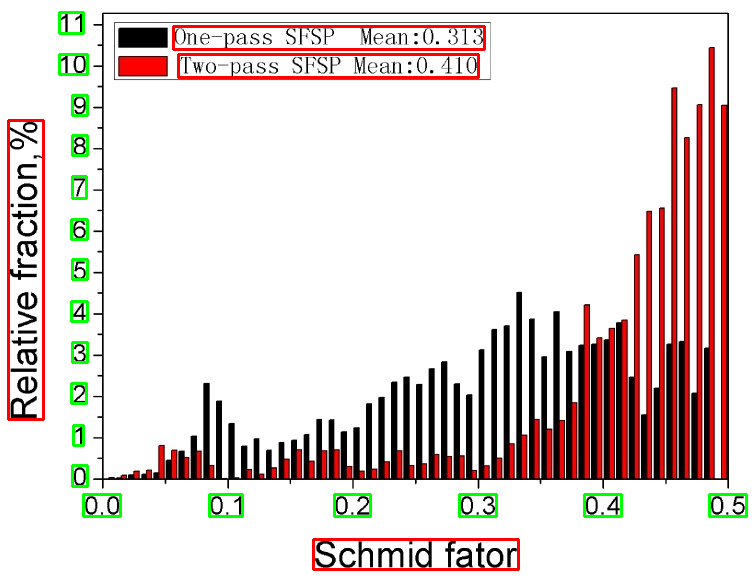

gdrive/MyDrive/csv_test/split_1/images/PMC5304621___nanomaterials-05-01147-g002.jpg
F1 Score  0.9032258064516129


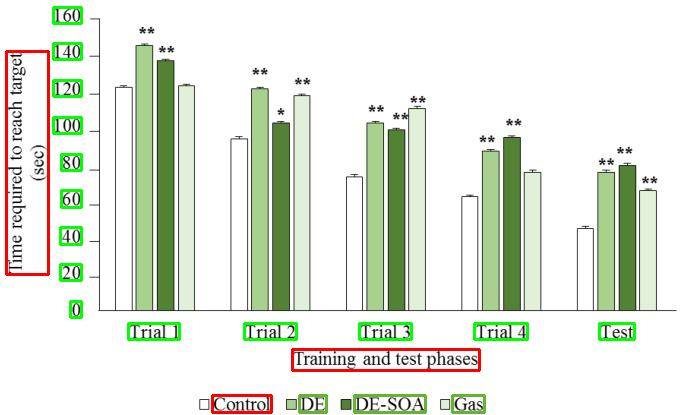

gdrive/MyDrive/csv_test/split_1/images/PMC4643511___12889_2015_2482_Fig2_HTML.jpg
F1 Score  0.8666666666666666


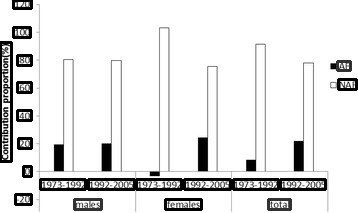

gdrive/MyDrive/csv_test/split_1/images/PMC3524603___ijerph-09-03883-g006.jpg
F1 Score  0.7407407407407407


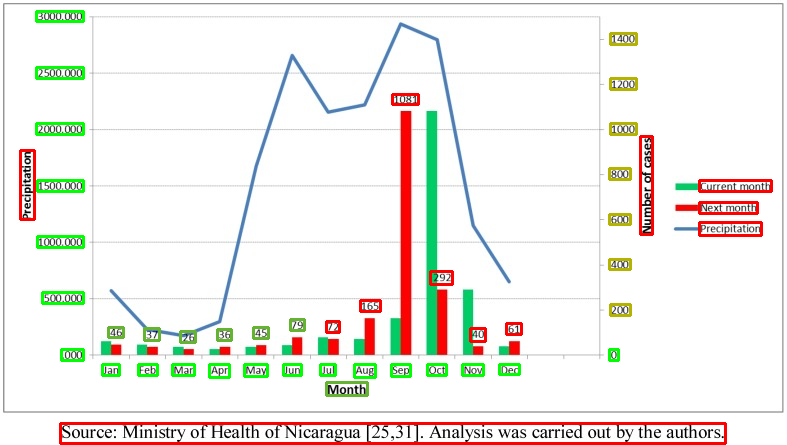

gdrive/MyDrive/csv_test/split_1/images/PMC4606412___CMMM2015-689035.008.jpg
F1 Score  1.0


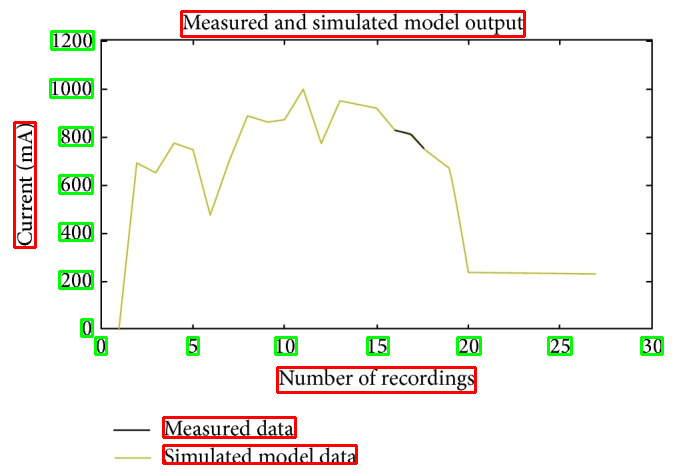

gdrive/MyDrive/csv_test/split_1/images/PMC4025013___ijerph-11-03765-g007.jpg
F1 Score  1.0


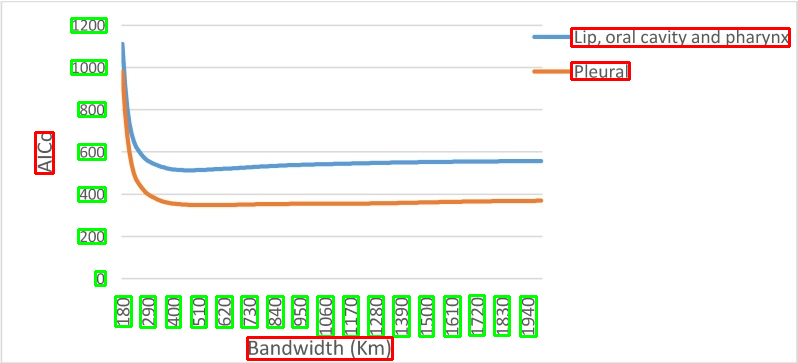

gdrive/MyDrive/csv_test/split_1/images/PMC4690940___ijerph-12-15004-g002.jpg
F1 Score  0.9523809523809523


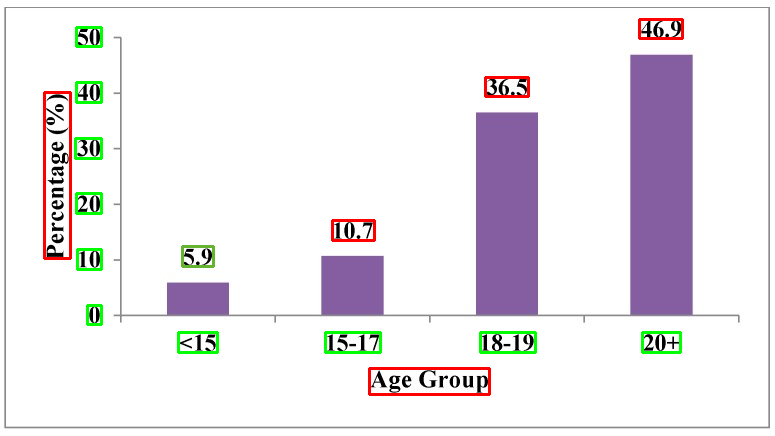

gdrive/MyDrive/csv_test/split_1/images/PMC5457075___materials-09-00748-g001.jpg
F1 Score  1.0


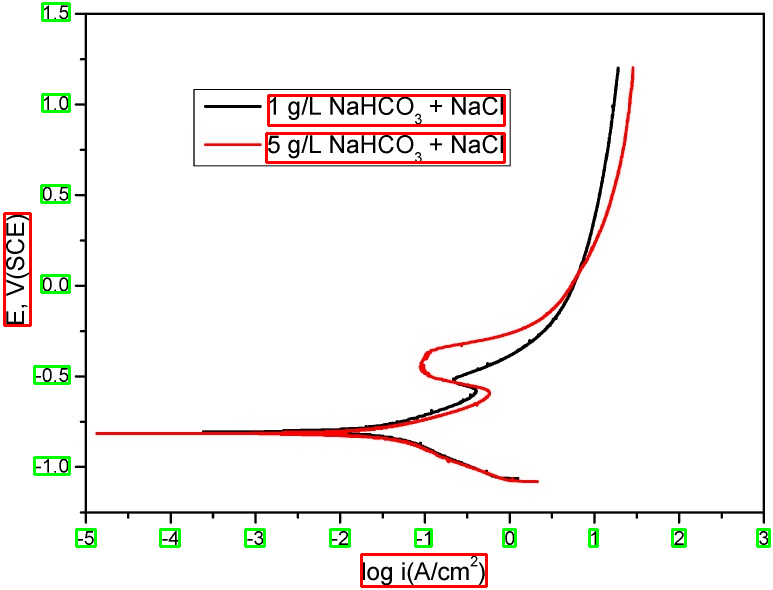

gdrive/MyDrive/csv_test/split_1/images/PMC1781489___pgen.0030010.g004.jpg
F1 Score  0.7222222222222222


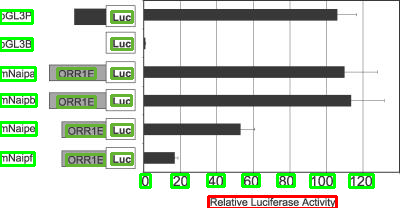

gdrive/MyDrive/csv_test/split_1/images/PMC4199046___ijerph-11-09723-g001.jpg
F1 Score  0.9714285714285714


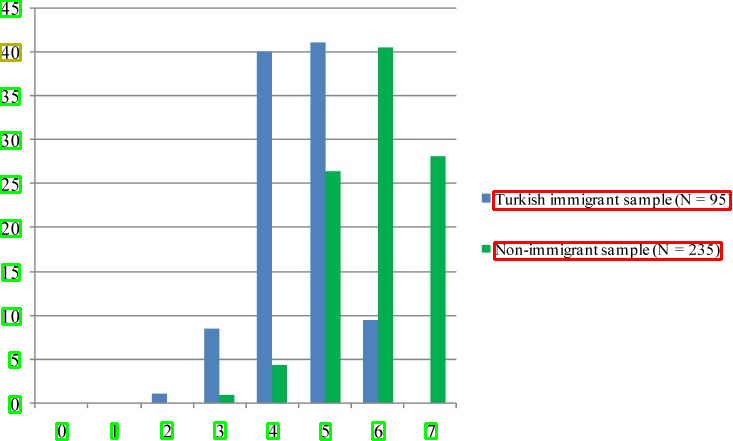

gdrive/MyDrive/csv_test/split_1/images/PMC5456769___materials-09-00489-g007.jpg
F1 Score  1.0


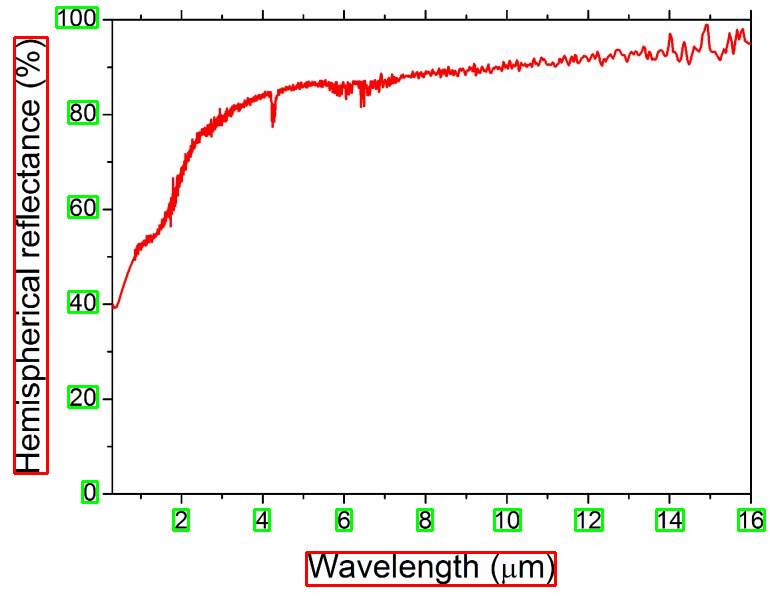

gdrive/MyDrive/csv_test/split_1/images/PMC3036932___gmb-32-2-328-gfig1.jpg
F1 Score  0.8837209302325582


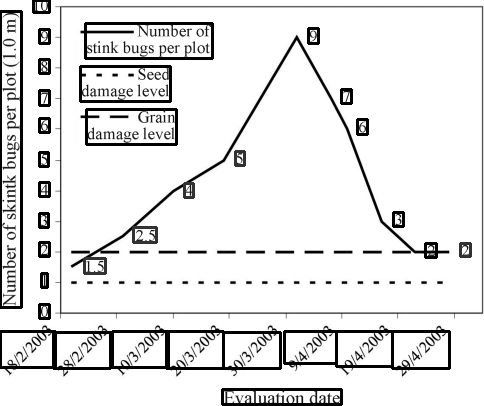

gdrive/MyDrive/csv_test/split_1/images/PMC5456128___materials-07-06367-g005.jpg
F1 Score  1.0


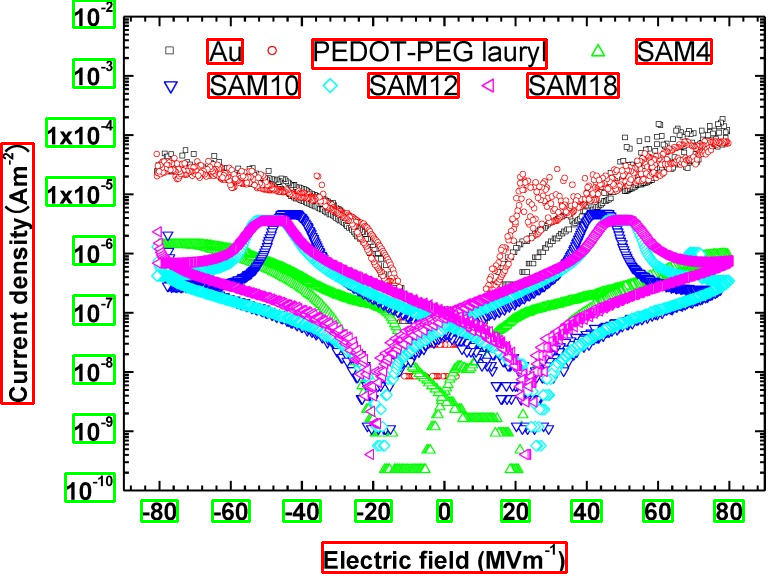

gdrive/MyDrive/csv_test/split_1/images/PMC4211006___ijerph-11-10790-g001.jpg
F1 Score  1.0


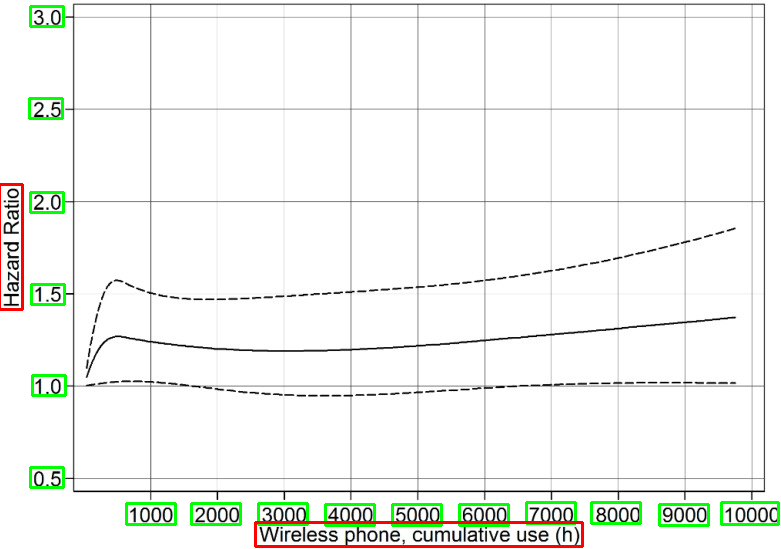

gdrive/MyDrive/csv_test/split_1/images/PMC5459073___materials-10-00515-g004.jpg
F1 Score  0.6923076923076923


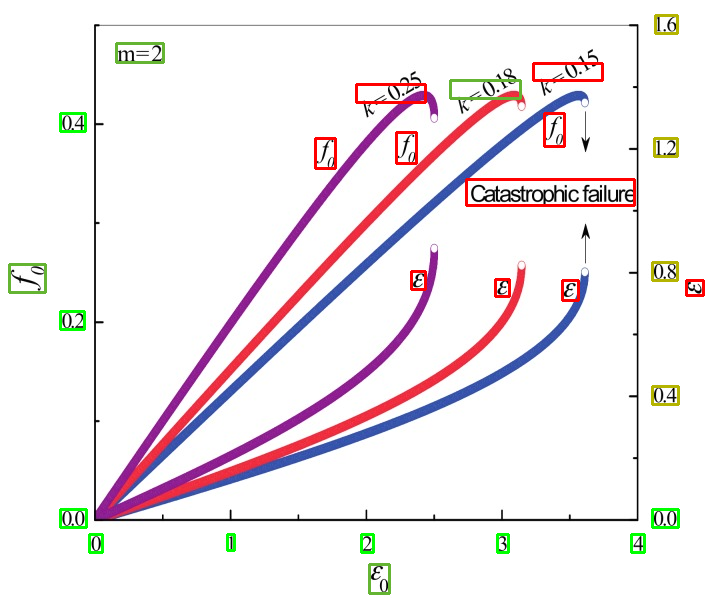

gdrive/MyDrive/csv_test/split_1/images/PMC4627027___ijerph-12-13224-g002.jpg
F1 Score  0.9767441860465117


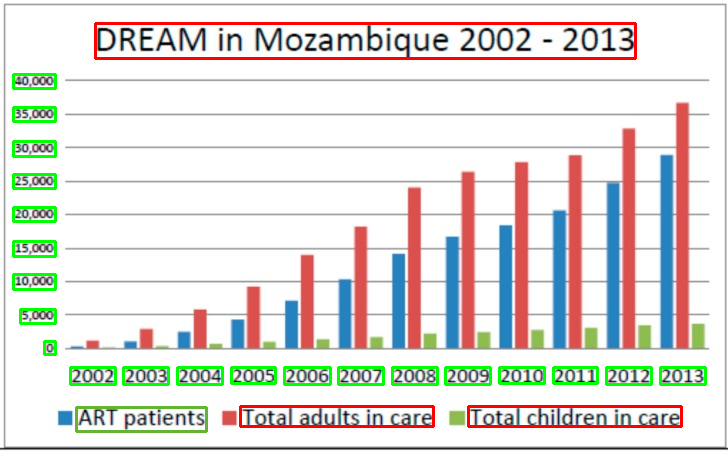

gdrive/MyDrive/csv_test/split_1/images/PMC3945204___pgen.1004226.g004_panel_1.jpg
F1 Score  0.9333333333333333


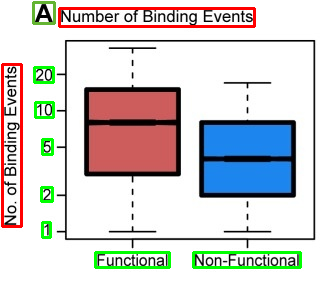

gdrive/MyDrive/csv_test/split_1/images/PMC5706272___materials-10-01325-g0A9.jpg
F1 Score  1.0


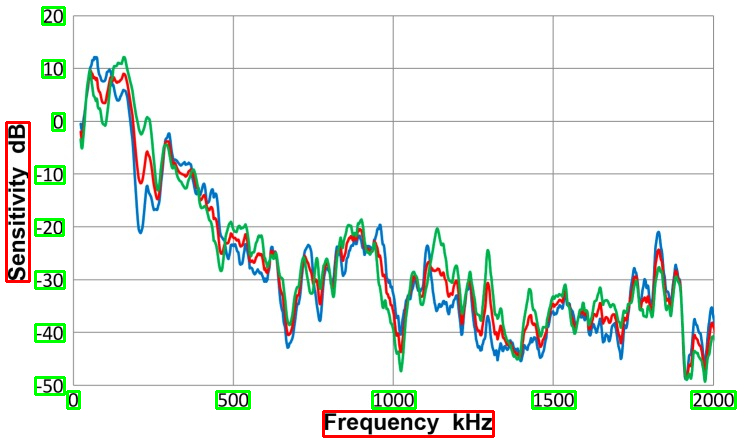

gdrive/MyDrive/csv_test/split_1/images/PMC5458852___materials-08-05455-g004.jpg
F1 Score  0.8571428571428571


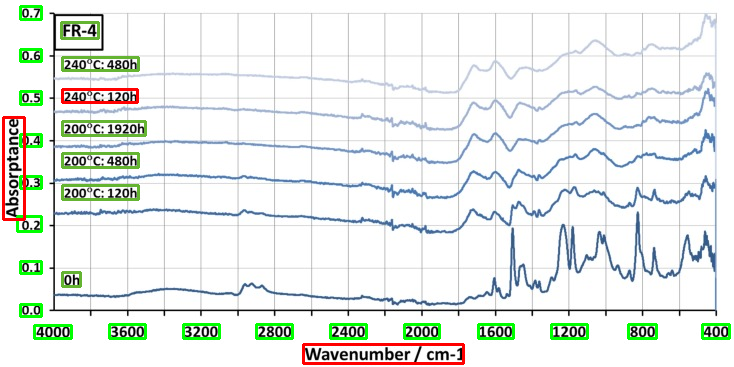

gdrive/MyDrive/csv_test/split_1/images/PMC4807060___CMMM2016-1737953.007.jpg
F1 Score  1.0


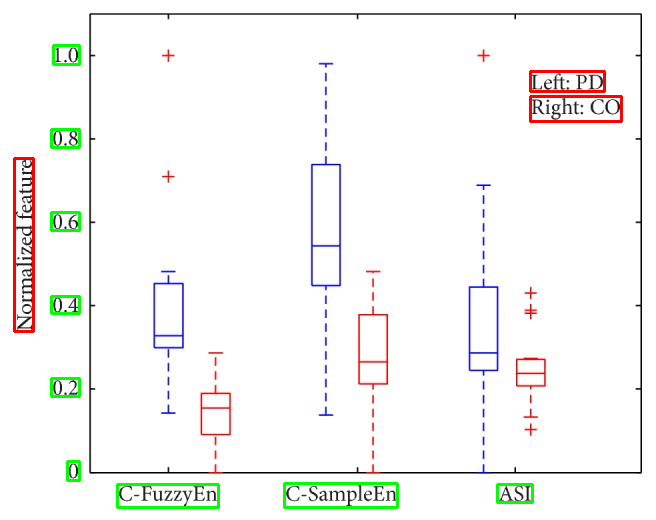

gdrive/MyDrive/csv_test/split_1/images/PMC4022487___pgen.1004362.g002.jpg
F1 Score  0.9523809523809523


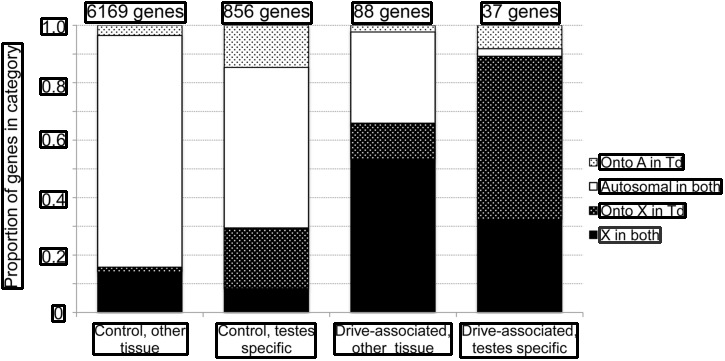

gdrive/MyDrive/csv_test/split_1/images/PMC3197687___pgen.1002336.g002.jpg
F1 Score  0.7647058823529412


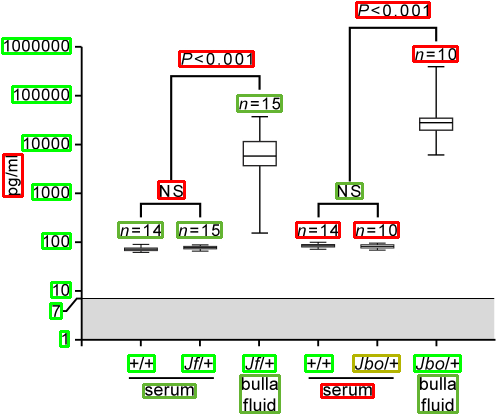

gdrive/MyDrive/csv_test/split_1/images/PMC5457009___materials-09-00999-g001.jpg
F1 Score  1.0


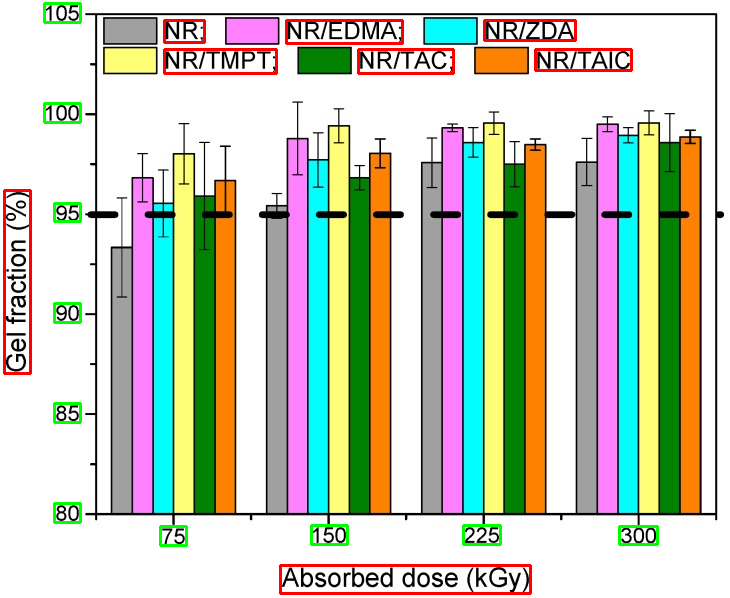

gdrive/MyDrive/csv_test/split_1/images/PMC3266616___fgene-02-00102-a001.jpg
F1 Score  0.8695652173913043


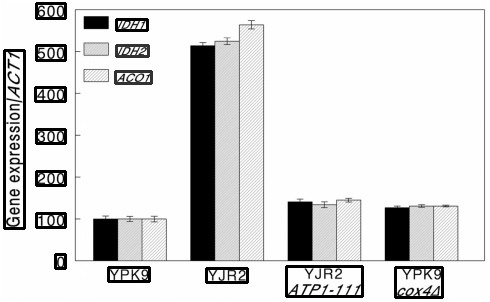

gdrive/MyDrive/csv_test/split_1/images/PMC5456945___materials-09-00528-g005.jpg
F1 Score  1.0


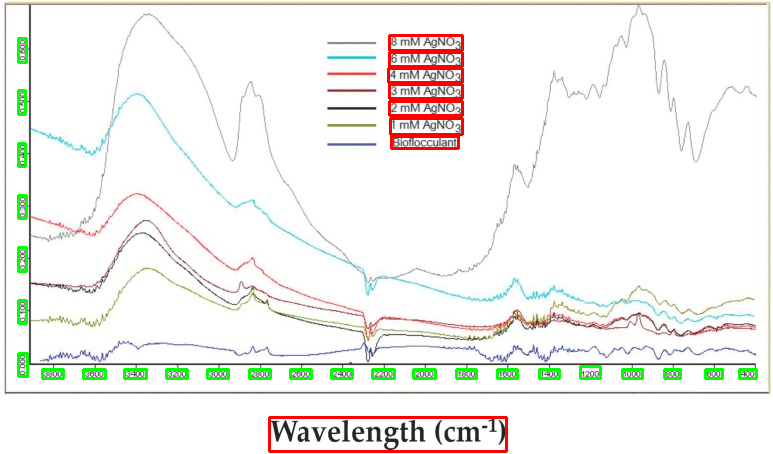

gdrive/MyDrive/csv_test/split_1/images/PMC5456429___materials-07-08105-g007.jpg
F1 Score  1.0


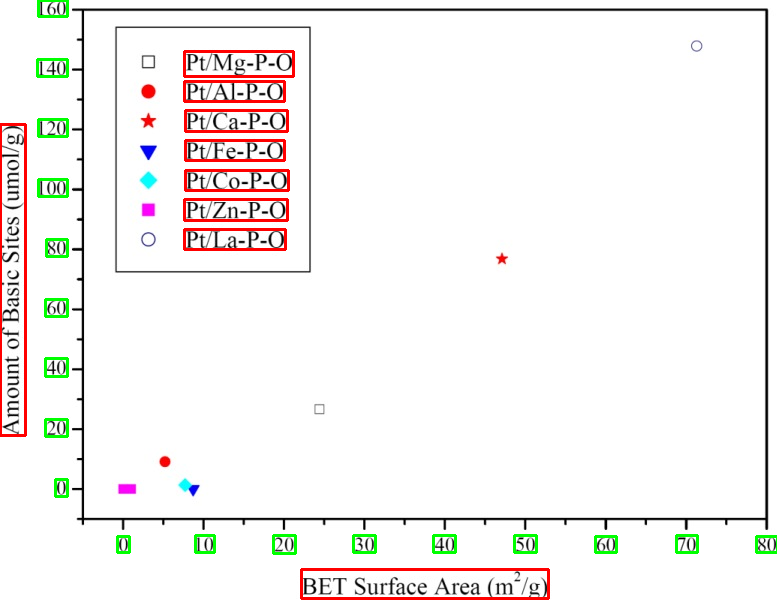

gdrive/MyDrive/csv_test/split_1/images/PMC5707585___nanomaterials-07-00368-g006.jpg
F1 Score  1.0


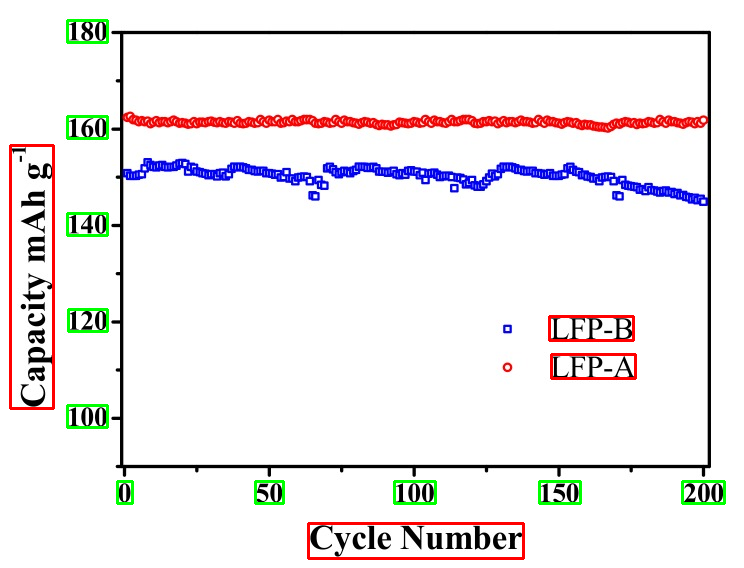

gdrive/MyDrive/csv_test/split_1/images/PMC2383879___1471-2350-9-33-1.jpg
F1 Score  0.8750000000000001


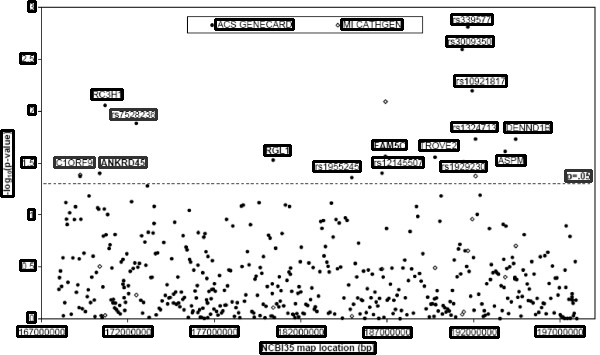

gdrive/MyDrive/csv_test/split_1/images/PMC5509092___materials-09-00642-g003.jpg
F1 Score  0.9444444444444444


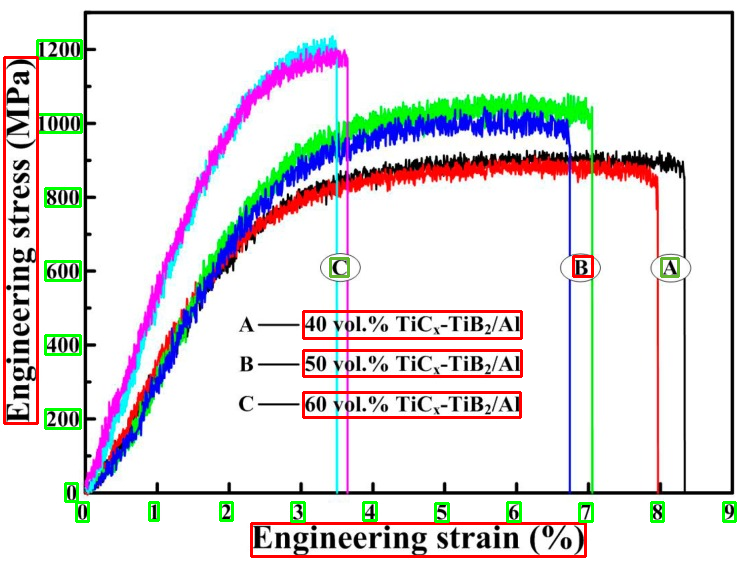

gdrive/MyDrive/csv_test/split_1/images/PMC4323073___12889_2015_1453_Fig3_HTML.jpg
F1 Score  1.0


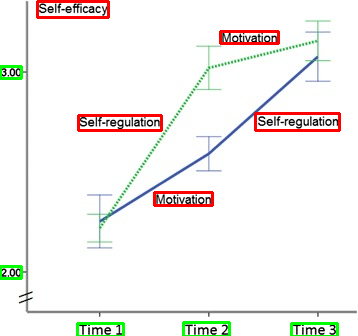

gdrive/MyDrive/csv_test/split_1/images/PMC5706274___materials-10-01327-g003.jpg
F1 Score  0.8


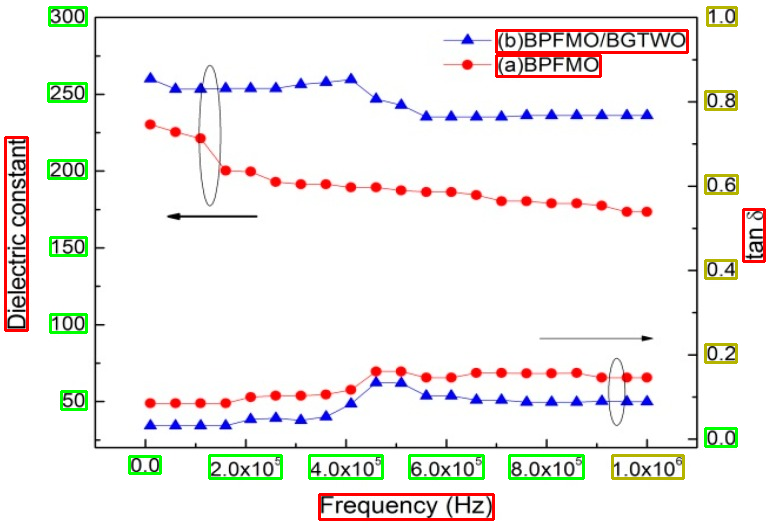

gdrive/MyDrive/csv_test/split_1/images/PMC4483707___ijerph-12-06378-g001.jpg
F1 Score  0.3


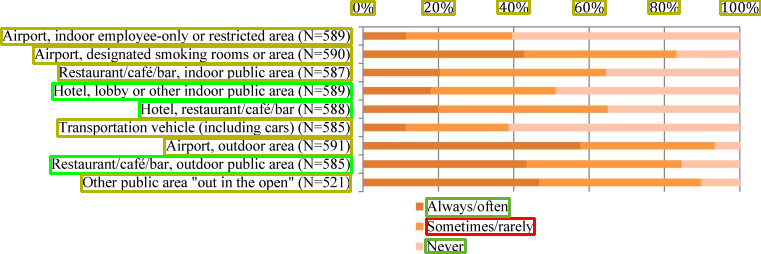

gdrive/MyDrive/csv_test/split_1/images/PMC3898232___1471-2156-15-7-1.jpg
F1 Score  0.7999999999999999


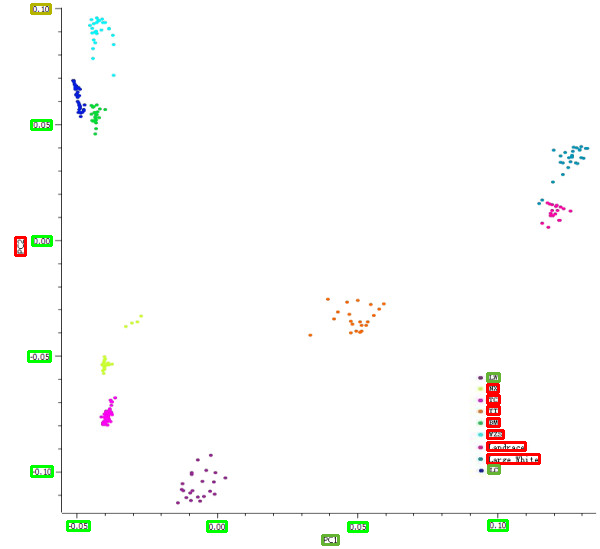

gdrive/MyDrive/csv_test/split_1/images/PMC5707936___ijerph-14-01297-g001.jpg
F1 Score  1.0


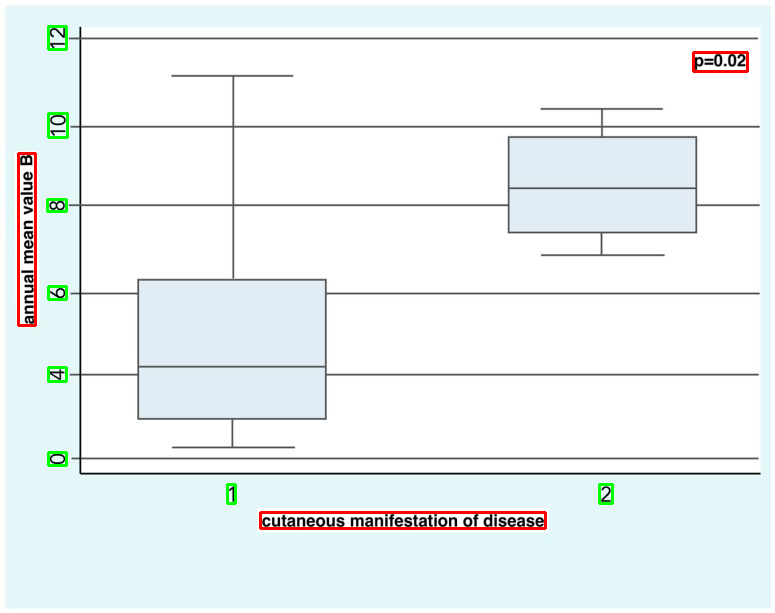

gdrive/MyDrive/csv_test/split_1/images/PMC4808957___ijerph-13-00294-g001.jpg
F1 Score  0.9166666666666666


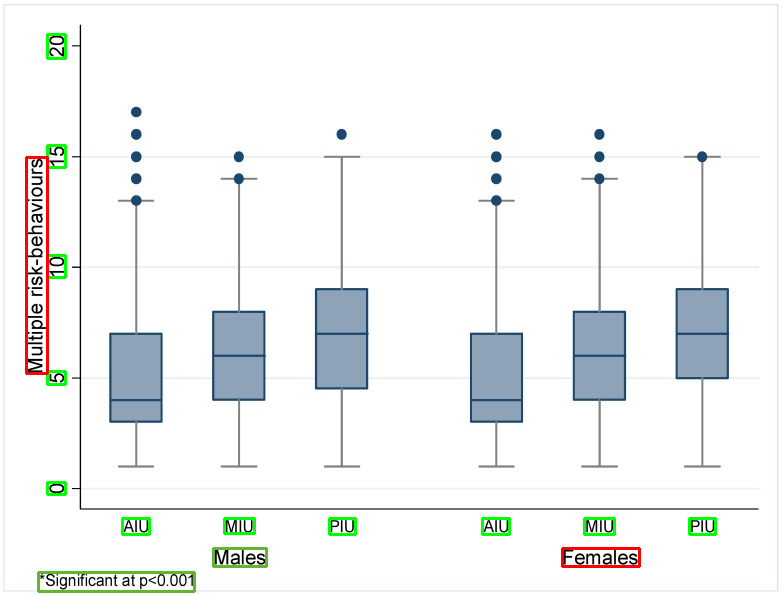

gdrive/MyDrive/csv_test/split_1/images/PMC5224598___nanomaterials-06-00126-g004.jpg
F1 Score  0.75


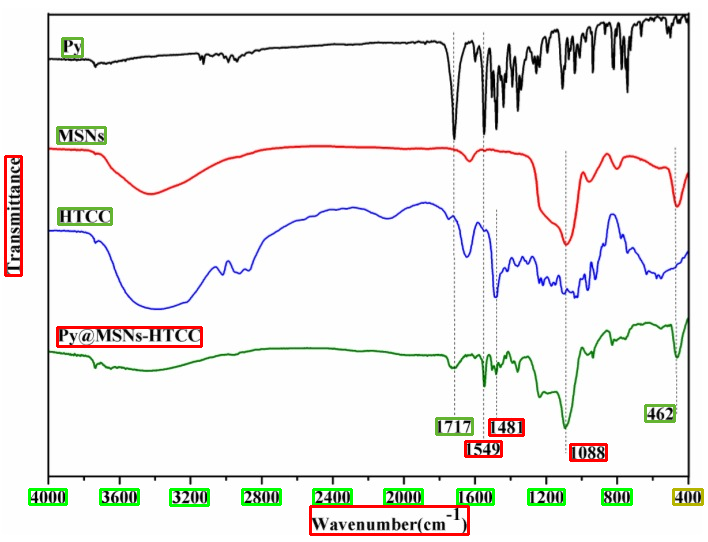

gdrive/MyDrive/csv_test/split_1/images/PMC5558078___IJPH-46-835-g001.jpg
F1 Score  0.962962962962963


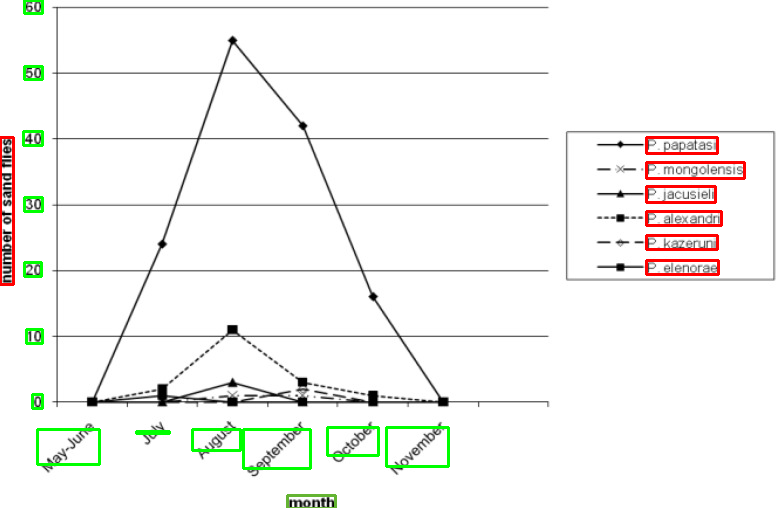

gdrive/MyDrive/csv_test/split_1/images/PMC4408725___fpubh-03-00059-g002.jpg
F1 Score  1.0


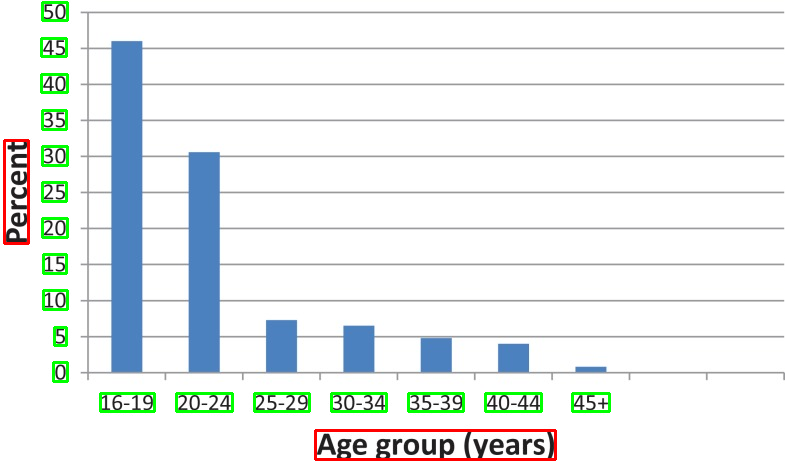

gdrive/MyDrive/csv_test/split_1/images/PMC2674437___1471-2458-9-104-5.jpg
F1 Score  1.0


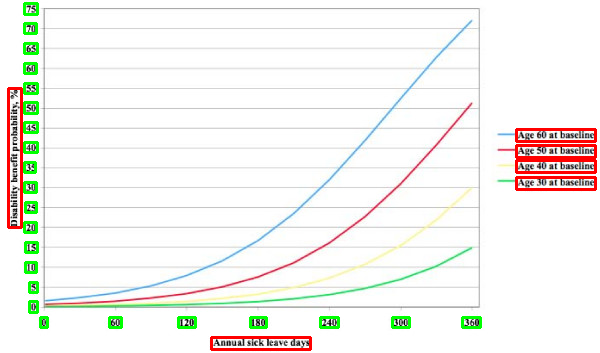

gdrive/MyDrive/csv_test/split_1/images/PMC4517993___je-25-544-g001.jpg
F1 Score  1.0


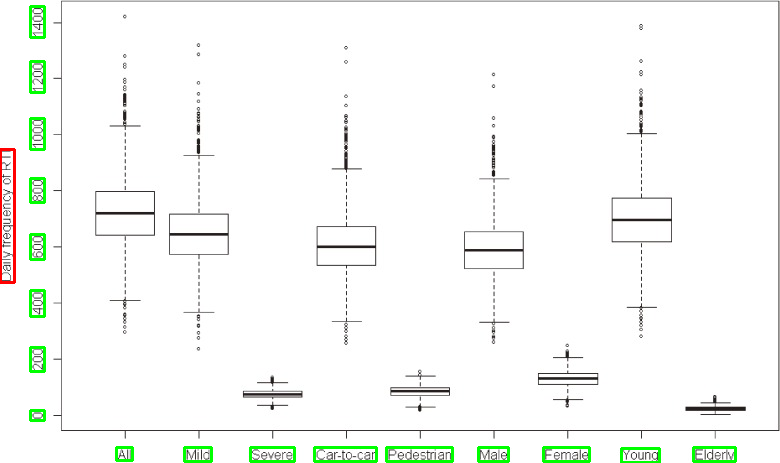

gdrive/MyDrive/csv_test/split_1/images/PMC2315653___1471-2156-9-24-7.jpg
F1 Score  1.0


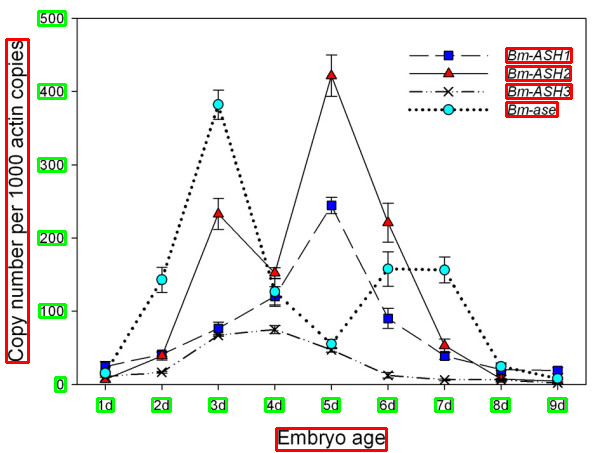

gdrive/MyDrive/csv_test/split_1/images/PMC5459077___materials-10-00509-g002.jpg
F1 Score  0.9523809523809523


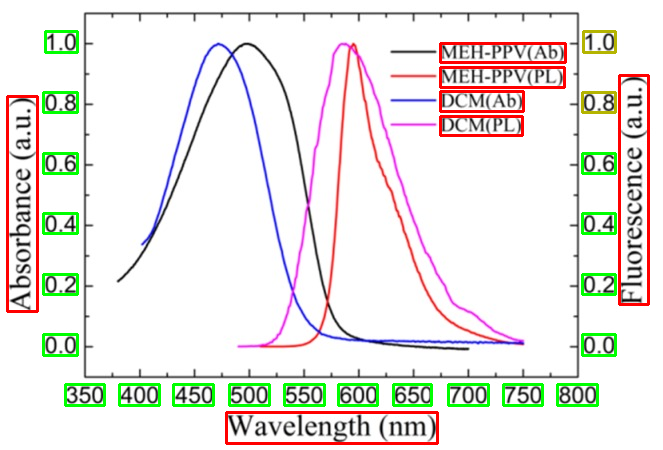

gdrive/MyDrive/csv_test/split_1/images/PMC5446718___12863_2017_518_Fig3_HTML.jpg
F1 Score  0.955223880597015


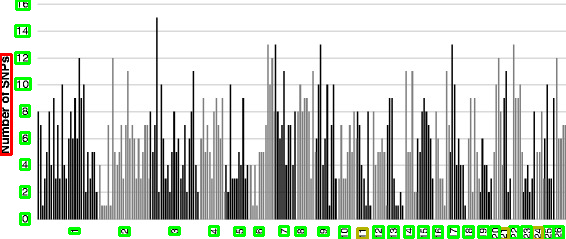

gdrive/MyDrive/csv_test/split_1/images/PMC5455278___materials-08-00700-g004.jpg
F1 Score  0.7692307692307693


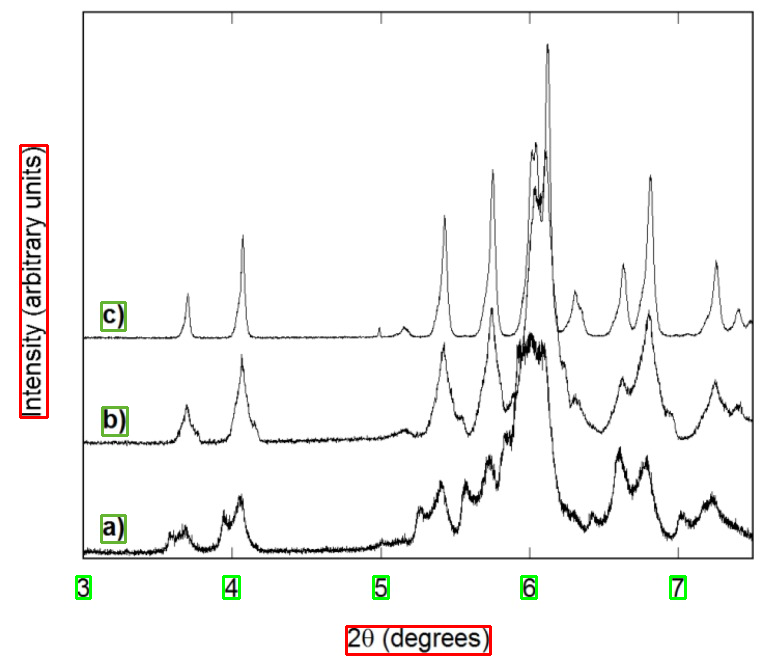

gdrive/MyDrive/csv_test/split_1/images/PMC5408167___nanomaterials-07-00075-g003.jpg
F1 Score  1.0


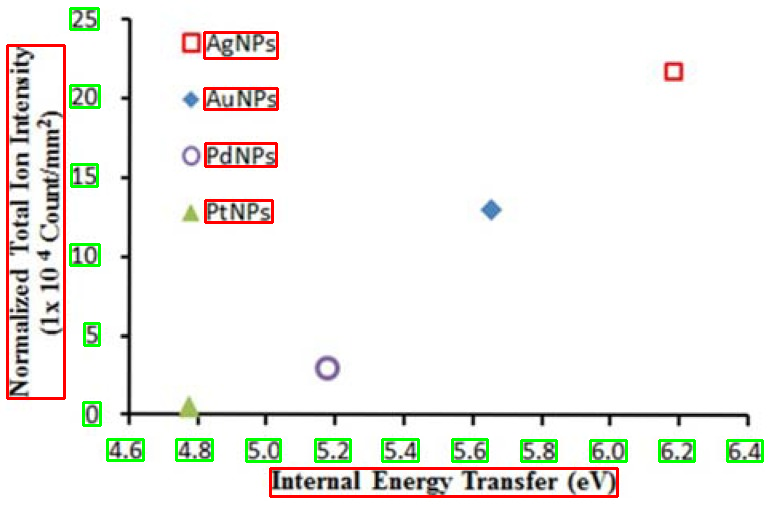

gdrive/MyDrive/csv_test/split_1/images/PMC3481635___ijph-39-032f2.jpg
F1 Score  1.0


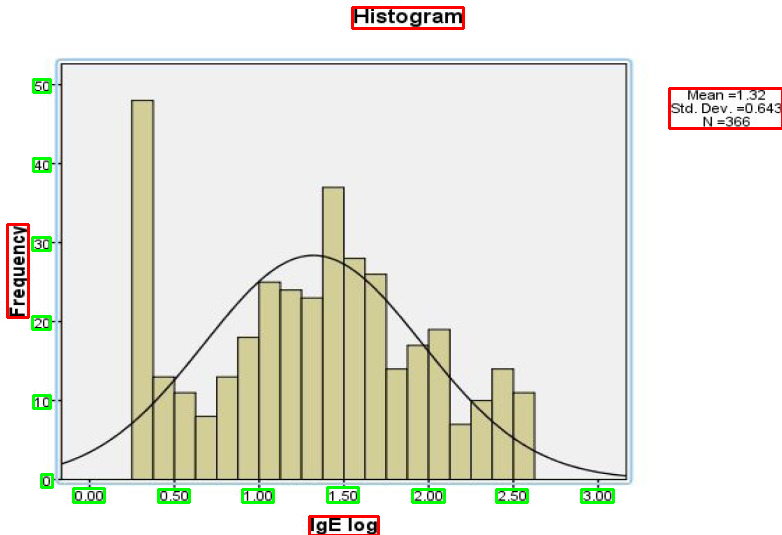

gdrive/MyDrive/csv_test/split_1/images/PMC5664755___ijerph-14-01254-g004b.jpg
F1 Score  0.896551724137931


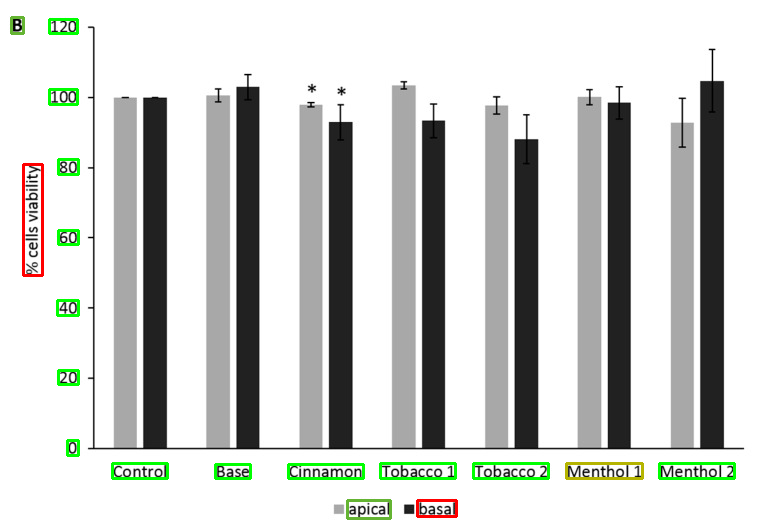

gdrive/MyDrive/csv_test/split_1/images/PMC3079646___1471-2458-11-213-1.jpg
F1 Score  1.0


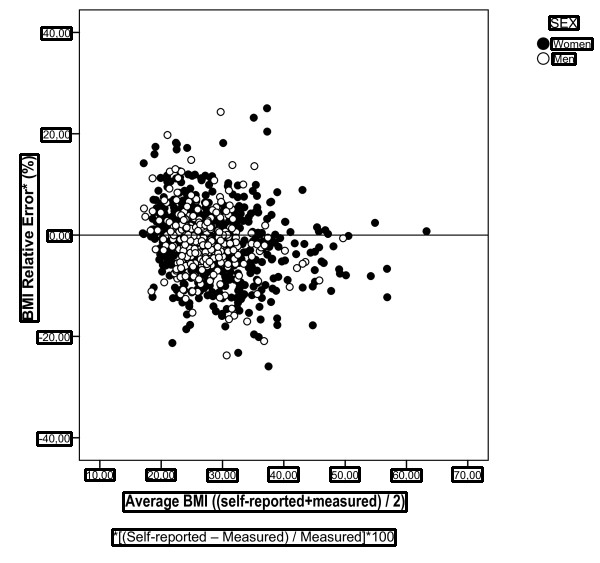

gdrive/MyDrive/csv_test/split_1/images/PMC4430875___12889_2015_1769_Fig3_HTML.jpg
F1 Score  1.0


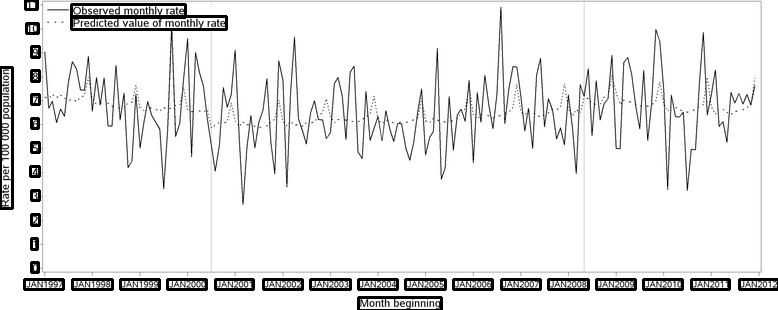

gdrive/MyDrive/csv_test/split_1/images/PMC2996224___ijerph-07-04050f6.jpg
F1 Score  0.8


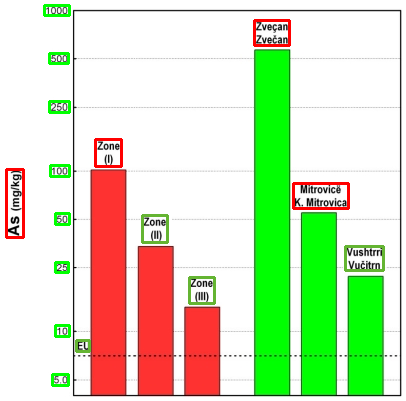

gdrive/MyDrive/csv_test/split_1/images/PMC5578260___materials-10-00894-g003.jpg
F1 Score  0.8333333333333333


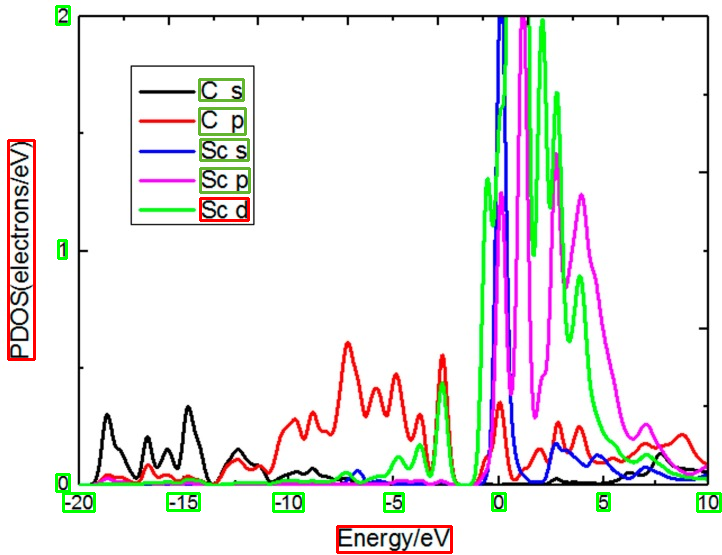

gdrive/MyDrive/csv_test/split_1/images/PMC5456678___materials-09-00126-g004a.jpg
F1 Score  0.9714285714285714


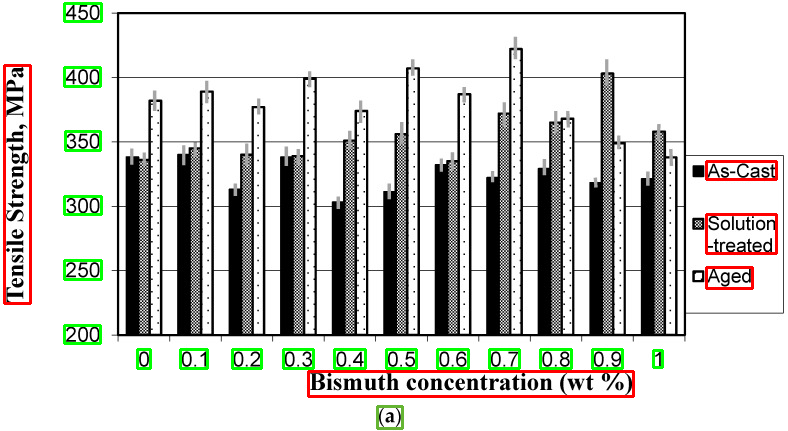

gdrive/MyDrive/csv_test/split_1/images/PMC3225825___1297-9686-41-17-3.jpg
F1 Score  1.0


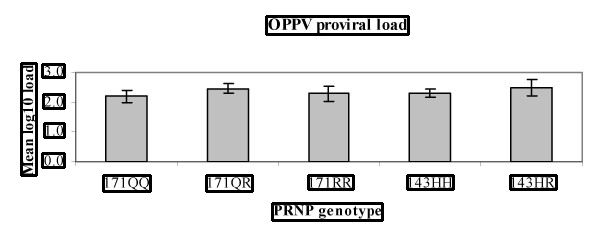

gdrive/MyDrive/csv_test/split_1/images/PMC2936423___1471-2458-10-502-2.jpg
F1 Score  0.9142857142857143


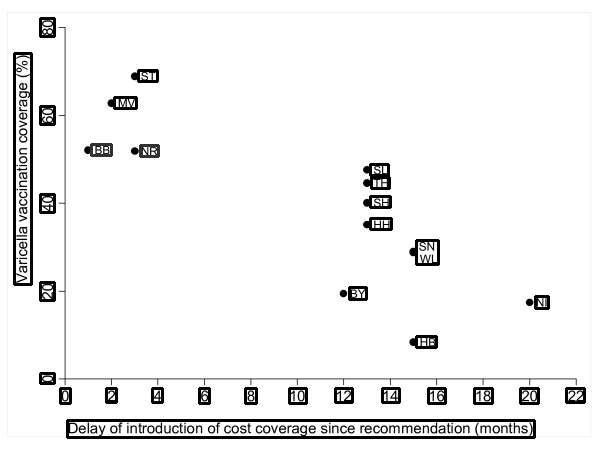

gdrive/MyDrive/csv_test/split_1/images/PMC3863853___ijerph-10-05433-g004.jpg
F1 Score  0.7272727272727272


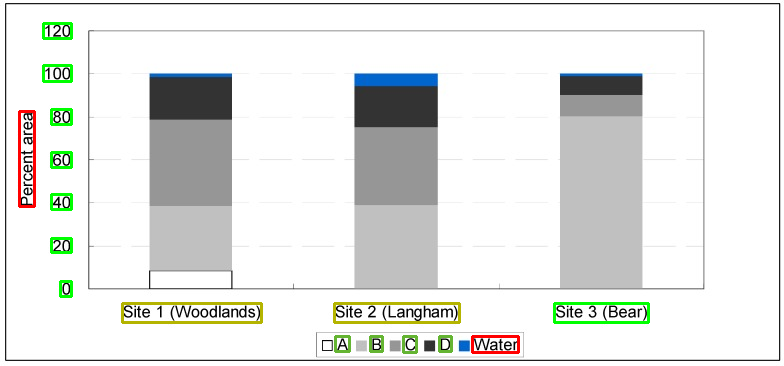

gdrive/MyDrive/csv_test/split_1/images/PMC5453152___materials-07-00206f4.jpg
F1 Score  1.0


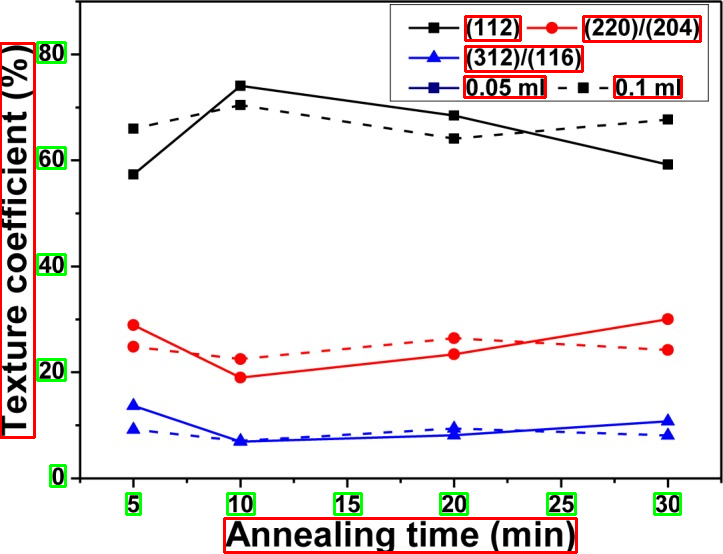

gdrive/MyDrive/csv_test/split_1/images/PMC1201149___1471-2458-5-83-5.jpg
F1 Score  0.8666666666666666


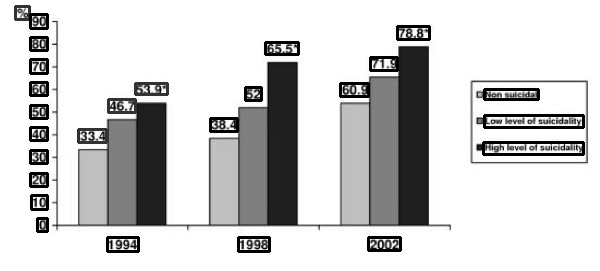

gdrive/MyDrive/csv_test/split_1/images/PMC5485773___nanomaterials-07-00126-g008.jpg
F1 Score  1.0


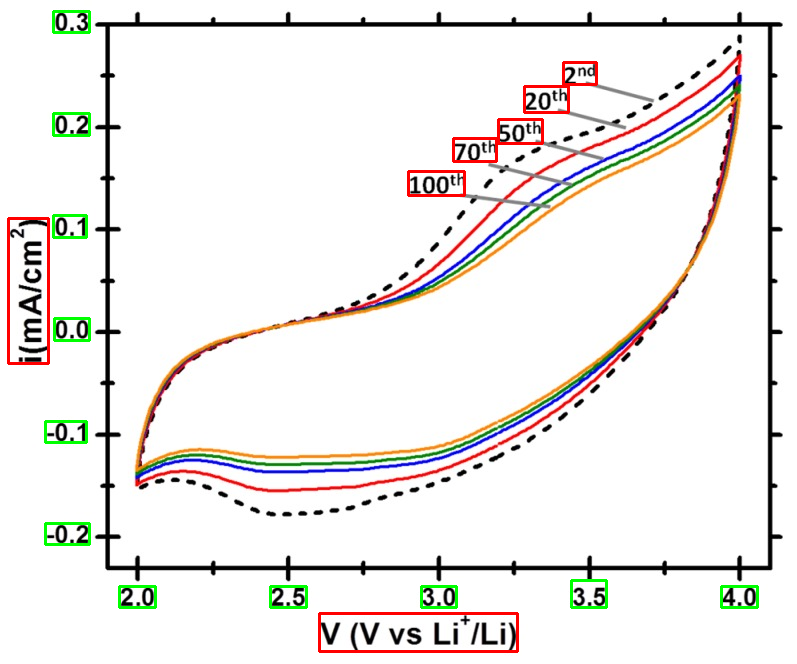

gdrive/MyDrive/csv_test/split_1/images/PMC3650001___pgen.1003510.g001.jpg
F1 Score  0.8695652173913044


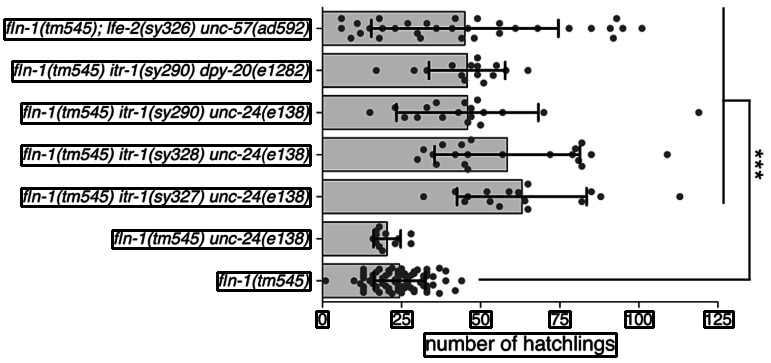

gdrive/MyDrive/csv_test/split_1/images/PMC3699396___1297-9686-45-20-4.jpg
F1 Score  1.0


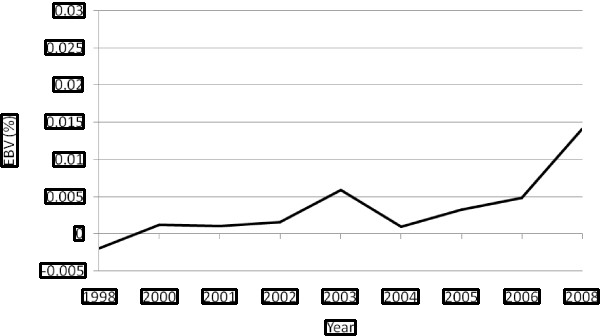

gdrive/MyDrive/csv_test/split_1/images/PMC1543636___1471-2458-6-170-1.jpg
F1 Score  1.0


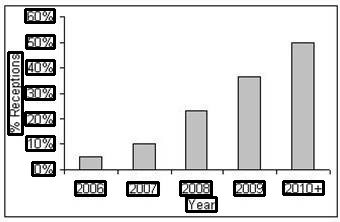

gdrive/MyDrive/csv_test/split_1/images/PMC5455930___materials-07-04524-g010.jpg
F1 Score  1.0


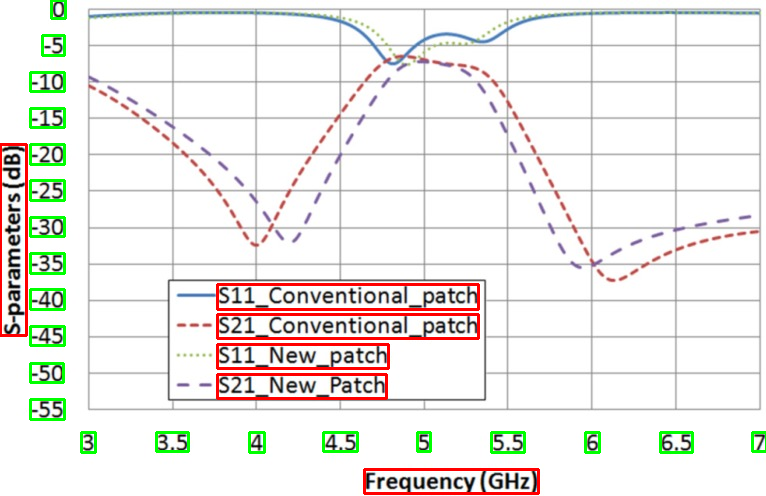

gdrive/MyDrive/csv_test/split_1/images/PMC3009667___pgen.1001189.g003.jpg
F1 Score  1.0


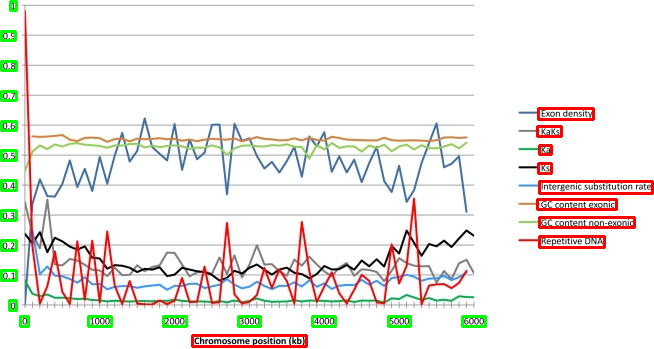

gdrive/MyDrive/csv_test/split_1/images/PMC4489108___12711_2015_136_Fig4_HTML_panel_4.jpg
F1 Score  1.0


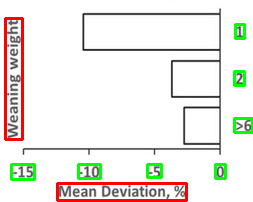

gdrive/MyDrive/csv_test/split_1/images/PMC4255830___1471-2156-15-S2-S8-1.jpg
F1 Score  0.967741935483871


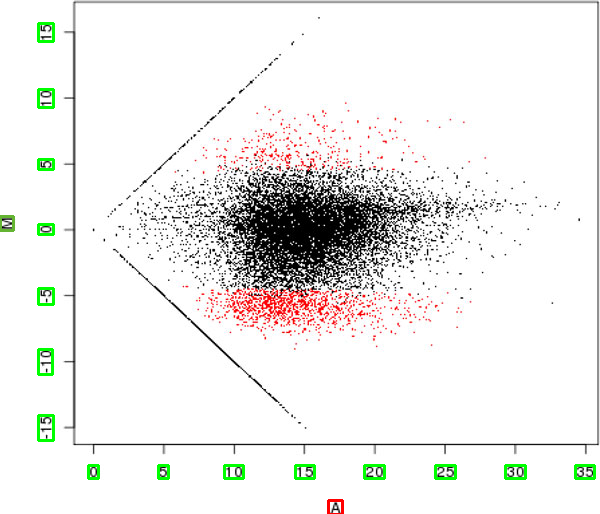

gdrive/MyDrive/csv_test/split_1/images/PMC3699381___1471-2350-14-62-4.jpg
F1 Score  1.0


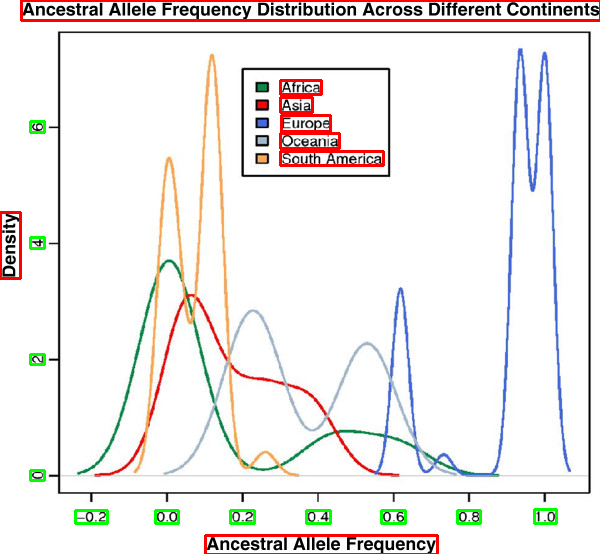

gdrive/MyDrive/csv_test/split_1/images/PMC5551760___materials-10-00717-g009.jpg
F1 Score  1.0


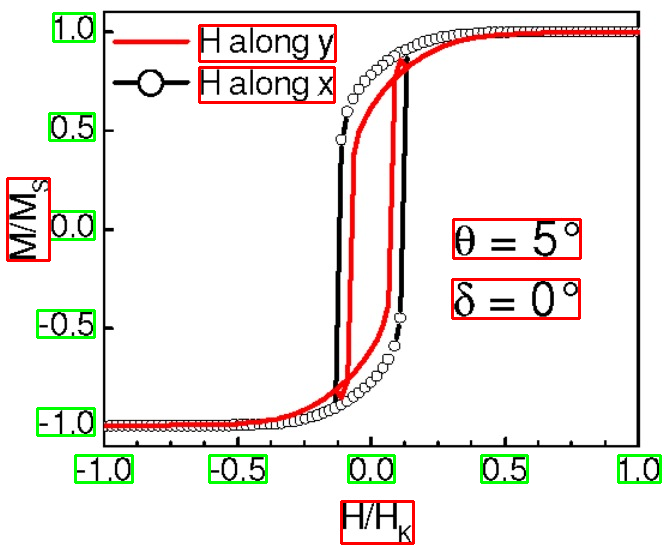

gdrive/MyDrive/csv_test/split_1/images/PMC3984636___1471-2458-14-284-1.jpg
F1 Score  0.9230769230769231


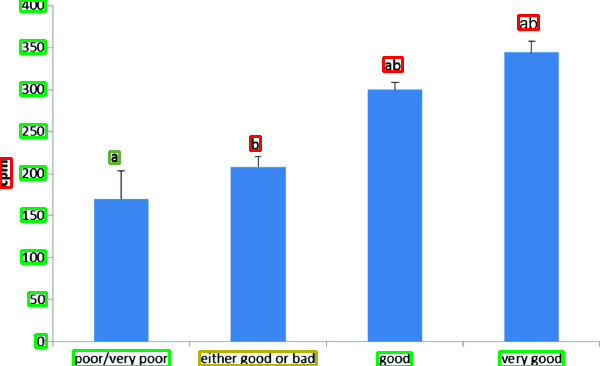

gdrive/MyDrive/csv_test/split_1/images/PMC5456438___materials-07-07799-g002.jpg
F1 Score  0.888888888888889


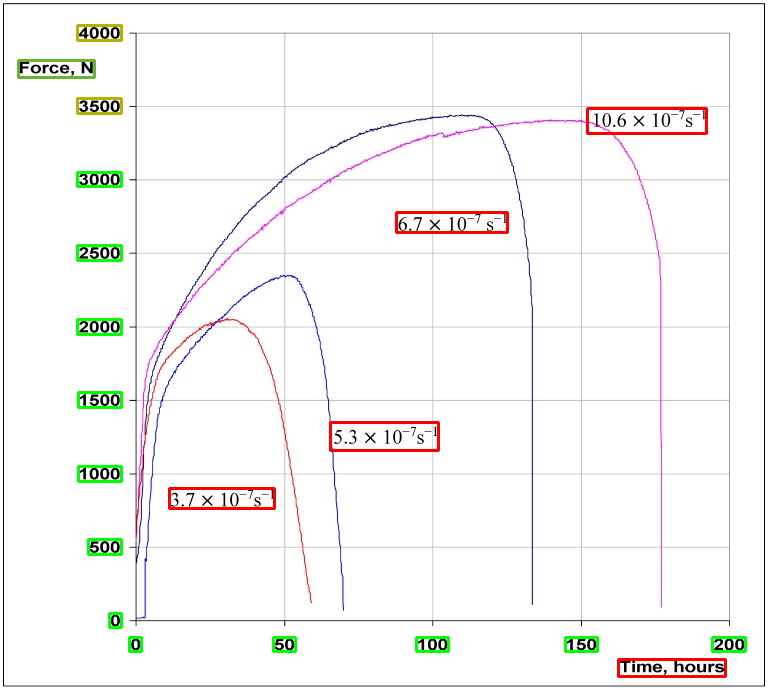

gdrive/MyDrive/csv_test/split_1/images/PMC4292220___fpubh-02-00289-g003.jpg
F1 Score  1.0


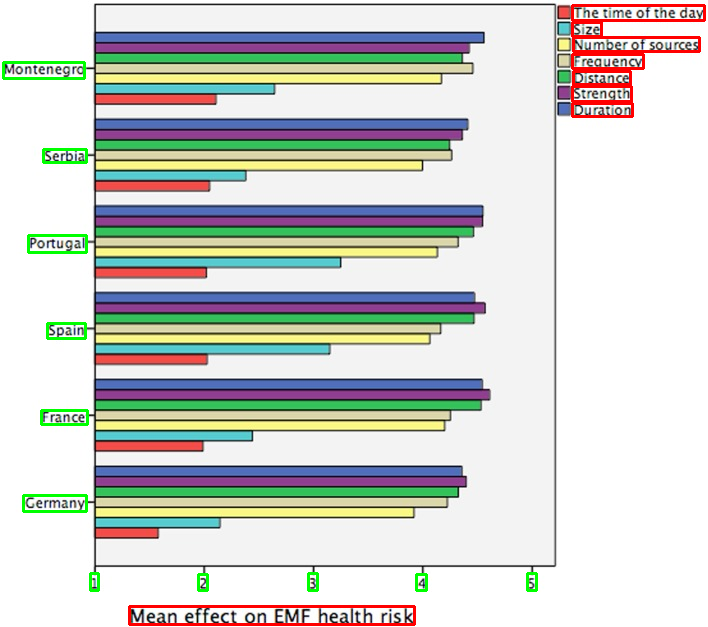

gdrive/MyDrive/csv_test/split_1/images/PMC2672390___ijerph-06-01235f2.jpg
F1 Score  1.0


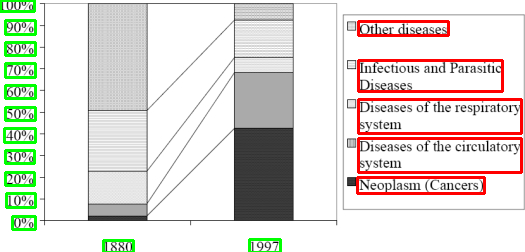

gdrive/MyDrive/csv_test/split_1/images/PMC5468780___CMMM2017-5924270.011.jpg
F1 Score  0.8333333333333334


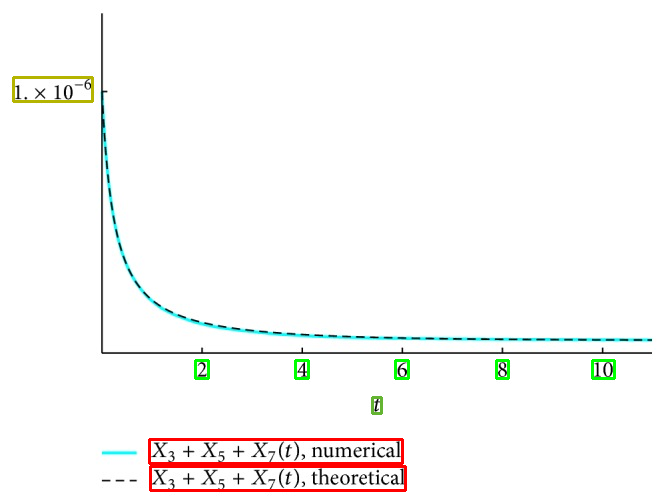

gdrive/MyDrive/csv_test/split_1/images/PMC3265086___fgene-02-00103-a001.jpg
F1 Score  1.0


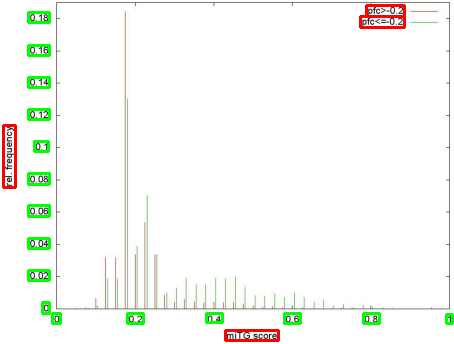

gdrive/MyDrive/csv_test/split_1/images/PMC4246467___12889_2014_7268_Fig1_HTML.jpg
F1 Score  1.0


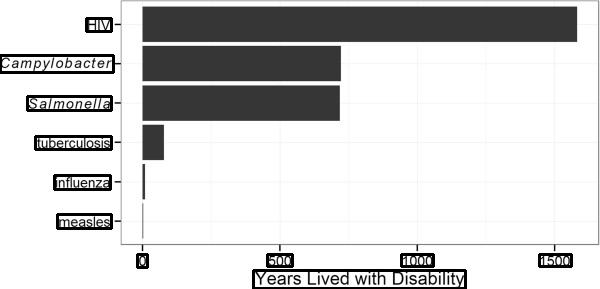

gdrive/MyDrive/csv_test/split_1/images/PMC3036040___gmb-32-3-645-gfig1.jpg
F1 Score  1.0


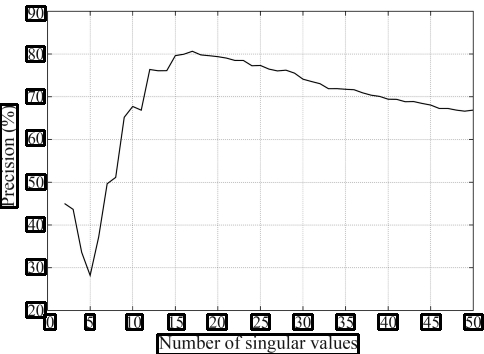

gdrive/MyDrive/csv_test/split_1/images/PMC5445885___materials-03-01509-g001.jpg
F1 Score  1.0


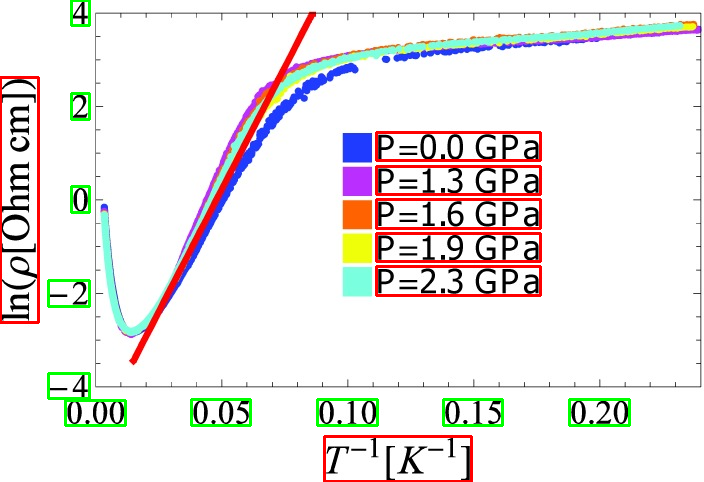

gdrive/MyDrive/csv_test/split_1/images/PMC5448931___materials-05-01373-g011.jpg
F1 Score  1.0


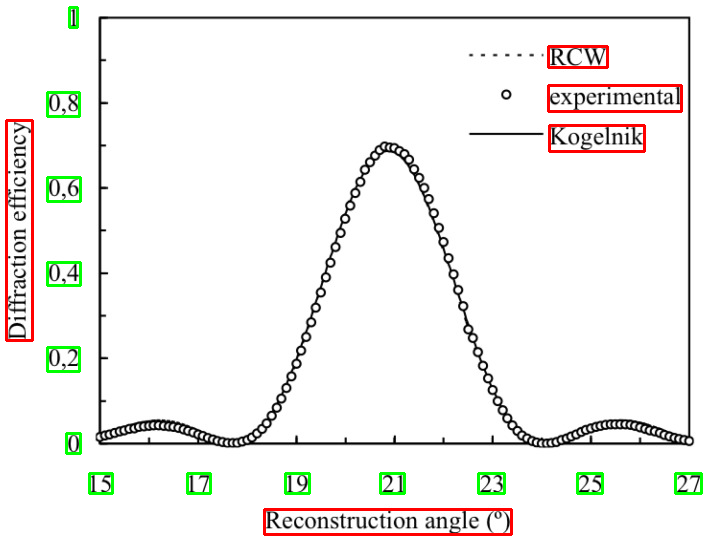

gdrive/MyDrive/csv_test/split_1/images/PMC5312859___nanomaterials-05-00218-g007.jpg
F1 Score  1.0


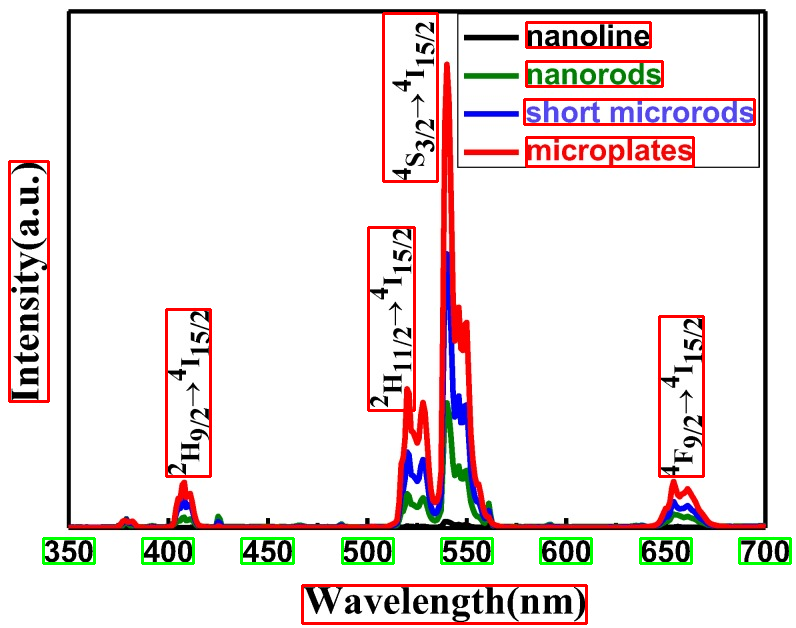

gdrive/MyDrive/csv_test/split_1/images/PMC2689933___pgen.1000523.g002.jpg
F1 Score  0.923076923076923


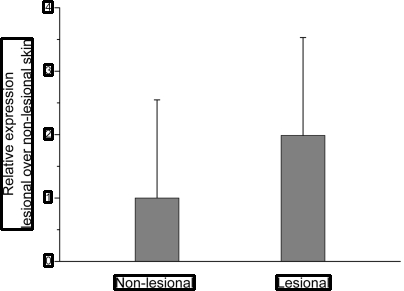

gdrive/MyDrive/csv_test/split_1/images/PMC5615697___materials-10-01042-g004.jpg
F1 Score  0.9696969696969697


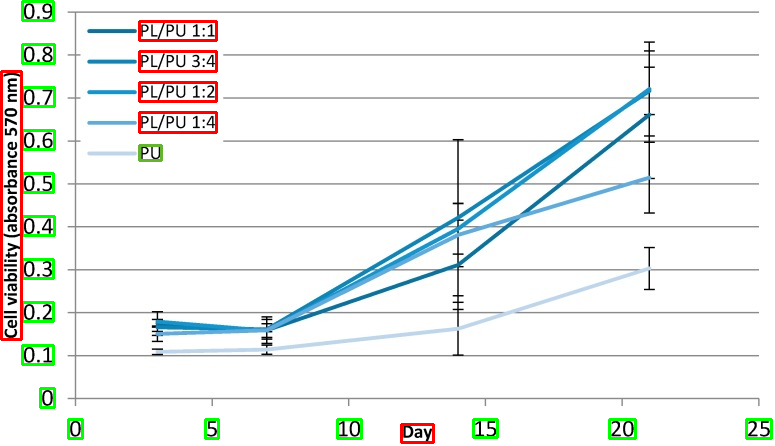

gdrive/MyDrive/csv_test/split_1/images/PMC3527307___pgen.1003090.g008.jpg
F1 Score  1.0


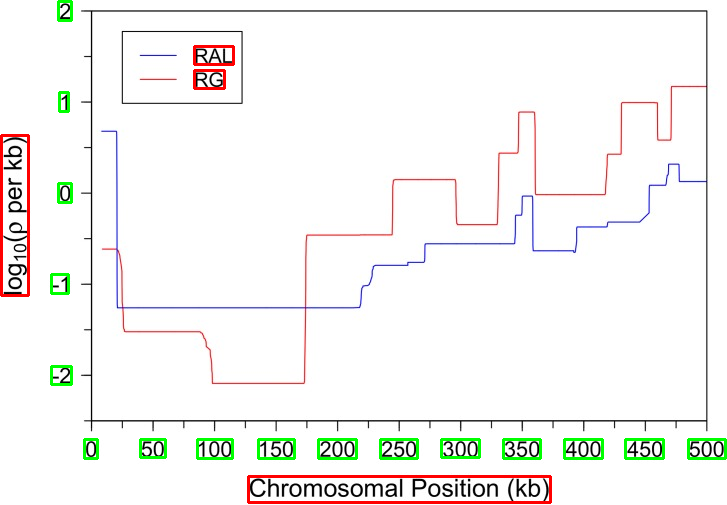

gdrive/MyDrive/csv_test/split_1/images/PMC4144343___fgene-05-00280-g0002_panel_2.jpg
F1 Score  1.0


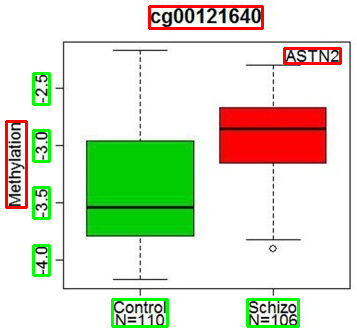

gdrive/MyDrive/csv_test/split_1/images/PMC3640778___ijph-41-26f1.jpg
F1 Score  1.0


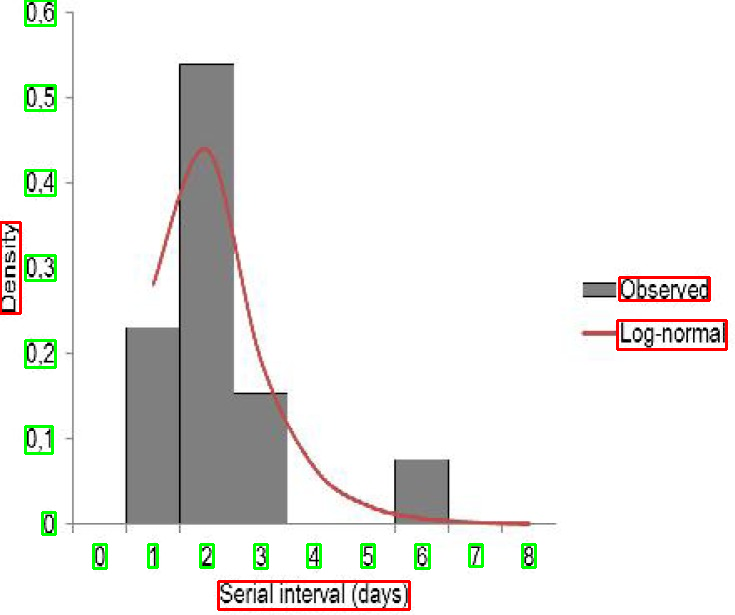

gdrive/MyDrive/csv_test/split_1/images/PMC5452747___materials-06-05893-g004.jpg
F1 Score  0.9333333333333333


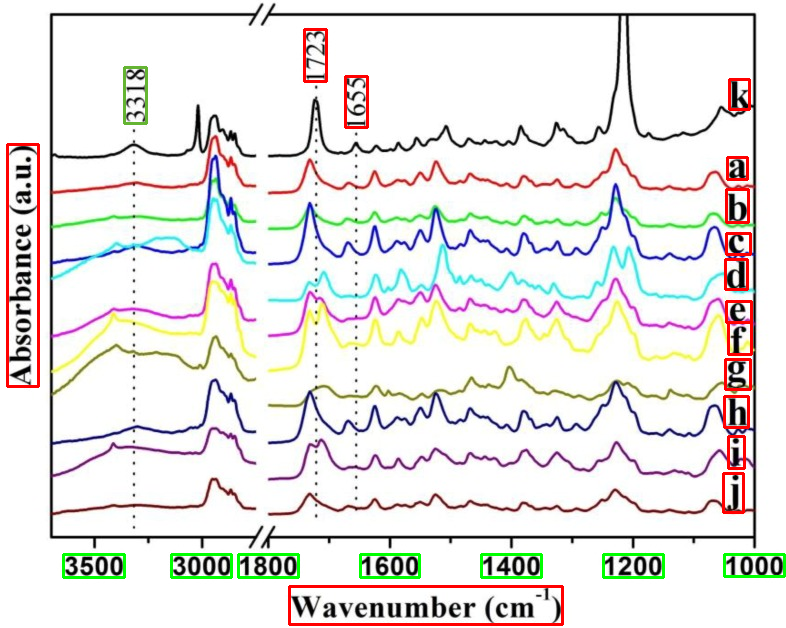

gdrive/MyDrive/csv_test/split_1/images/PMC3516540___pgen.1003120.g002.jpg
F1 Score  0.8666666666666666


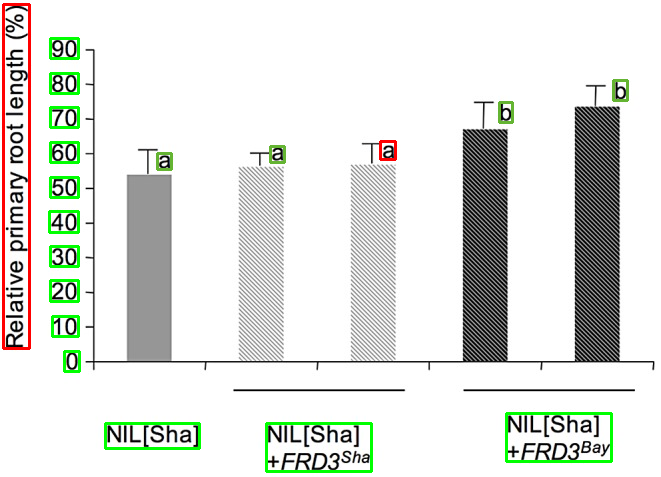

gdrive/MyDrive/csv_test/split_1/images/PMC4988780___pgen.1006011.g001.jpg
F1 Score  1.0


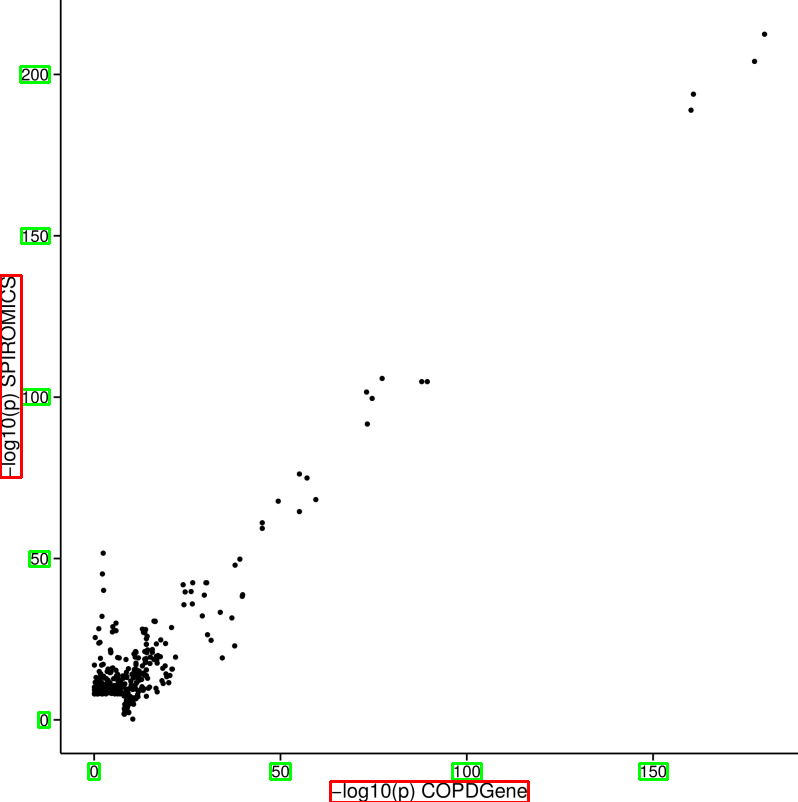

gdrive/MyDrive/csv_test/split_1/images/PMC3774443___ijerph-10-03363-g004.jpg
F1 Score  1.0


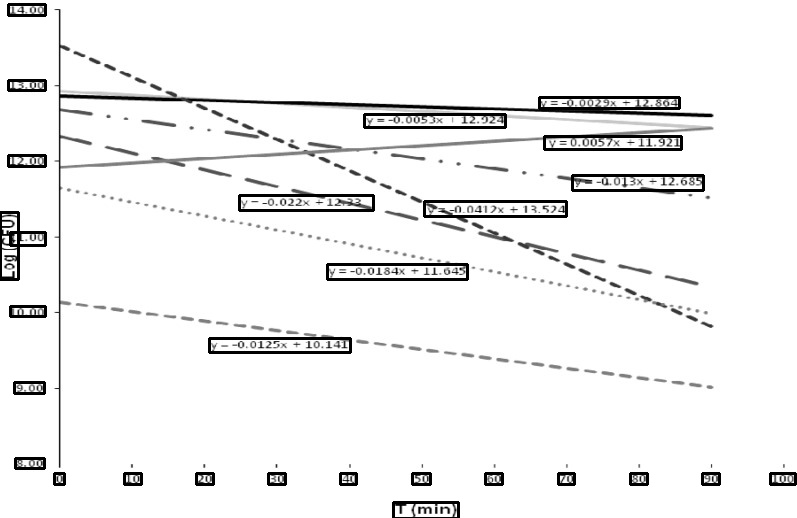

gdrive/MyDrive/csv_test/split_1/images/PMC3774431___ijerph-10-03172-g008.jpg
F1 Score  0.8571428571428571


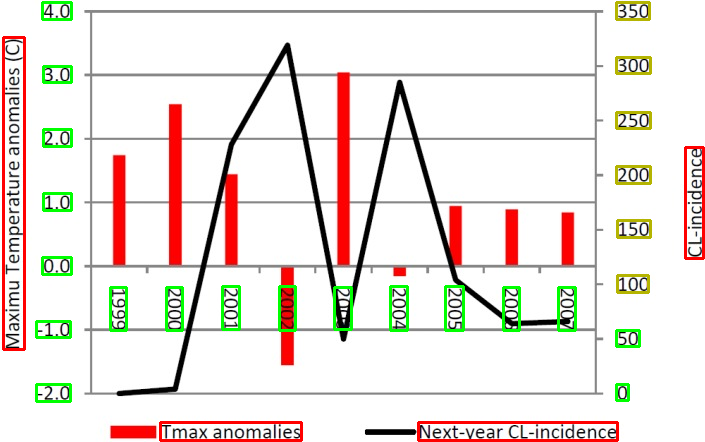

gdrive/MyDrive/csv_test/split_1/images/PMC1866515___1471-2156-4-S1-S76-1.jpg
F1 Score  1.0


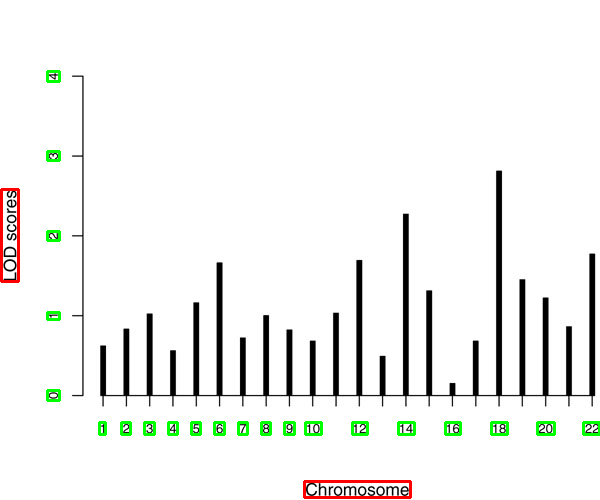

gdrive/MyDrive/csv_test/split_1/images/PMC4526302___12863_2015_249_Fig2_HTML.jpg
F1 Score  0.8181818181818182


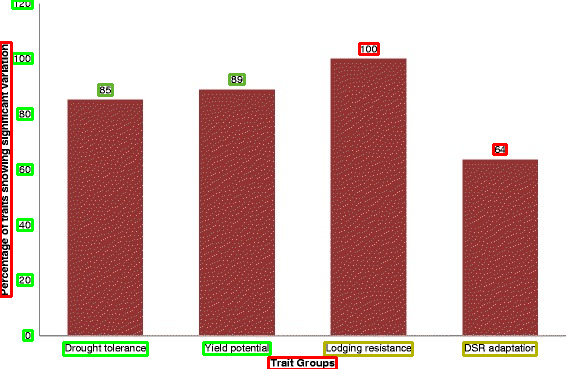

gdrive/MyDrive/csv_test/split_1/images/PMC5455395___materials-08-05374-g005.jpg
F1 Score  1.0


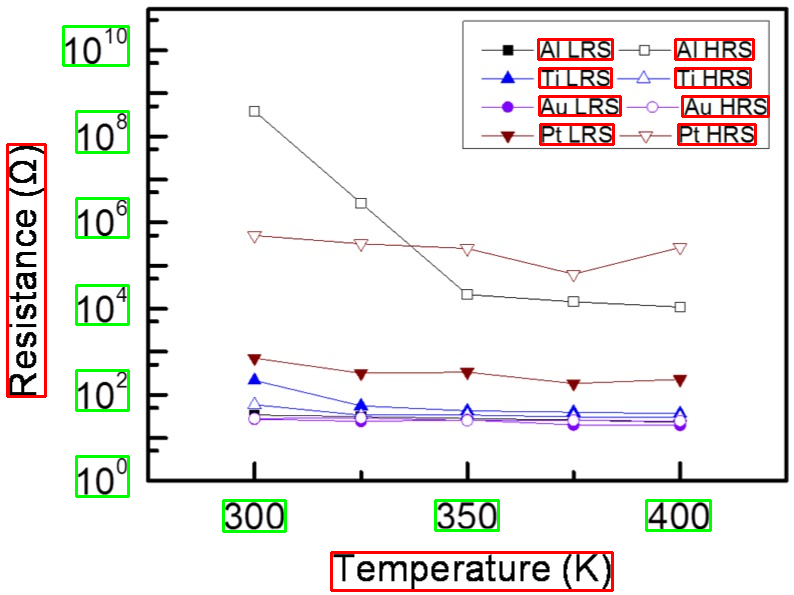

gdrive/MyDrive/csv_test/split_1/images/PMC3599818___1471-2156-14-19-2.jpg
F1 Score  1.0


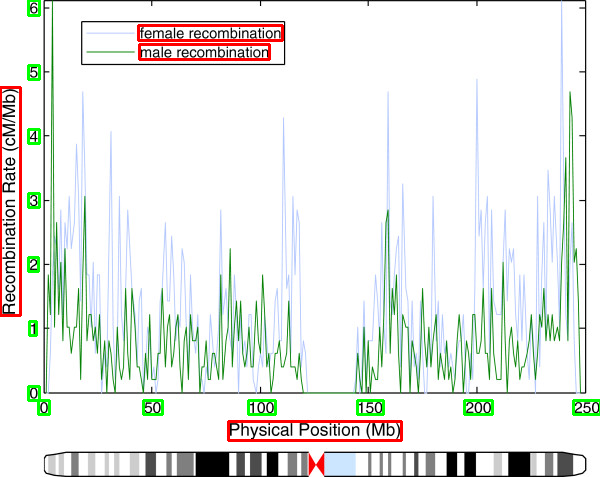

gdrive/MyDrive/csv_test/split_1/images/PMC5535221___nanomaterials-07-00155-g004.jpg
F1 Score  1.0


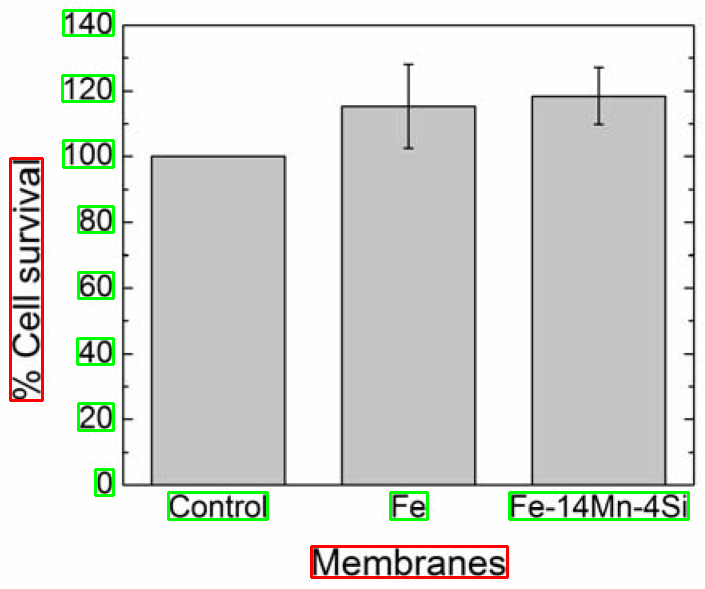

gdrive/MyDrive/csv_test/split_1/images/PMC5530424___CMMM2017-6742763.003.jpg
F1 Score  0.9818181818181818


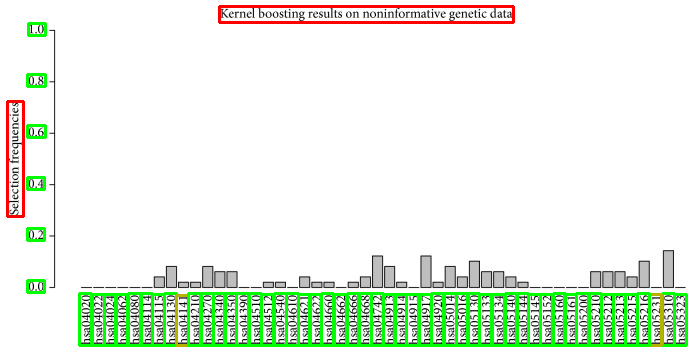

gdrive/MyDrive/csv_test/split_1/images/PMC4507402___fpubh-03-00173-g001.jpg
F1 Score  1.0


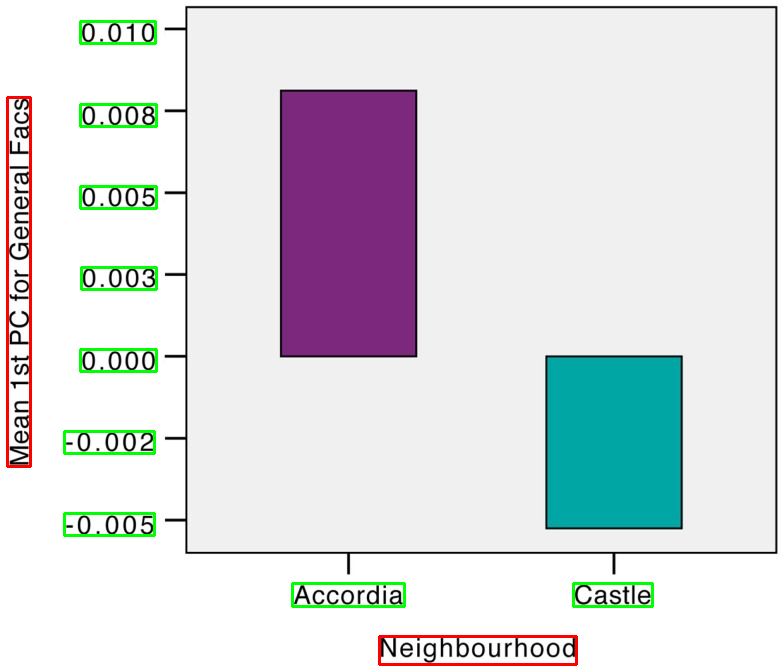

gdrive/MyDrive/csv_test/split_1/images/PMC5129295___ijerph-13-01085-g002_panel_4.jpg
F1 Score  0.9523809523809523


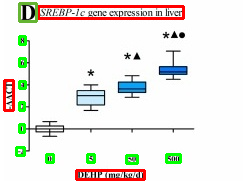

gdrive/MyDrive/csv_test/split_1/images/PMC1851708___1471-2458-7-44-3.jpg
F1 Score  1.0


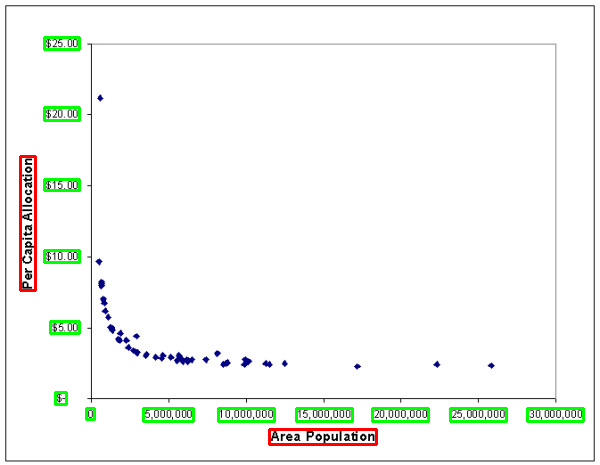

gdrive/MyDrive/csv_test/split_1/images/PMC4116647___1471-2458-13-1158-2.jpg
F1 Score  1.0


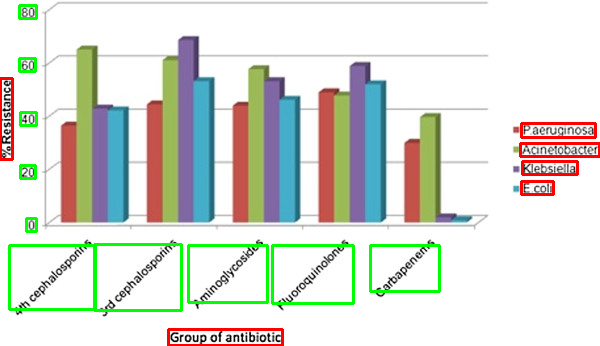

gdrive/MyDrive/csv_test/split_1/images/PMC5459201___materials-10-00116-g001.jpg
F1 Score  0.9583333333333334


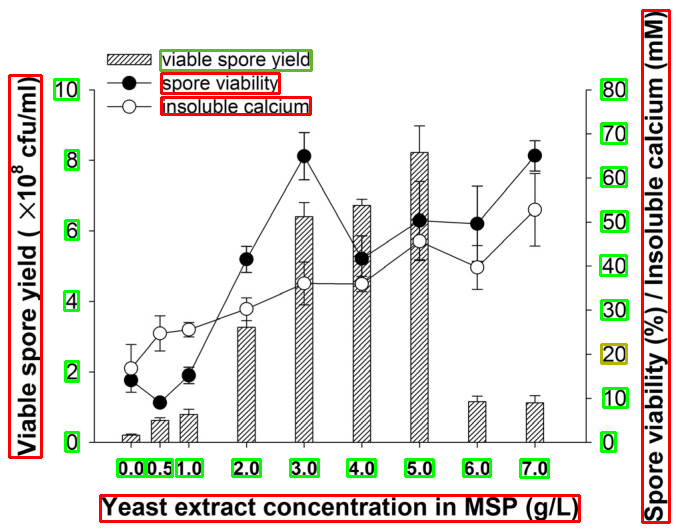

gdrive/MyDrive/csv_test/split_1/images/PMC2386472___1471-2458-8-116-1.jpg
F1 Score  0.962962962962963


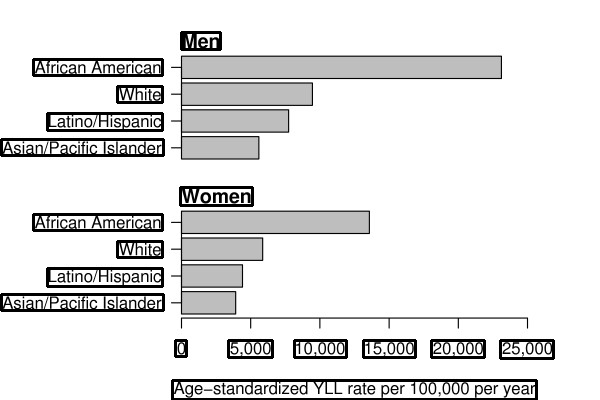

Average F1 Score : 0.9382821472125497


In [27]:
##Rough g9
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
  filename = g_val[2]
  filename = os.path.splitext(filename)[0]
  filename = 'gdrive/MyDrive/csv_test/split_1/images/' + filename + '.jpg'

  print(filename)
  if os.path.exists(filename):
    f1_i,_a,_b = eval_test(g_val, model)
    f1_net += f1_i
    cnt += 1
  else:
    print("None")

  if cnt == 100:
    break

print("Average F1 Score :",f1_net/cnt)

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5513572___materials-02-01975-g004.jpg
F1 Score  0.8235294117647058
SAMESS
14
SAMESS


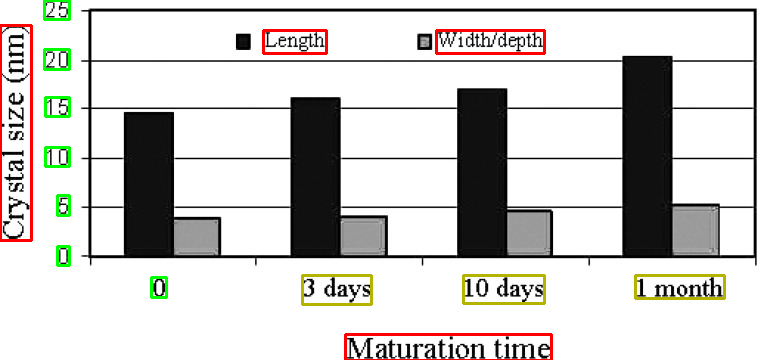

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5706191___materials-10-01244-g009.jpg
None
gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3194104___ijerph-08-03562f1.jpg
F1 Score  1.0
SAMESS
17
SAMESS


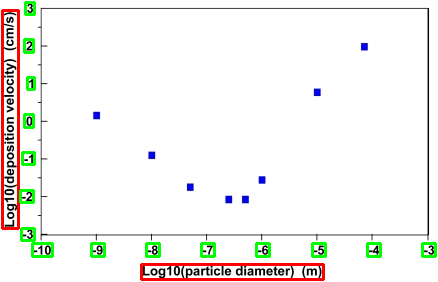

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5456605___materials-09-00842-g001.jpg
F1 Score  0.7755102040816326
SAMESS
38
SAMESS


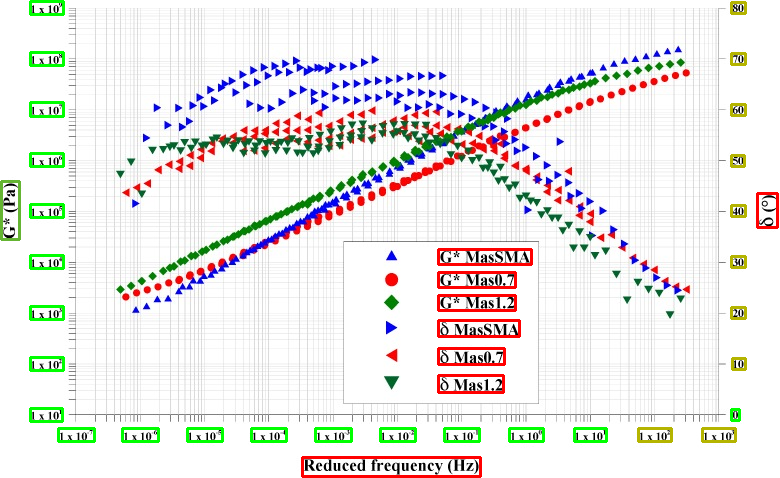

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC1177964___1471-2458-5-61-2.jpg
F1 Score  0.9714285714285714
SAMESS
22
SAMESS


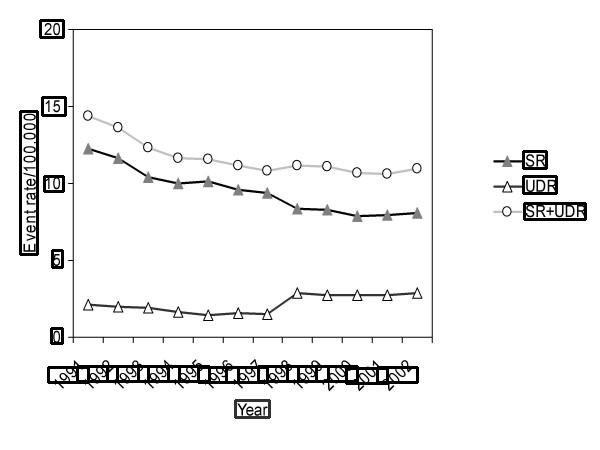

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5623034___gr4.jpg
F1 Score  1.0
SAMESS
16
SAMESS


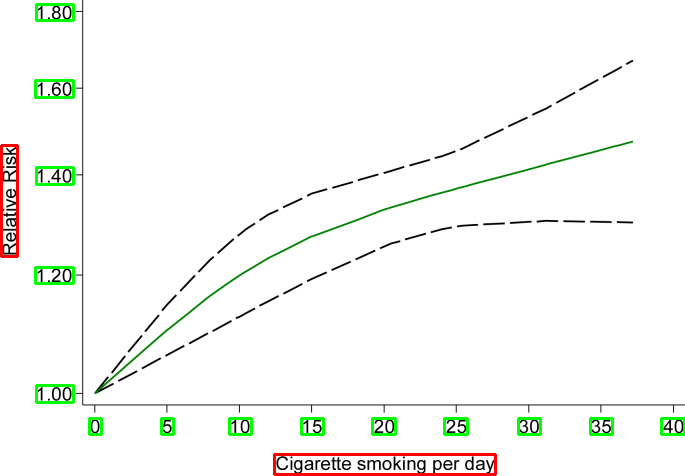

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2965752___pgen.1001172.g003_panel_3.jpg
F1 Score  0.28571428571428575
SAMESS
14
SAMESS


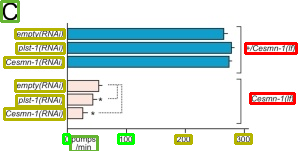

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC1175092___1471-2458-5-55-8.jpg
F1 Score  0.9565217391304348
SAMESS
17
SAMESS


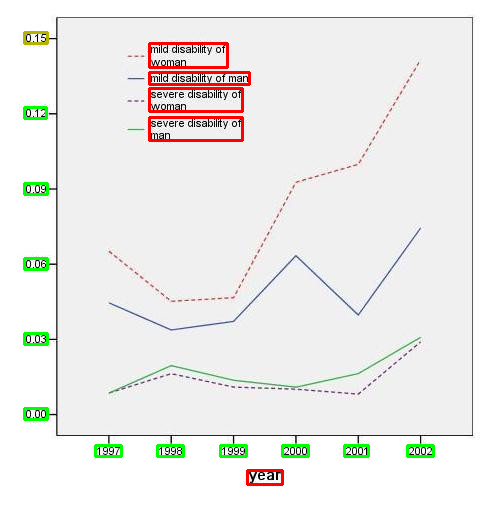

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2837018___1471-2350-11-19-2.jpg
F1 Score  0.9473684210526316
SAMESS
14
SAMESS


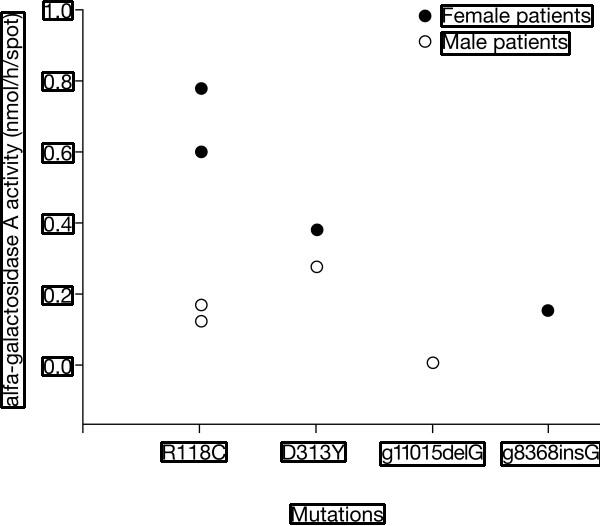

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5502995___materials-09-00302-i003.jpg
F1 Score  0.9655172413793104
SAMESS
22
SAMESS


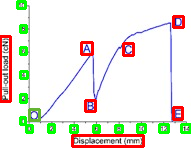

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5127152___1415-4757-gmb-1678-4685-GMB-2015-0327-gf06_panel_1.jpg
F1 Score  0.0
SAMESS
30
SAMESS


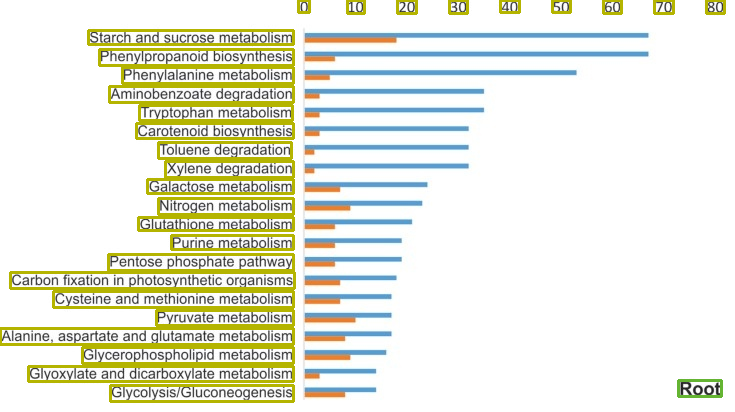

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5453356___materials-07-02631f15.jpg
F1 Score  1.0
SAMESS
12
SAMESS


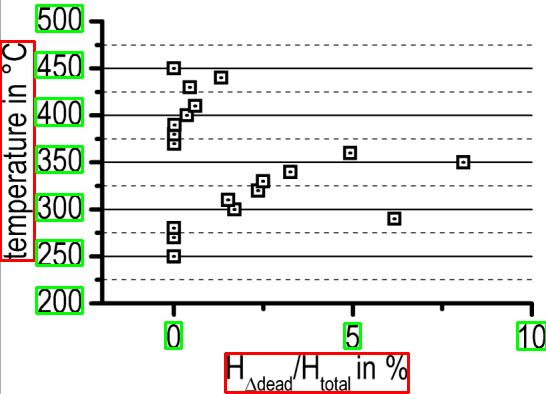

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3979040___1471-2458-13-1147-2_panel_2.jpg
F1 Score  0.7499999999999999
SAMESS
12
SAMESS


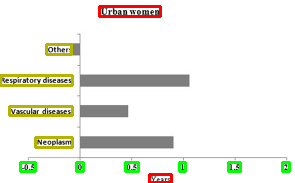

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5448931___materials-05-01373-g006.jpg
F1 Score  1.0
SAMESS
21
SAMESS


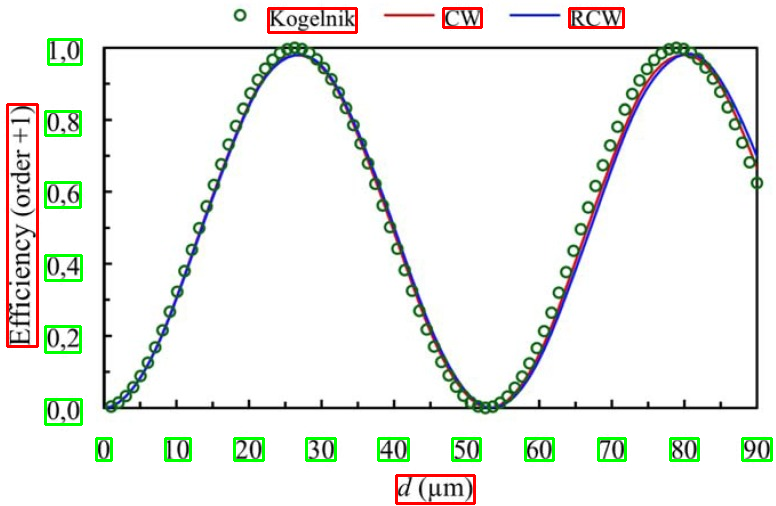

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4240172___fgene-05-00402-g0005.jpg
F1 Score  0.9166666666666666
SAMESS
15
SAMESS


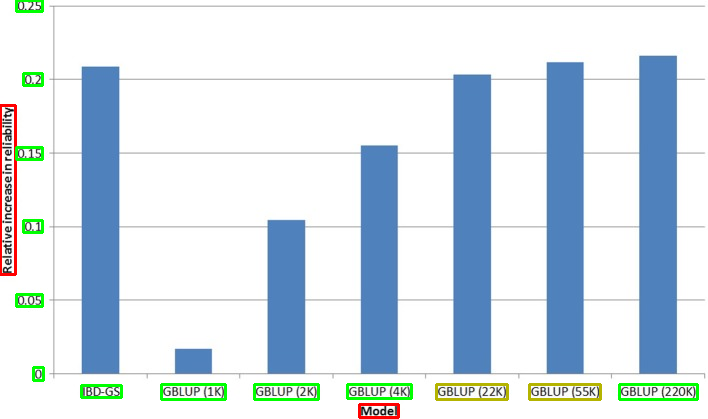

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5715626___13148_2017_426_Fig1_HTML.jpg
None
gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2697378___pgen.1000548.g003.jpg
F1 Score  1.0
SAMESS
11
SAMESS


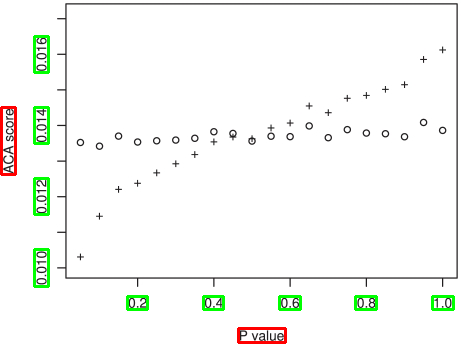

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5456760___materials-09-00461-g004.jpg
F1 Score  0.9473684210526316
SAMESS
28
SAMESS


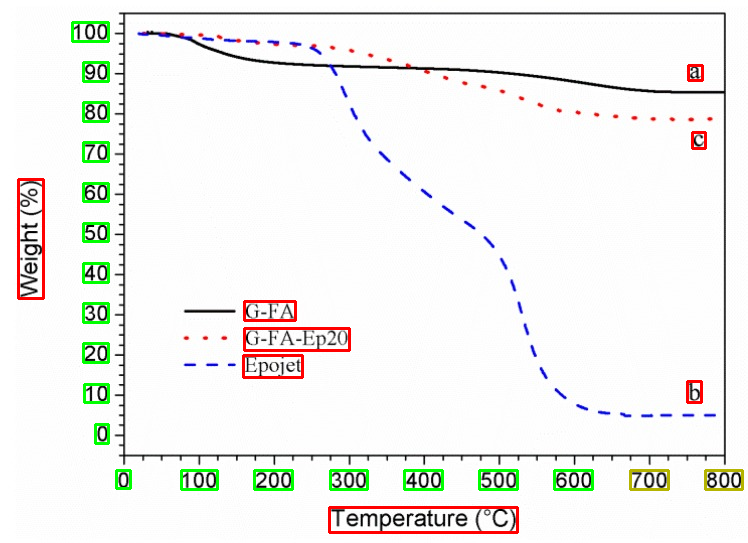

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5551820___materials-10-00777-g005b.jpg
F1 Score  0.9696969696969697
SAMESS
24
SAMESS


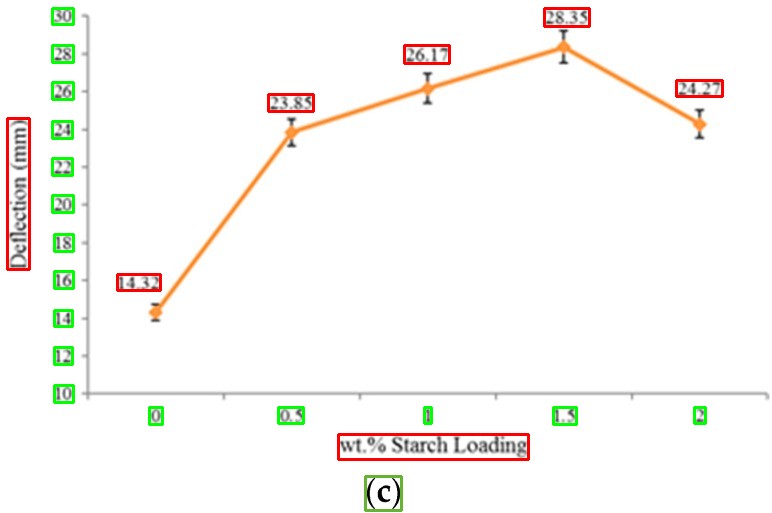

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3924455___ijerph-11-00473-g004.jpg
F1 Score  1.0
SAMESS
23
SAMESS


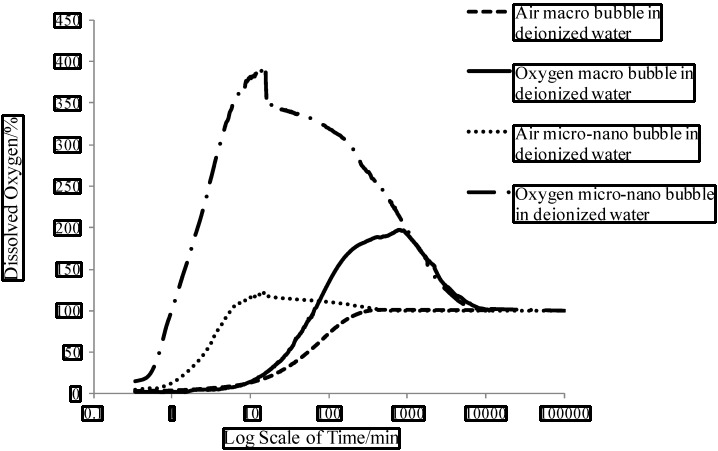

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5457115___materials-09-00763-g004.jpg
F1 Score  0.9166666666666666
SAMESS
17
SAMESS


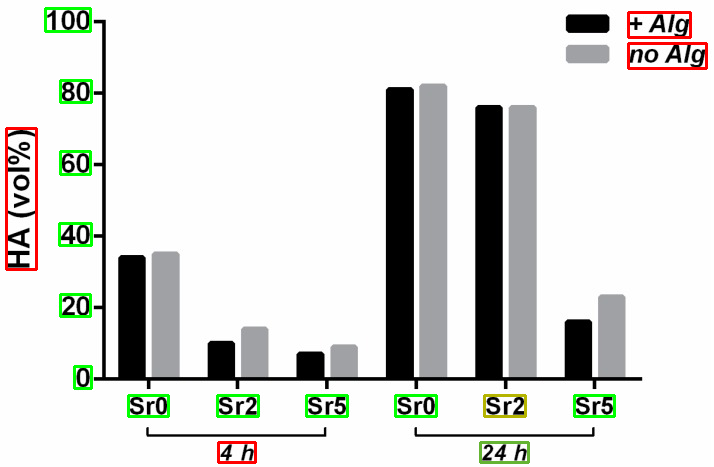

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4462096___fgene-06-00208-g0002.jpg
F1 Score  1.0
SAMESS
21
SAMESS


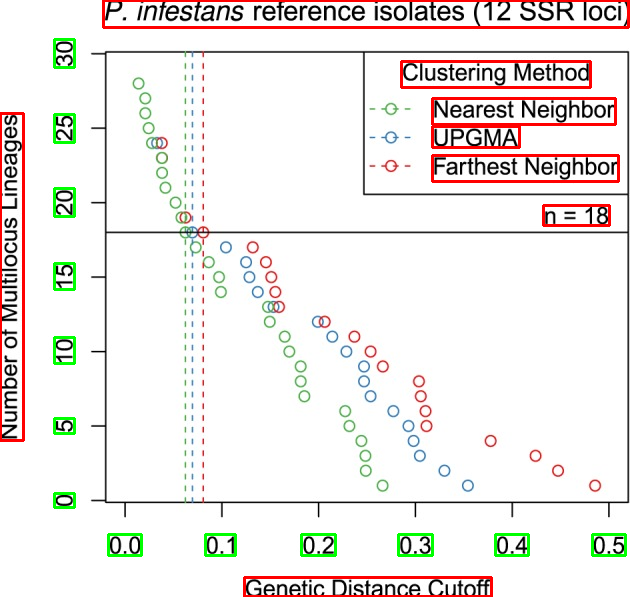

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2638803___ddn37501.jpg
F1 Score  1.0
SAMESS
20
SAMESS


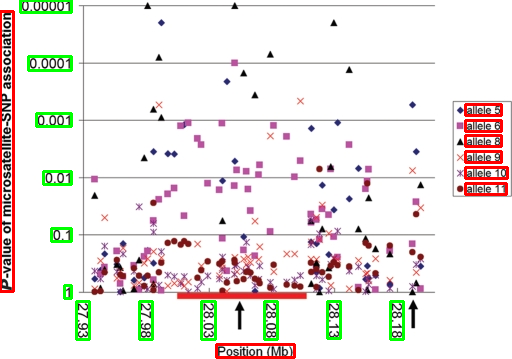

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4210971___ijerph-11-10125-g002_panel_2.jpg
F1 Score  0.9473684210526316
SAMESS
12
SAMESS


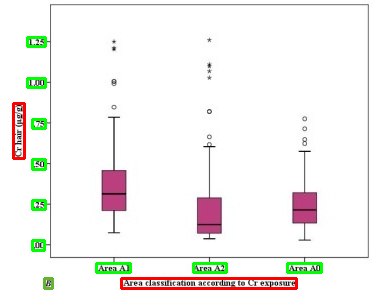

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3778868___1471-2156-13-67-2.jpg
F1 Score  1.0
SAMESS
34
SAMESS


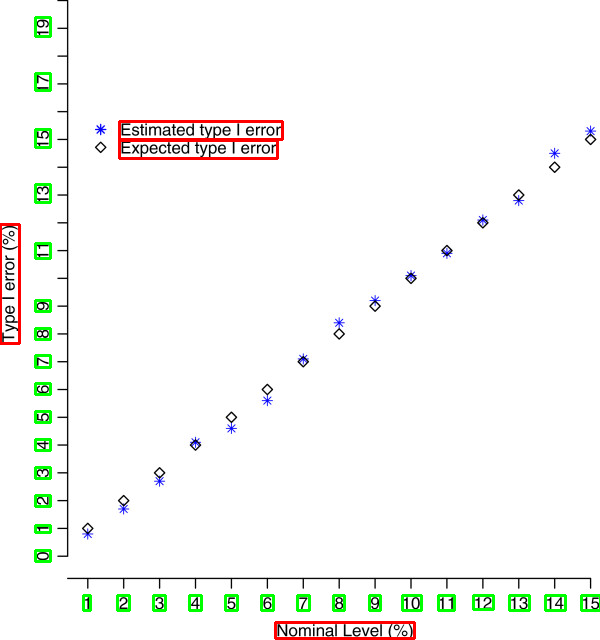

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4720273___pgen.1005796.g003_panel_3.jpg
F1 Score  0.7999999999999999
SAMESS
10
SAMESS


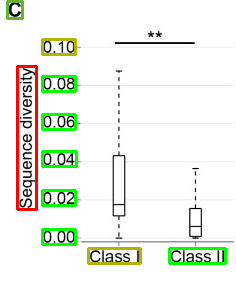

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5295322___ijerph-14-00071-g002.jpg
F1 Score  0.6086956521739131
SAMESS
17
SAMESS


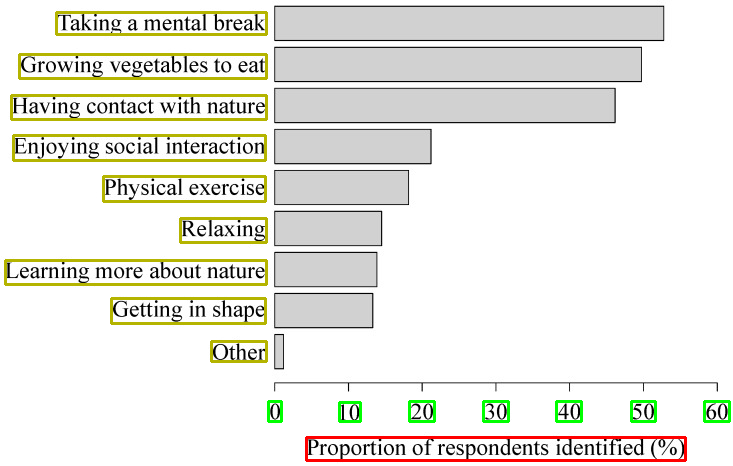

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2738883___ijerph-06-02205f2.jpg
F1 Score  0.6153846153846153
SAMESS
21
SAMESS


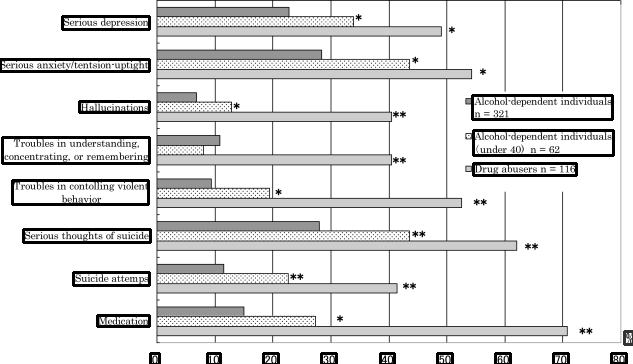

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5402782___IJPH-46-229-g001.jpg
F1 Score  1.0
SAMESS
15
SAMESS


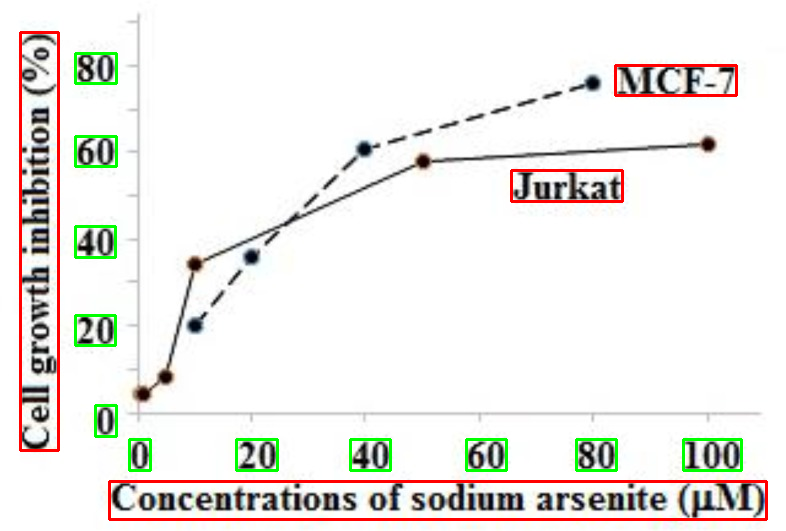

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4454976___ijerph-12-05408-g004.jpg
F1 Score  1.0
SAMESS
21
SAMESS


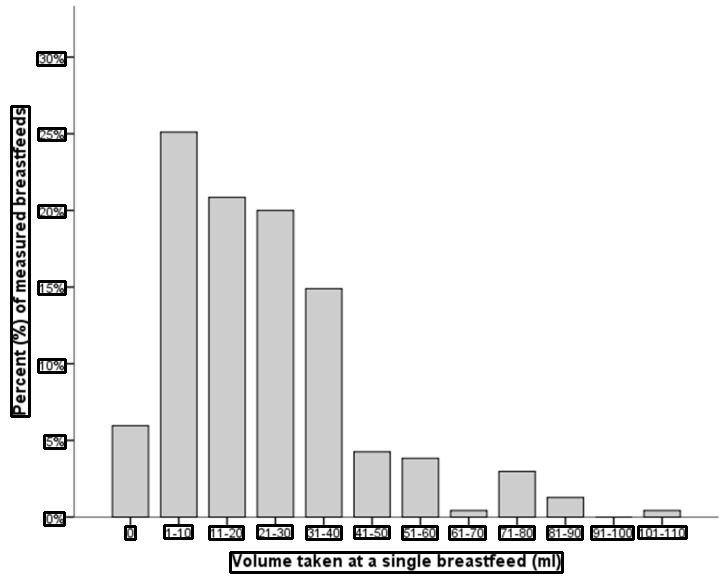

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3471511___fgene-03-00208-g003.jpg
F1 Score  1.0
SAMESS
30
SAMESS


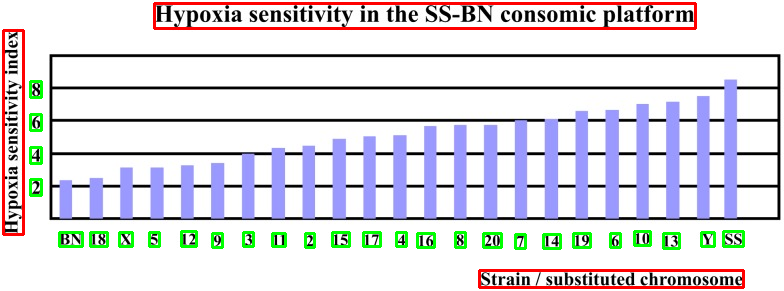

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5455563___materials-08-02433-g014.jpg
F1 Score  0.9600000000000001
SAMESS
14
SAMESS


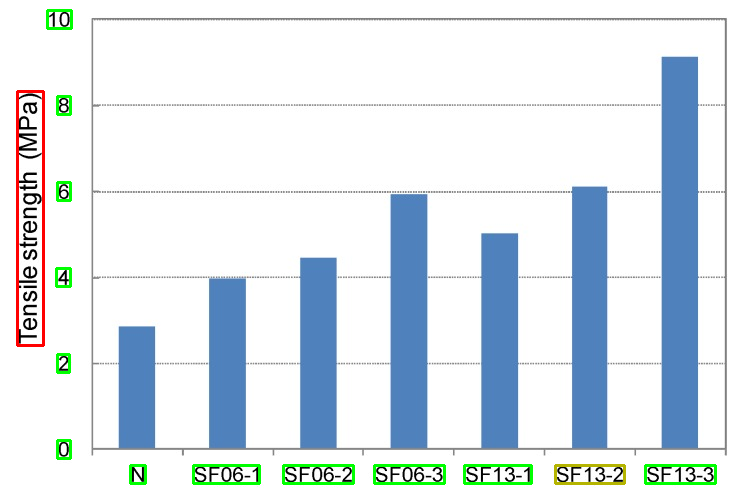

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4595289___pgen.1005493.g004_panel_1.jpg
F1 Score  0.6
SAMESS
23
SAMESS


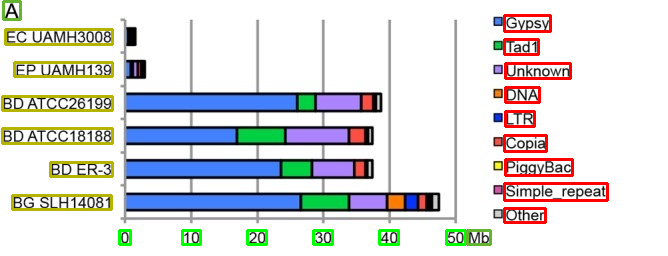

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3987040___ijerph-11-03387-g001.jpg
F1 Score  0.9
SAMESS
15
SAMESS


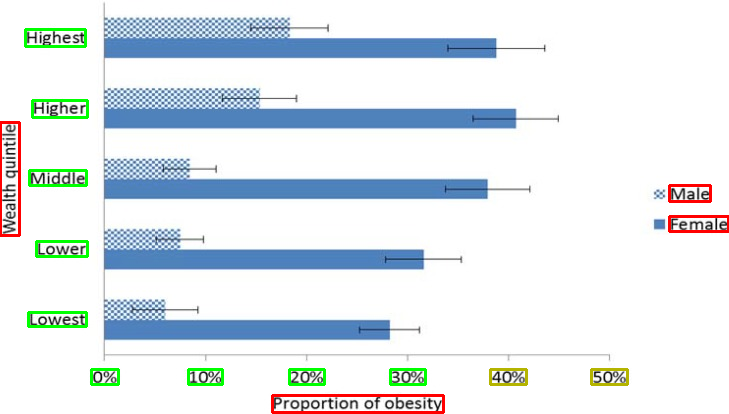

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4546248___12889_2015_2135_Fig1_HTML.jpg
F1 Score  0.9500000000000001
SAMESS
25
SAMESS


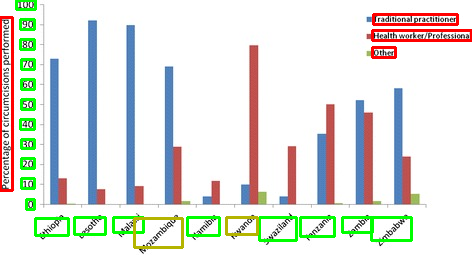

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5535244___nanomaterials-07-00178-g007.jpg
F1 Score  1.0
SAMESS
13
SAMESS


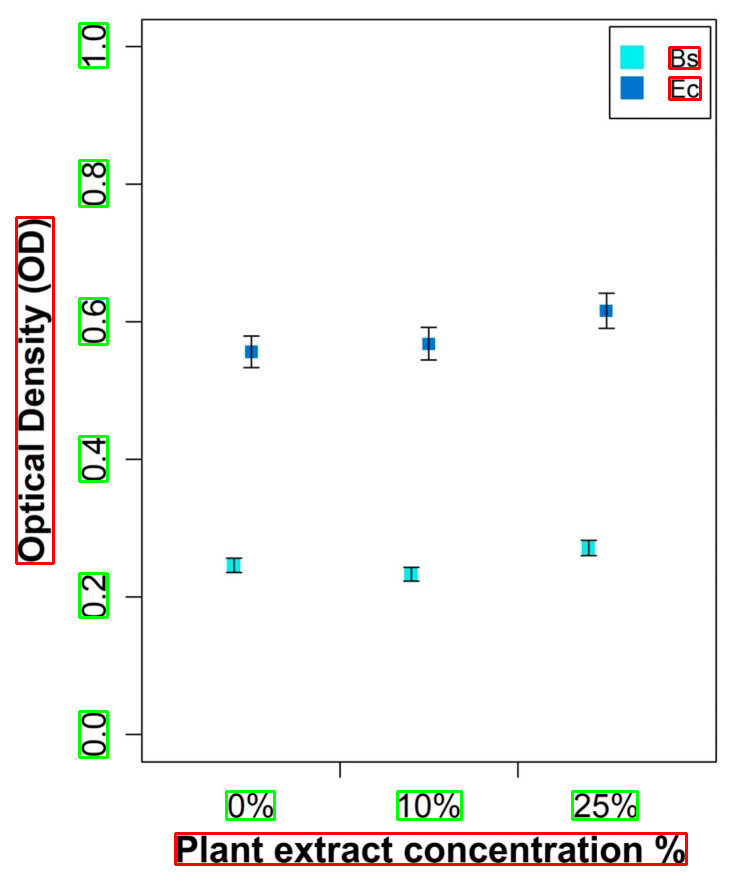

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC1550283___pgen.0020130.g002.jpg
F1 Score  0.8695652173913044
SAMESS
28
SAMESS


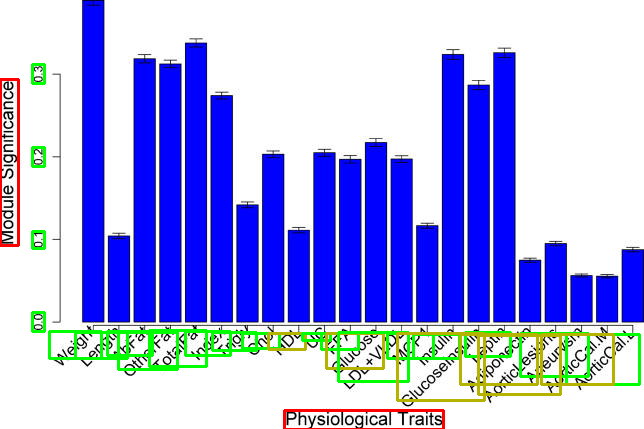

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5551860___materials-10-00817-g004.jpg
F1 Score  1.0
SAMESS
16
SAMESS


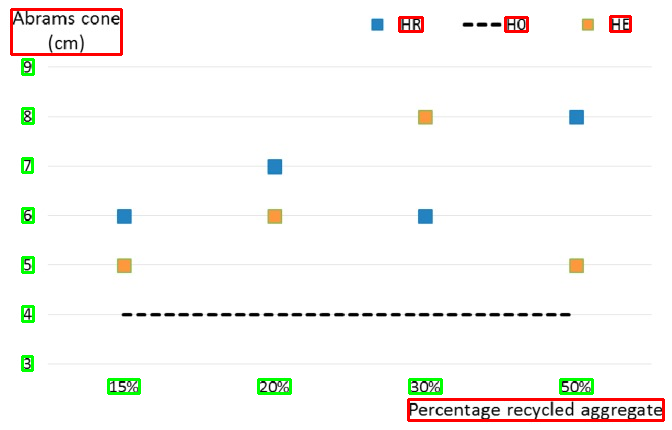

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5463023___gr2.jpg
F1 Score  0.761904761904762
SAMESS
14
SAMESS


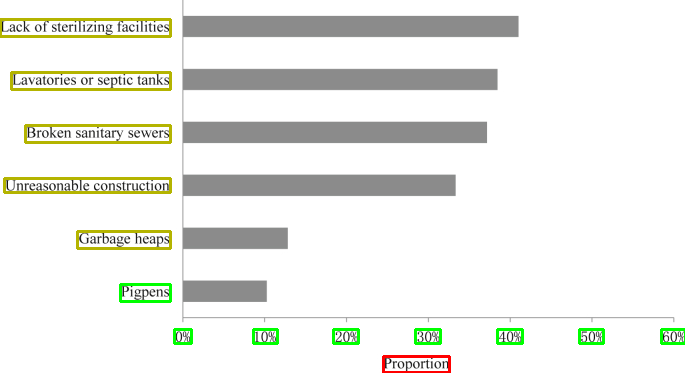

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5395535___IJPH-46-389-g001.jpg
F1 Score  0.9032258064516129
SAMESS
32
SAMESS


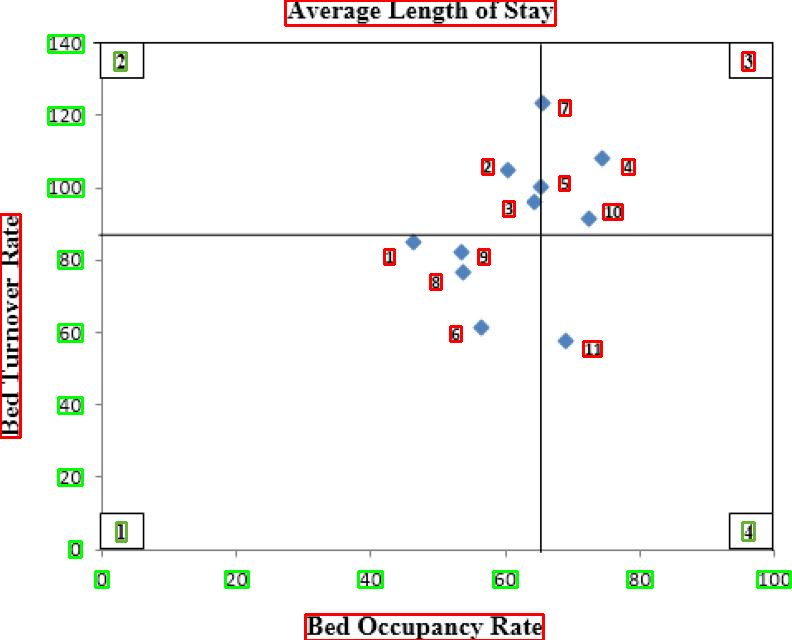

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5664650___ijerph-14-01149-g001.jpg
F1 Score  1.0
SAMESS
18
SAMESS


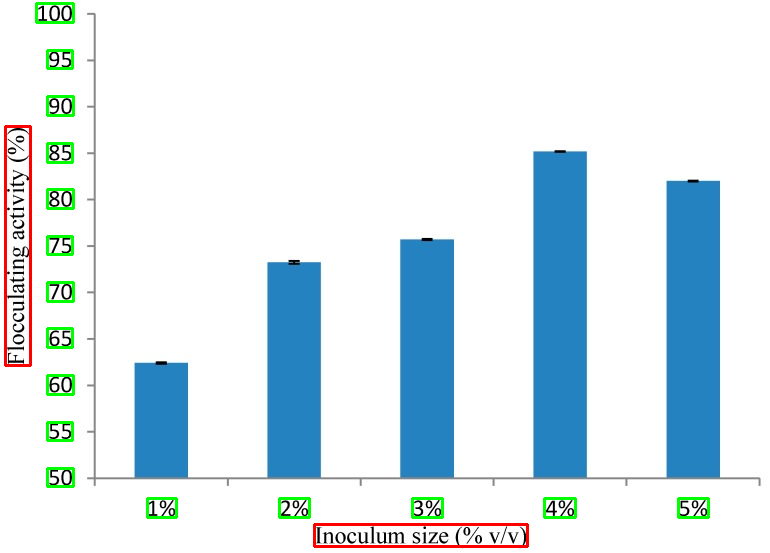

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4216350___12889_2014_7189_Fig1_HTML.jpg
F1 Score  1.0
SAMESS
20
SAMESS


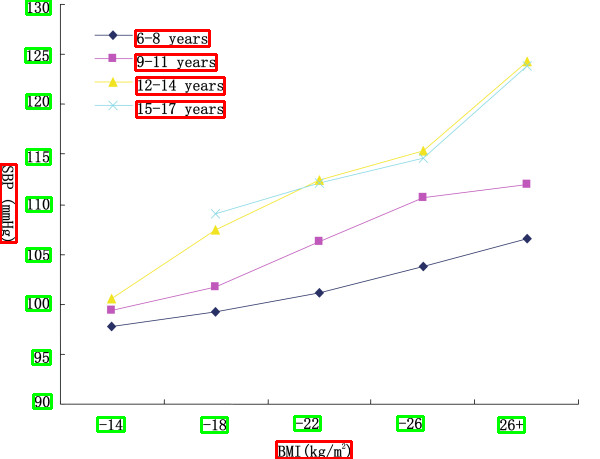

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5129335___ijerph-13-01125-g004.jpg
F1 Score  0.5641025641025642
SAMESS
44
SAMESS


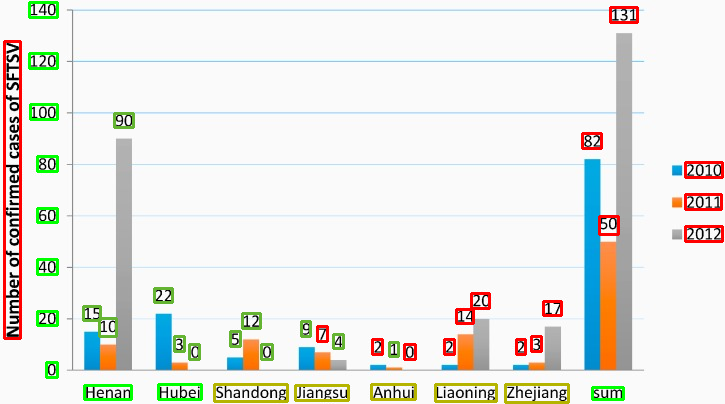

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3750330___1471-2156-14-65-4.jpg
F1 Score  1.0
SAMESS
15
SAMESS


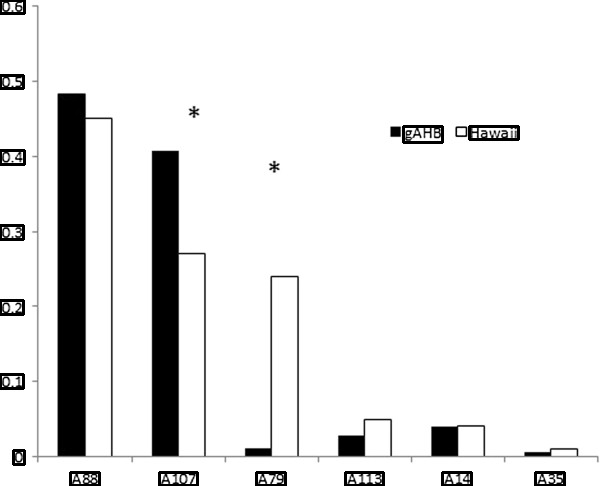

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5369085___ijerph-14-00249-g002.jpg
F1 Score  0.9655172413793104
SAMESS
20
SAMESS


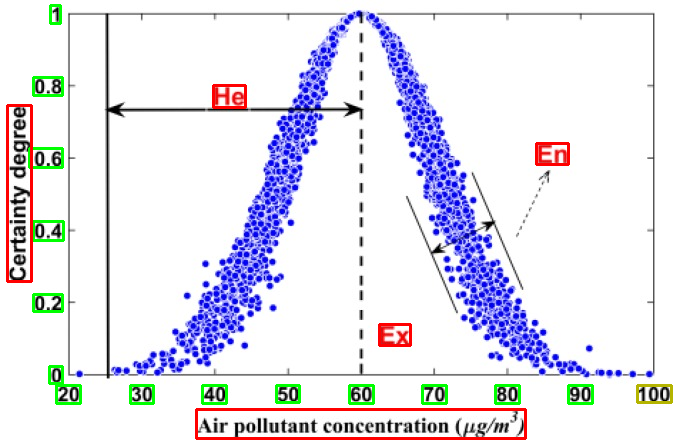

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4230888___pgen.1004784.g003.jpg
F1 Score  1.0
SAMESS
27
SAMESS


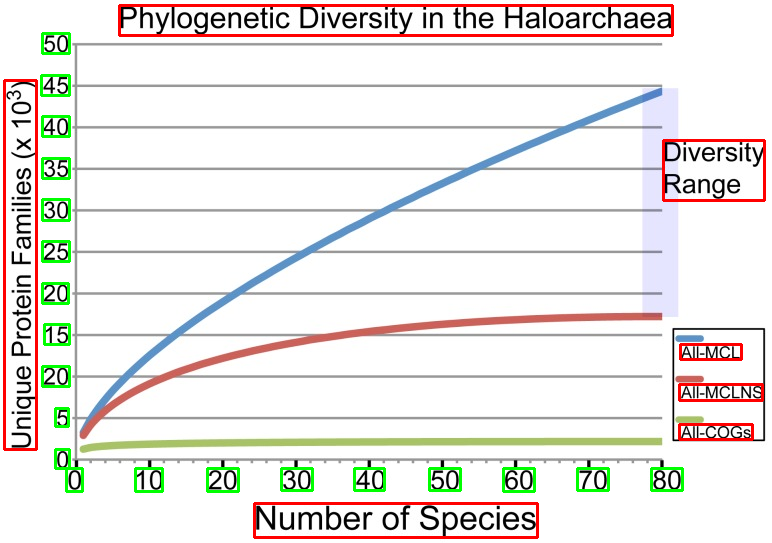

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3036071___gmb-33-1-146-gfig4.jpg
F1 Score  1.0
SAMESS
21
SAMESS


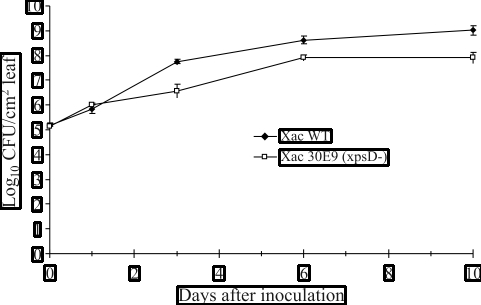

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5663691___fpubh-05-00247-g003.jpg
F1 Score  0.8695652173913044
SAMESS
17
SAMESS


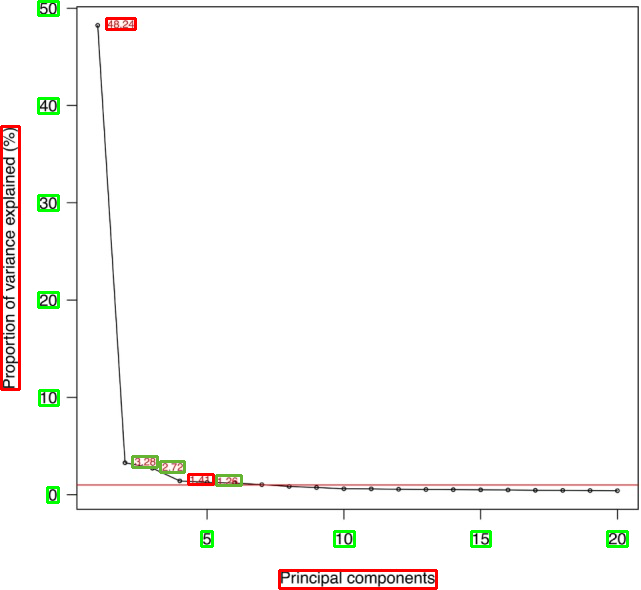

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3829466___fgene-04-00217-g0008.jpg
F1 Score  1.0
SAMESS
21
SAMESS


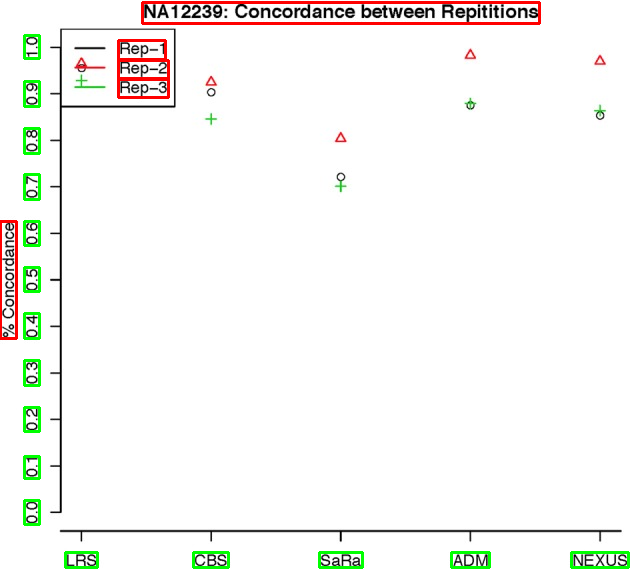

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2965752___pgen.1001172.g003_panel_2.jpg
F1 Score  0.4444444444444444
SAMESS
27
SAMESS


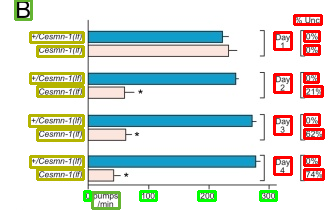

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3598336___1471-2458-13-171-1.jpg
F1 Score  0.888888888888889
SAMESS
17
SAMESS


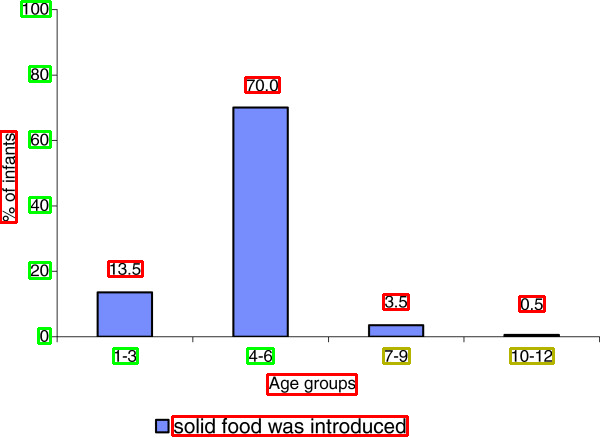

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3296265___CMMM2012-917695.011.jpg
F1 Score  1.0
SAMESS
24
SAMESS


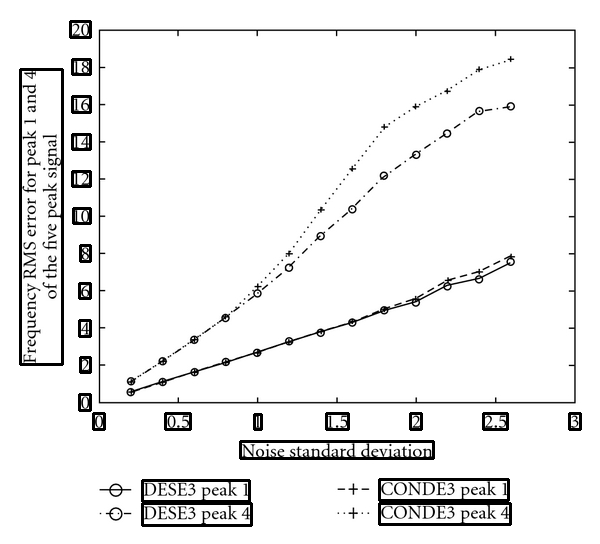

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3652765___1297-9686-45-8-2.jpg
F1 Score  0.9285714285714286
SAMESS
23
SAMESS


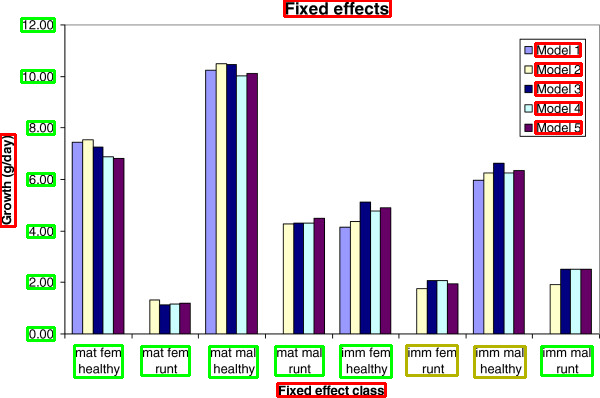

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5096291___13148_2016_281_Fig2_HTML_panel_4.jpg
F1 Score  0.9411764705882353
SAMESS
11
SAMESS


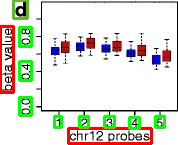

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5580613___ijerph-14-00910-g002.jpg
F1 Score  0.5555555555555556
SAMESS
21
SAMESS


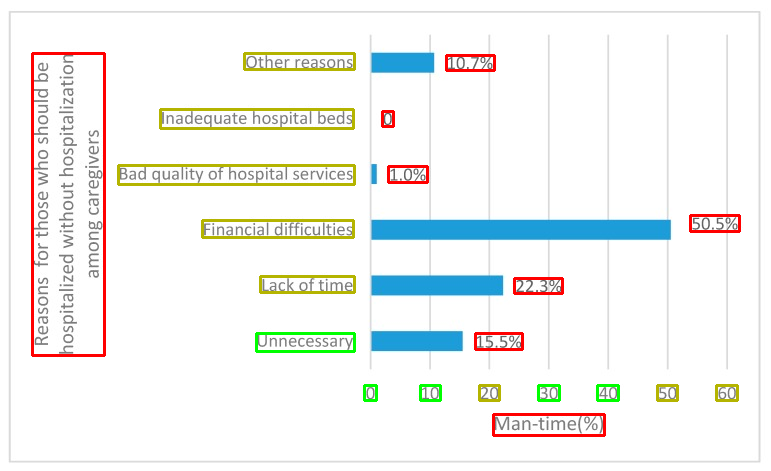

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5457113___materials-09-00743-g002.jpg
F1 Score  1.0
SAMESS
26
SAMESS


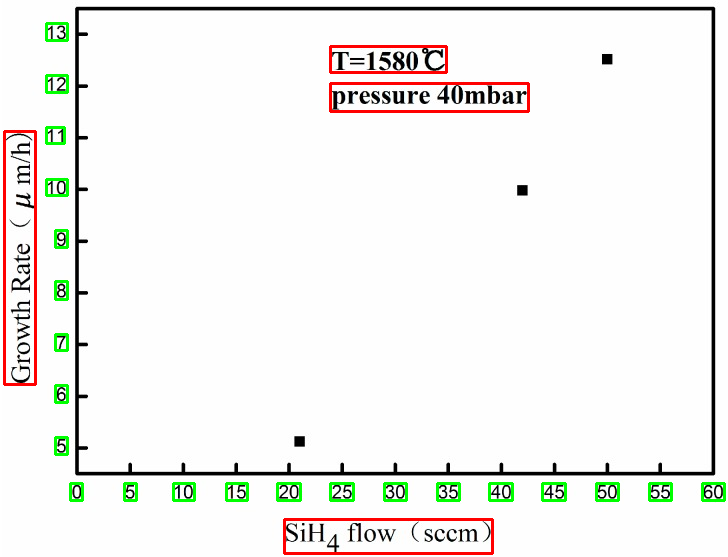

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4233103___12889_2013_7234_Fig4_HTML.jpg
F1 Score  0.5185185185185185
SAMESS
42
SAMESS


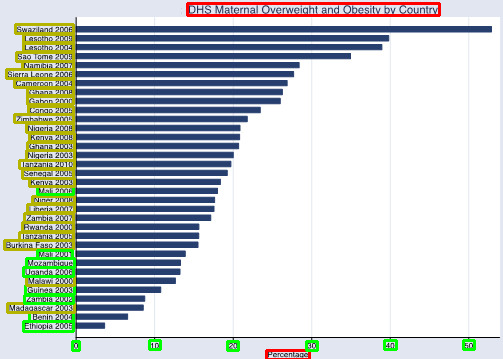

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5075398___12889_2016_3744_Fig2_HTML.jpg
F1 Score  0.9523809523809523
SAMESS
14
SAMESS


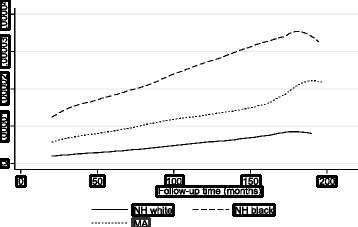

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5445876___materials-03-01497-g004.jpg
F1 Score  0.9655172413793104
SAMESS
34
SAMESS


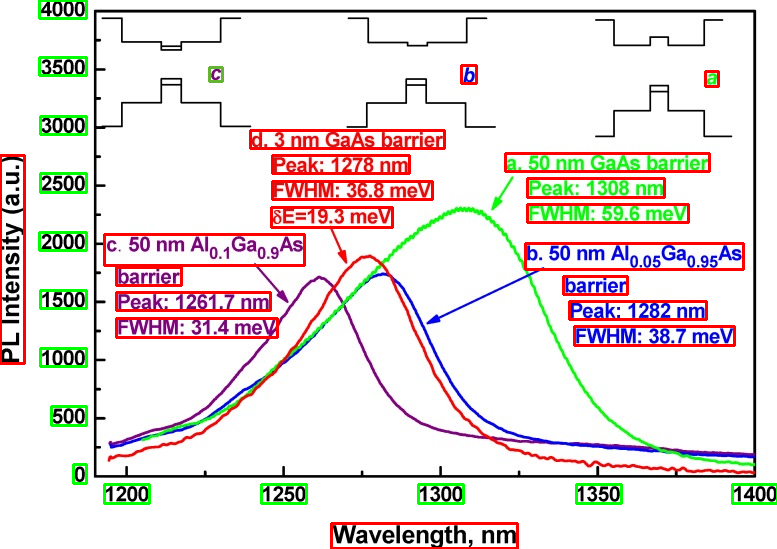

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4340639___12889_2015_1501_Fig2_HTML_part_B.jpg
F1 Score  0.48275862068965514
SAMESS
24
SAMESS


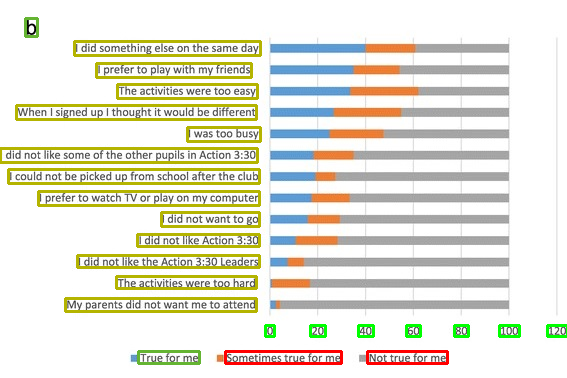

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5453213___materials-07-03588f10.jpg
F1 Score  1.0
SAMESS
19
SAMESS


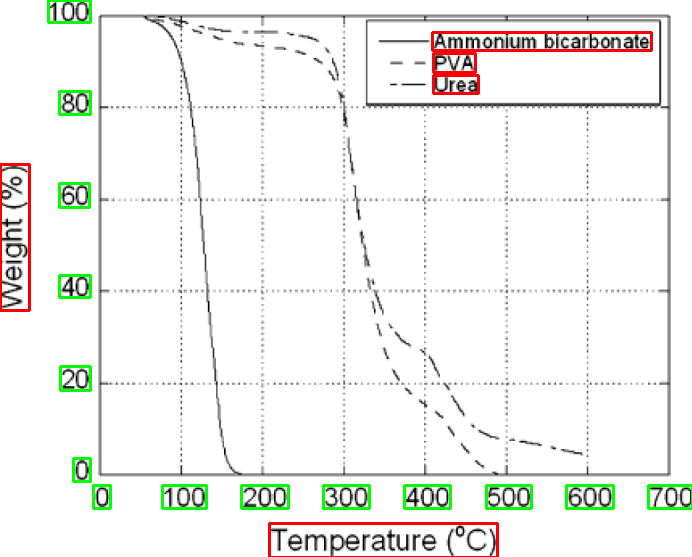

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5503377___materials-10-00291-g003a.jpg
F1 Score  0.9523809523809523
SAMESS
14
SAMESS


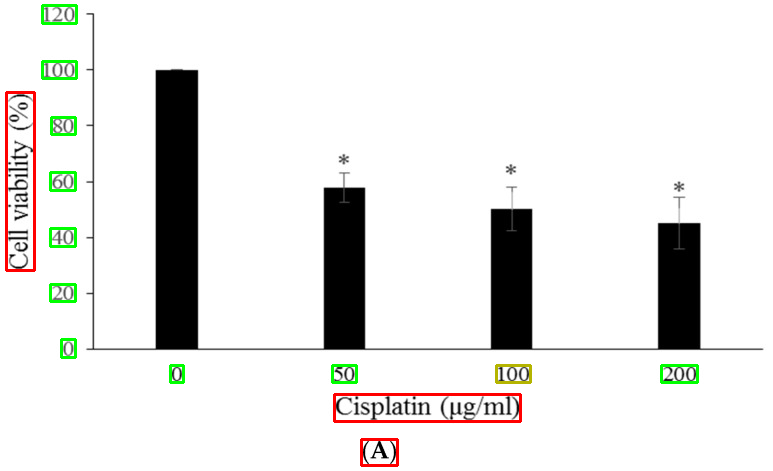

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2684744___1471-2458-9-128-1.jpg
F1 Score  0.8695652173913044
SAMESS
19
SAMESS


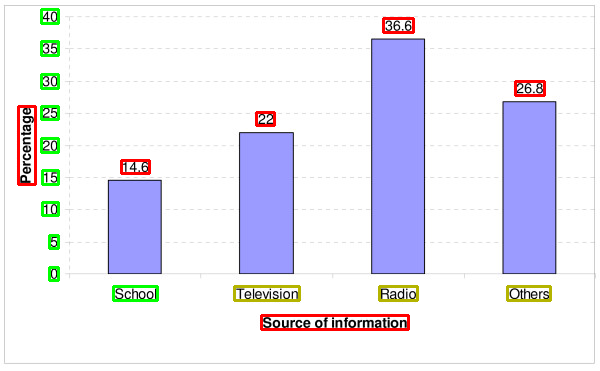

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2673039___pgen.1000480.g004_part_D.jpg
F1 Score  0.923076923076923
SAMESS
12
SAMESS


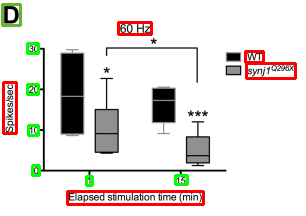

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5157951___pgen.1006232.g003.jpg
F1 Score  1.0
SAMESS
22
SAMESS


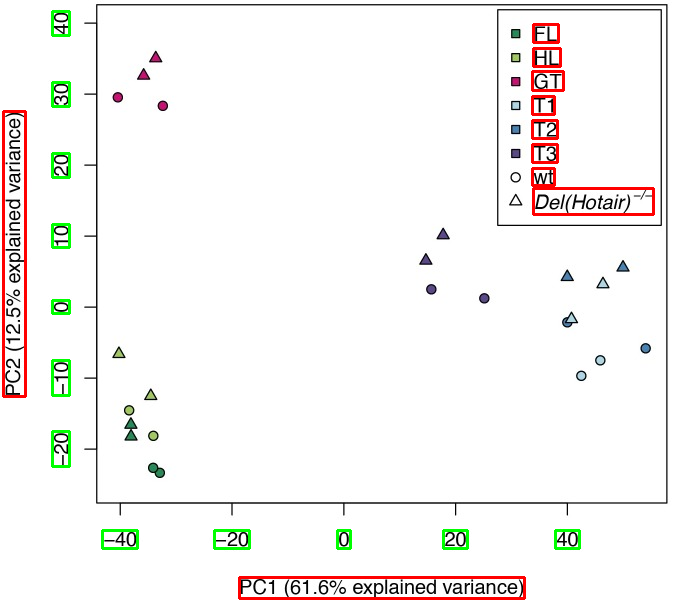

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3945548___ijerph-11-01465-g001.jpg
F1 Score  1.0
SAMESS
41
SAMESS


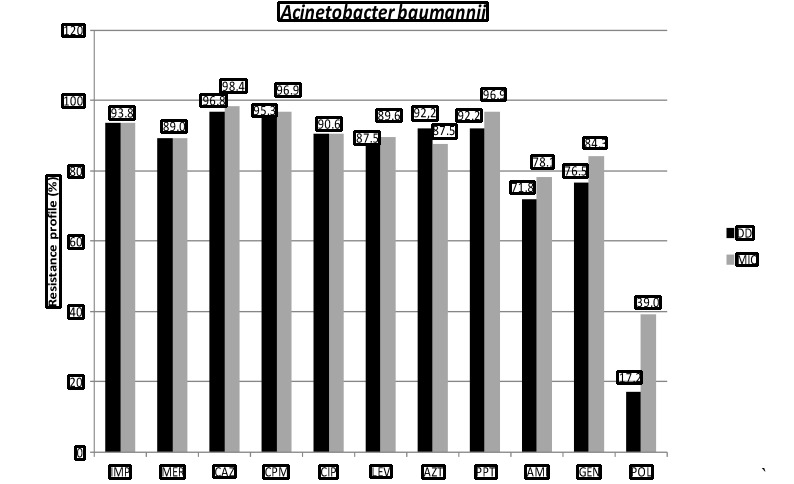

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4730450___ijerph-13-00059-g003.jpg
F1 Score  0.8
SAMESS
12
SAMESS


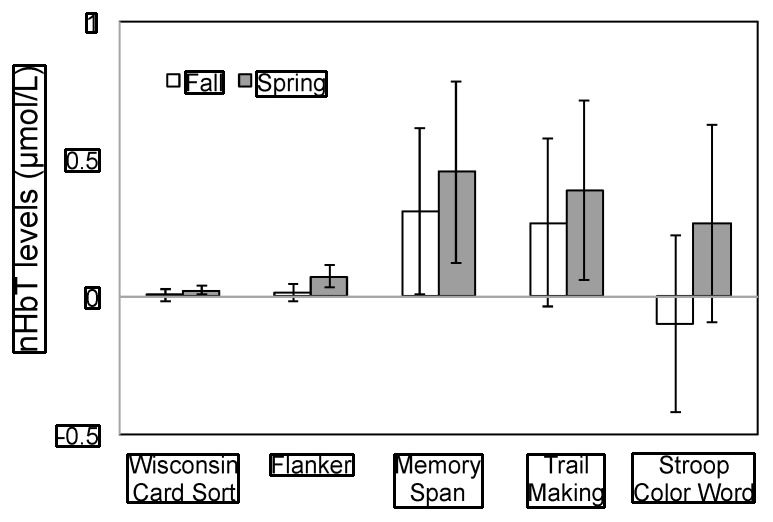

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5103450___13072_2016_102_Fig4_HTML_panel_5.jpg
F1 Score  0.38095238095238093
SAMESS
18
SAMESS


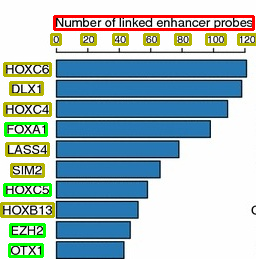

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4052169___CMMM2014-715494.003.jpg
F1 Score  0.8799999999999999
SAMESS
16
SAMESS


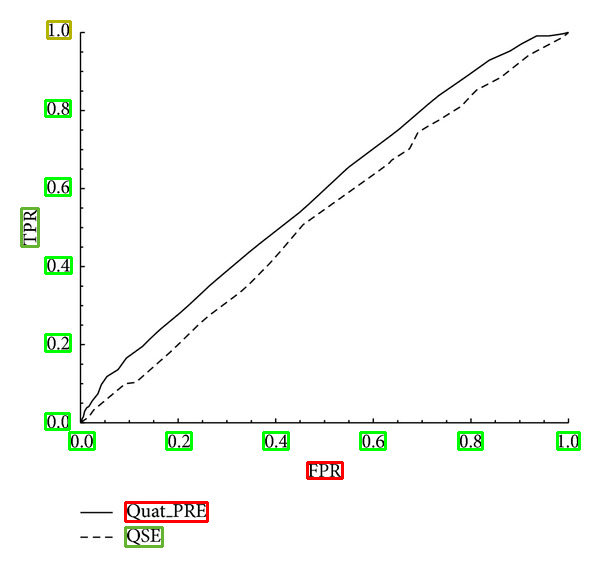

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4169242___pgen.1004619.g007_panel_3.jpg
F1 Score  0.875
SAMESS
11
SAMESS


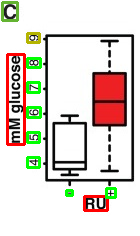

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5455930___materials-07-04524-g011.jpg
F1 Score  0.975609756097561
SAMESS
27
SAMESS


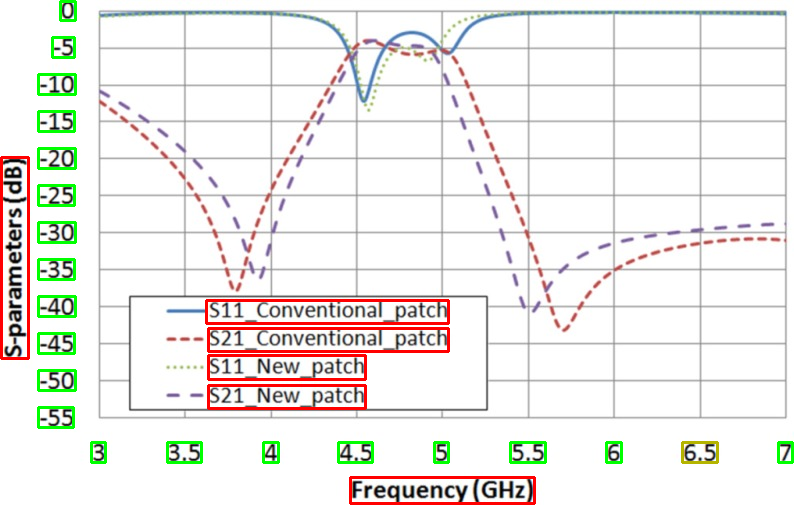

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4036606___1297-9686-46-24-5.jpg
F1 Score  1.0
SAMESS
23
SAMESS


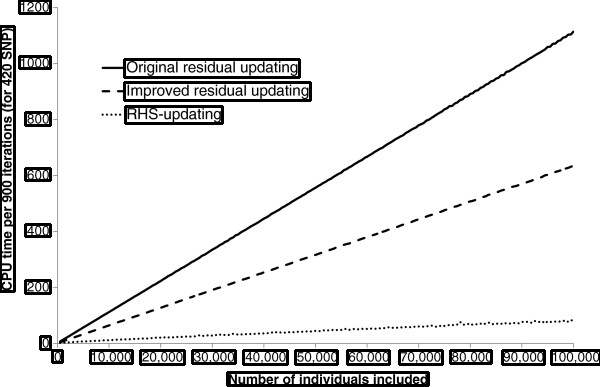

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2903518___1471-2458-10-330-1.jpg
F1 Score  0.896551724137931
SAMESS
23
SAMESS


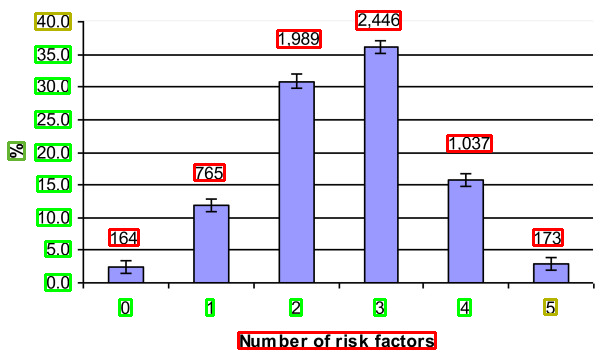

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5453266___materials-07-01483f3.jpg
F1 Score  0.9
SAMESS
15
SAMESS


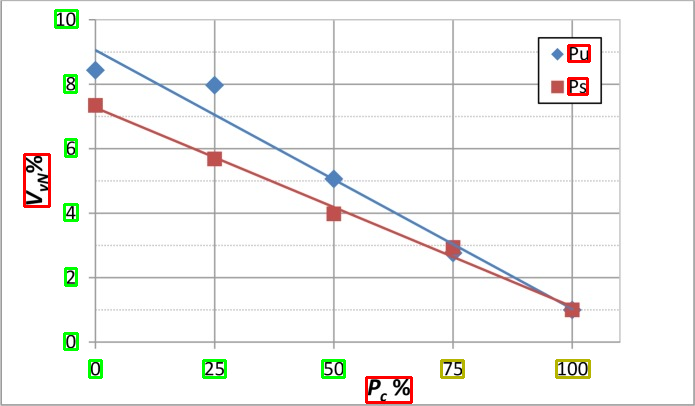

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5578213___materials-10-00842-g008.jpg
F1 Score  0.888888888888889
SAMESS
27
SAMESS


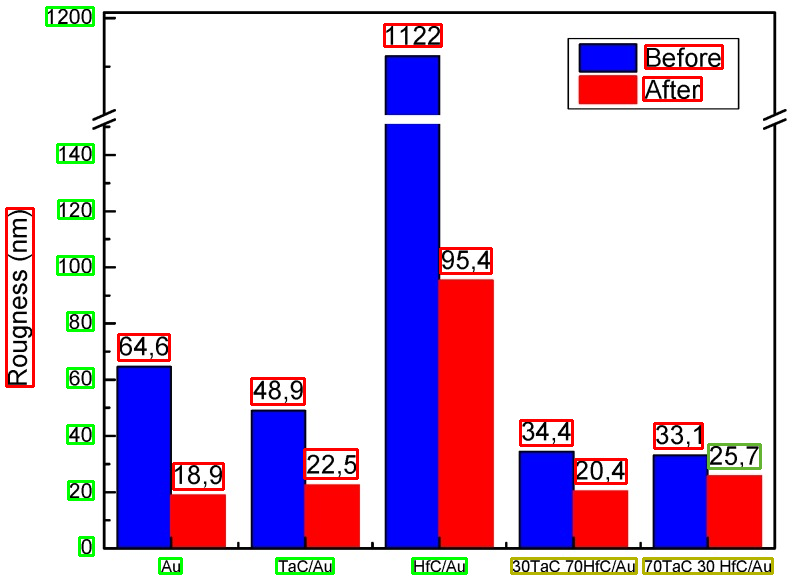

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5448889___materials-04-02136-g001.jpg
F1 Score  0.6666666666666667
SAMESS
16
SAMESS


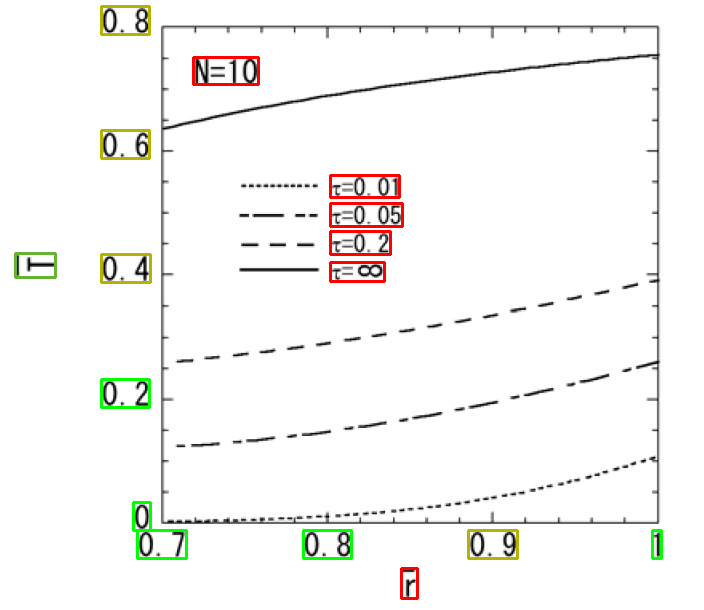

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3342160___1471-2458-12-192-1.jpg
F1 Score  0.6086956521739131
SAMESS
26
SAMESS


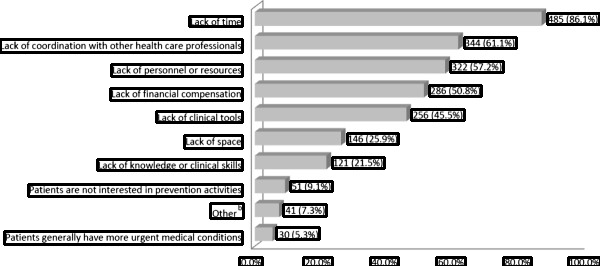

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2705350___1471-2458-9-149-1.jpg
F1 Score  0.8
SAMESS
11
SAMESS


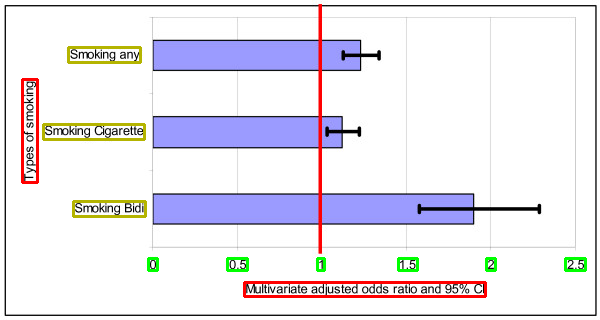

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2488325___1471-2350-9-64-1.jpg
F1 Score  0.7857142857142857
SAMESS
21
SAMESS


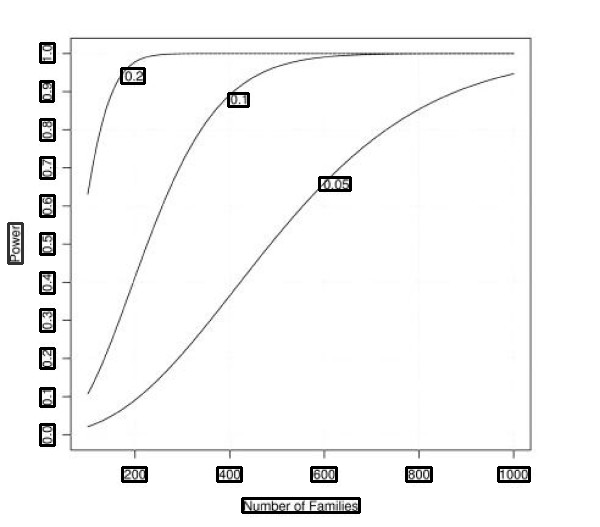

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5448501___materials-04-00585-g007.jpg
F1 Score  0.9655172413793104
SAMESS
35
SAMESS


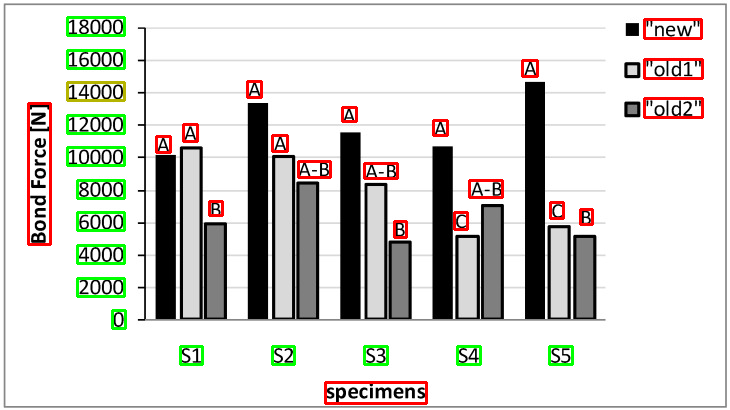

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4924012___ijerph-13-00555-g003.jpg
F1 Score  0.9696969696969697
SAMESS
18
SAMESS


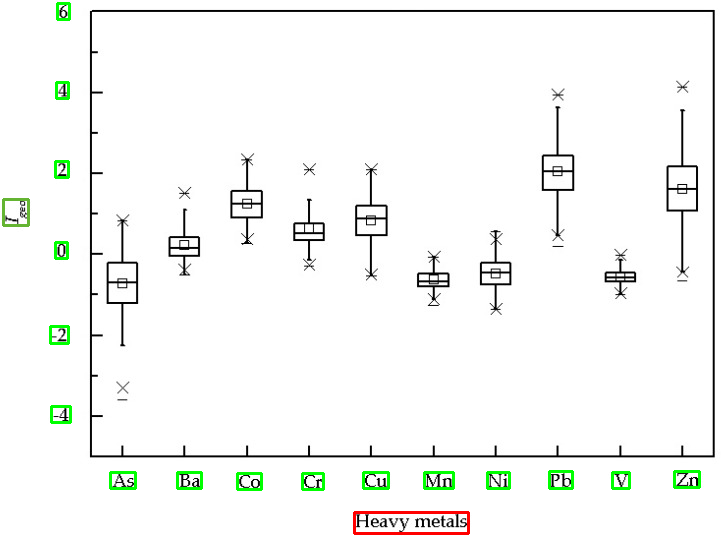

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2254396___1471-2458-8-40-2.jpg
F1 Score  0.7777777777777778
SAMESS
17
SAMESS


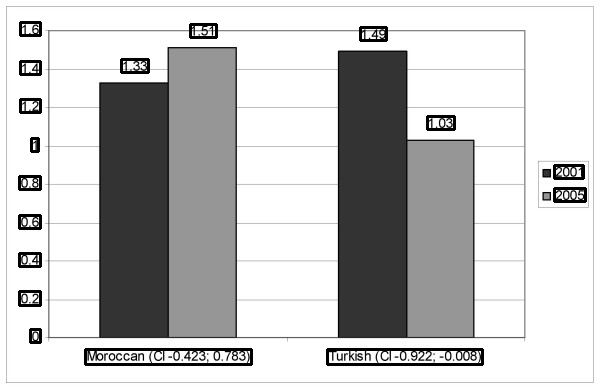

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2265669___pgen.1000037.g003.jpg
F1 Score  0.9714285714285714
SAMESS
22
SAMESS


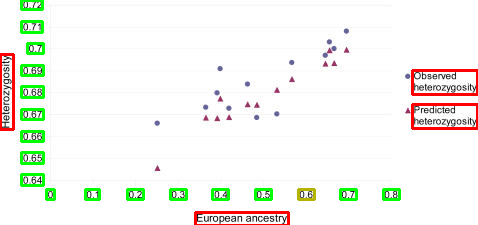

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4429935___12863_2015_194_Fig1_HTML_panel_5.jpg
F1 Score  0.5714285714285715
SAMESS
6
SAMESS


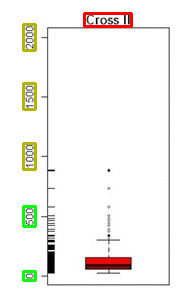

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4924057___ijerph-13-00600-g003.jpg
F1 Score  0.39999999999999997
SAMESS
33
SAMESS


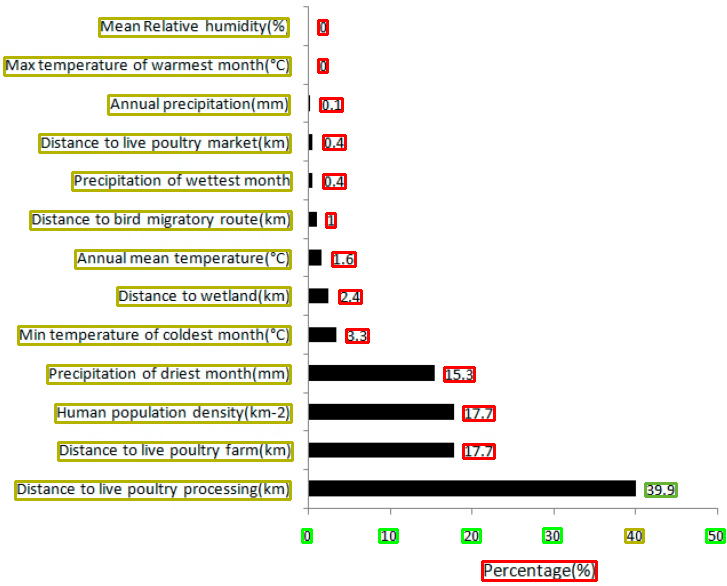

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5509277___materials-09-00666-g007.jpg
F1 Score  0.975609756097561
SAMESS
22
SAMESS


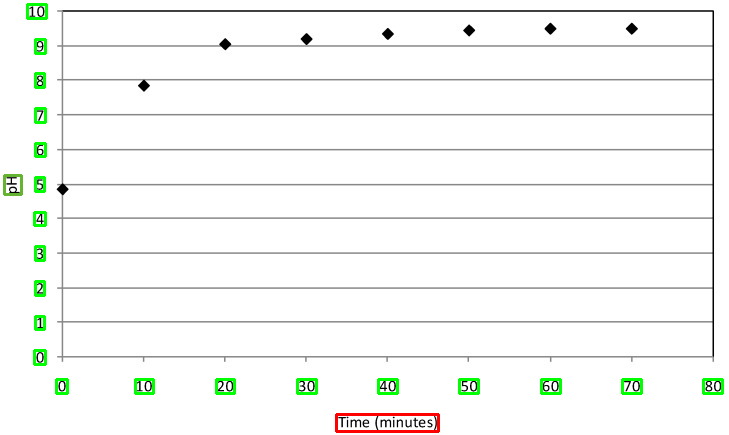

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5456481___materials-09-00089-g007.jpg
F1 Score  0.9090909090909091
SAMESS
15
SAMESS


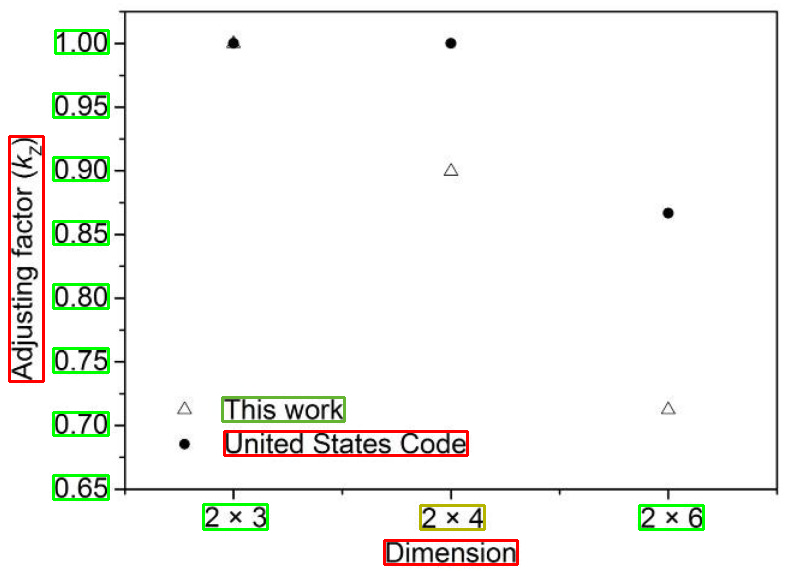

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4736111___12863_2016_339_Fig1_HTML.jpg
F1 Score  0.9600000000000001
SAMESS
16
SAMESS


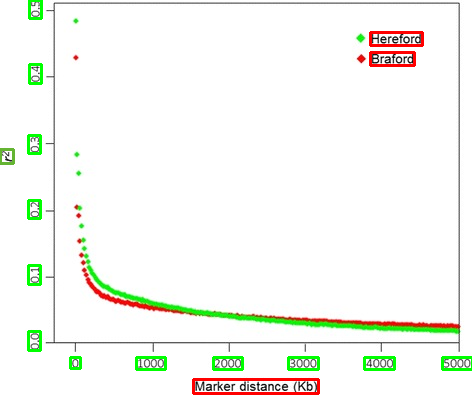

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5615736___materials-10-01082-g011.jpg
F1 Score  0.9565217391304348
SAMESS
19
SAMESS


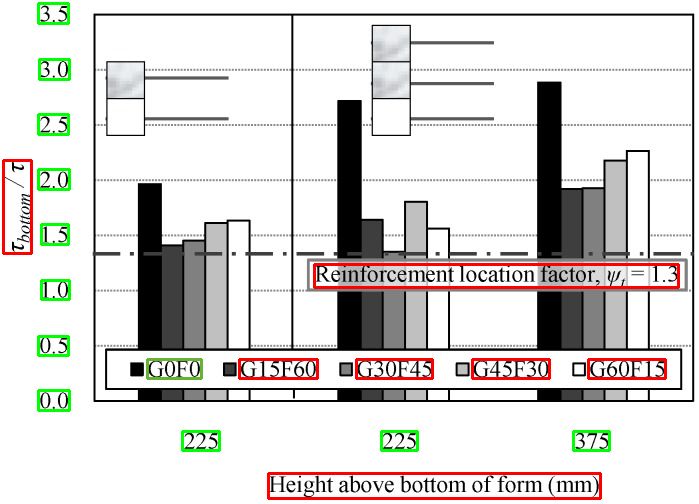

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2845104___1471-2458-10-30-1.jpg
F1 Score  0.10526315789473682
SAMESS
55
SAMESS


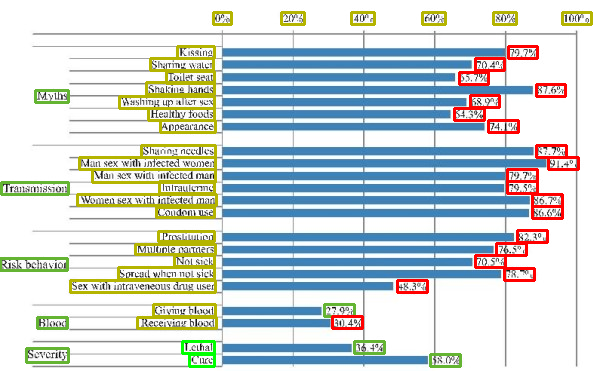

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4002537___1471-2458-14-365-1.jpg
F1 Score  0.16666666666666669
SAMESS
20
SAMESS


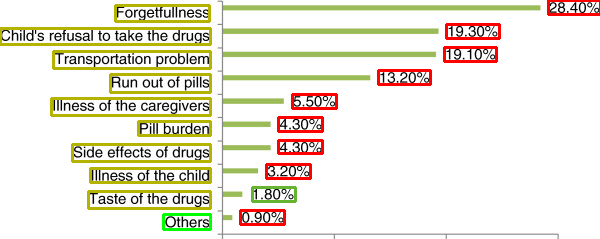

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4408026___pgen.1005176.g008.jpg
F1 Score  0.9333333333333333
SAMESS
9
SAMESS


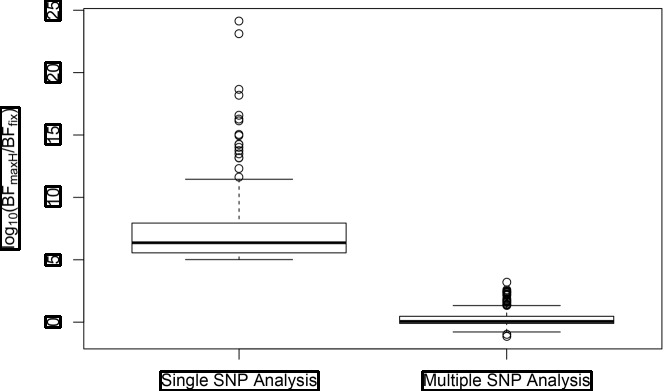

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3121632___1471-2458-11-341-2.jpg
F1 Score  1.0
SAMESS
21
SAMESS


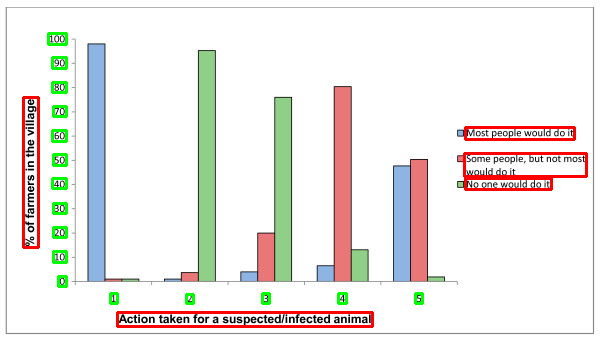

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2686163___pgen.1000517.g006.jpg
F1 Score  1.0
SAMESS
15
SAMESS


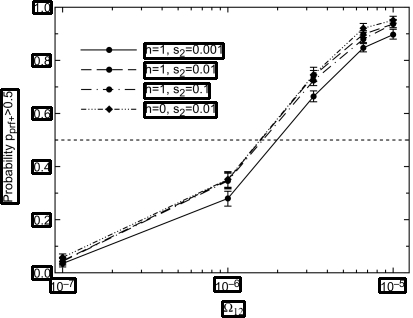

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC5290622___12889_2017_4079_Fig3_HTML.jpg
F1 Score  1.0
SAMESS
14
SAMESS


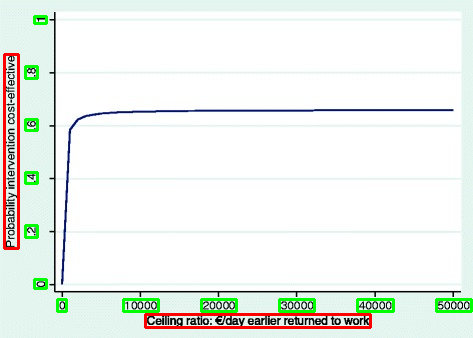

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4410462___12889_2015_1643_Fig2_HTML.jpg
F1 Score  0.4615384615384615
SAMESS
16
SAMESS


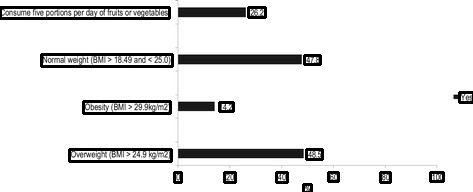

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3626222___CMMM2013-162105.005.jpg
F1 Score  1.0
SAMESS
30
SAMESS


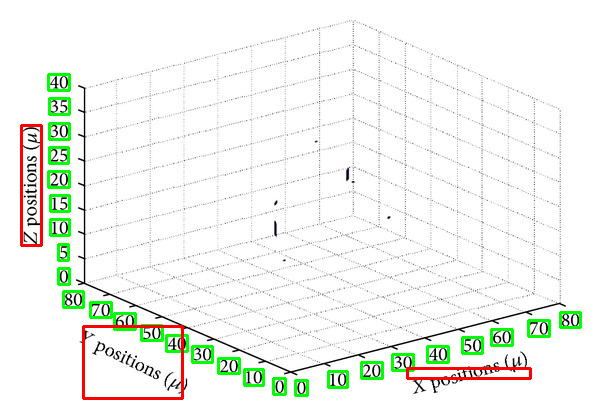

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC1183531___pgen.0010017.g001.jpg
F1 Score  0.9655172413793104
SAMESS
26
SAMESS


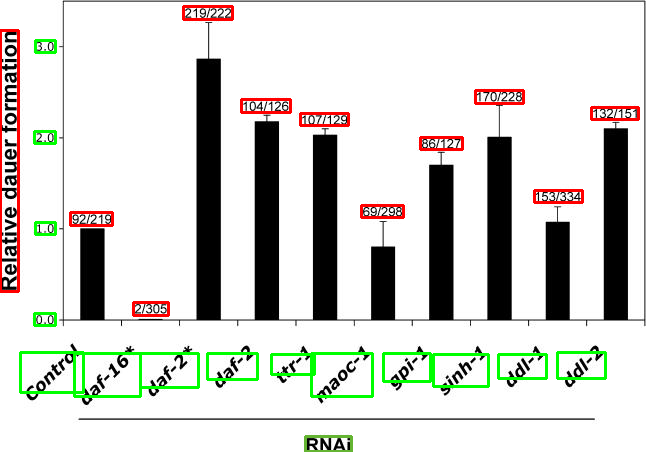

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC3933254___1471-2458-14-141-4.jpg
F1 Score  0.975609756097561
SAMESS
24
SAMESS


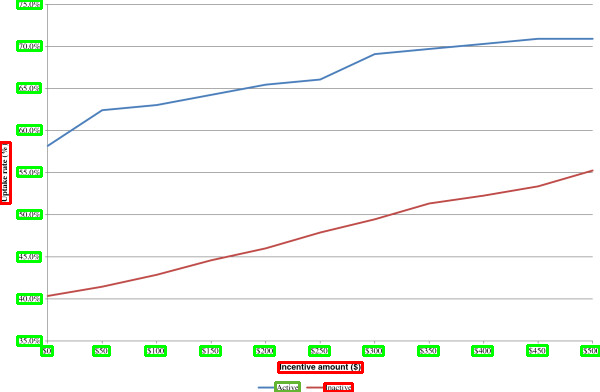

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC2705217___ijerph-06-01778f2.jpg
F1 Score  0.9600000000000001
SAMESS
15
SAMESS


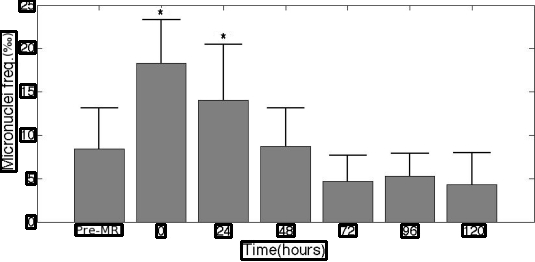

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4652872___pgen.1005534.g001.jpg
F1 Score  0.9135802469135803
SAMESS
49
SAMESS


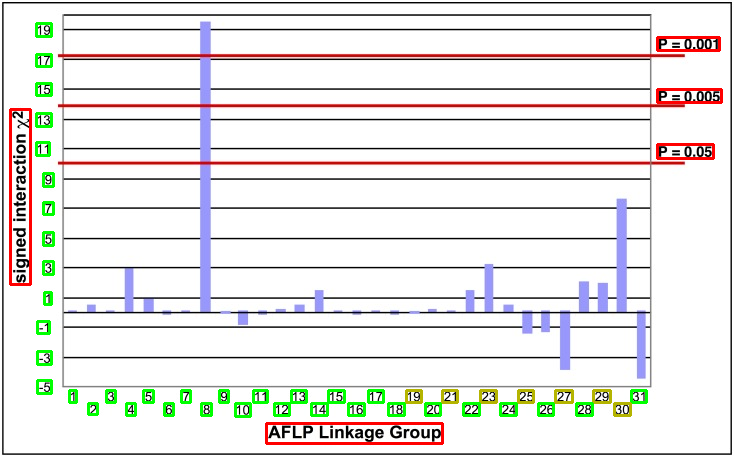

gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/PMC4593209___12881_2015_198_Fig4_HTML.jpg
F1 Score  1.0
SAMESS
12
SAMESS


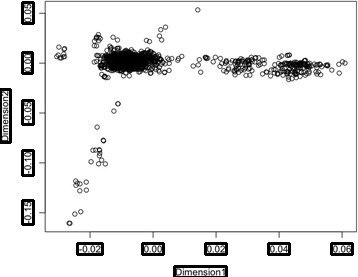

Average F1 Score : 0.8536081306421807


In [ ]:
##Rough g3
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
  filename = g_val[2]
  filename = os.path.splitext(filename)[0]
  filename = 'gdrive/MyDrive/chart_test/splits_no_GT/split_1/images/' + filename + '.jpg'

  print(filename)
  if os.path.exists(filename):
    f1_i,_a,_b = eval_test(g_val, model)
    f1_net += f1_i
    cnt += 1
  else:
    print("None")

  if cnt == 100:
    break

print("Average F1 Score :",f1_net/cnt)

In [ ]:
##Rough g2
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    #if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.8235294117647058
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  0.7755102040816326
F1 Score  0.9714285714285714
F1 Score  1.0
F1 Score  0.28571428571428575
F1 Score  0.9565217391304348
F1 Score  0.9473684210526316
F1 Score  0.9655172413793104
F1 Score  0.0
F1 Score  1.0
F1 Score  0.7499999999999999
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  0.9696969696969697
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  0.7999999999999999
F1 Score  0.6086956521739131
F1 Score  0.6153846153846153
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9600000000000001
F1 Score  0.6
F1 Score  0.9
F1 Score  0.9500000000000001
F1 Score  1.0
F1 Score  0.8695652173913044
F1 Score  1.0
F1 Score  0.761904761904762
F1 Score  0.9032258064516129
F1 Score  1.0
F1 Score  1.0
F1 Score  0.5641025641025642
F1 Score  1.0
F1 Score  0.9655172413793

In [ ]:
##Rough g5
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    #if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  0.8627450980392156
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8000000000000002
F1 Score  0.9565217391304348
F1 Score  0.9473684210526316
F1 Score  0.9333333333333333
F1 Score  0.18181818181818182
F1 Score  1.0
F1 Score  0.8235294117647058
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9600000000000001
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  0.9411764705882353
F1 Score  0.72
F1 Score  0.7586206896551724
F1 Score  0.9565217391304348
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8
F1 Score  1.0
F1 Score  0.975609756097561
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  0.9090909090909091
F1 Score  0.8695652173913044
F1 Score  0.9032258064516129
F1 Score  1.0
F1 Score  1.0
F1 Score  0.4444444444444445
F1 Score  0.8695652173913044
F1 Score  1.0
F1 Score  0.975609756097561
F1 Score  0.971428571428571

In [ ]:
##Rough g7
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    #if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.9473684210526316
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  0.8163265306122449
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9090909090909091
F1 Score  0.9565217391304348
F1 Score  0.9473684210526316
F1 Score  0.8484848484848484
F1 Score  0.6046511627906977
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  1.0
F1 Score  0.975609756097561
F1 Score  0.9411764705882353
F1 Score  1.0
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  0.9600000000000001
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  0.9411764705882353
F1 Score  0.7692307692307693
F1 Score  0.9090909090909091
F1 Score  0.9565217391304348
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.888888888888889
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9523809523809523
F1 Score  0.9166666666666666
F1 Score  0.9032258064516129
F1 Score  1.0
F1 Score  1.0
F1 Score  0.5106382978723403
F1 Score  1.0
F1 Score  0.967741935483871
F1 Score  1.0
F

In [ ]:
##Rough
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.9565217391304348
F1 Score  0.9
F1 Score  0.972972972972973
F1 Score  0.967741935483871
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  0.9803921568627451
F1 Score  1.0
F1 Score  0.9333333333333333
F1 Score  0.972972972972973
F1 Score  0.9259259259259259
F1 Score  0.9333333333333333
F1 Score  1.0
F1 Score  1.0
F1 Score  0.72
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  1.0
F1 Score  0.923076923076923
Average F1 Score : 0.9503535072222142


In [ ]:
##Rough
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    if g_val[3] == 'scatter':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
F1 Score  0.8846153846153846
F1 Score  0.888888888888889
F1 Score  0.888888888888889
F1 Score  0.8
F1 Score  1.0
F1 Score  0.8
F1 Score  1.0
F1 Score  0.8888888888888888
F1 Score  0.7000000000000001
F1 Score  0.9333333333333333
F1 Score  0.9411764705882353
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  1.0
F1 Score  0.9230769230769231
F1 Score  1.0
F1 Score  0.9600000000000001
F1 Score  0.92
F1 Score  0.8235294117647058
F1 Score  0.5
F1 Score  1.0
F1 Score  0.9850746268656716
F1 Score  0.923076923076923
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9600000000000001
F1 Score  0.9090909090909091
F1 Score  0.0
F1 Score  1.0
F1 Score  0.967741935483871
F1 Score  1.0
F1 Score  0.7407407407407407
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9090909090909091
F1 Score  0.9565217391304348
F1 Score  0.9767441860465117
F1 Score  0.9600000000000001
F1 Score  0.975609756097561
F1 Score  0.8
F1 Score  1.0
F1 Score  0.8333333333333333
F1 Score  1.0
F1 Score  0.611111111111111
F1 Score  1.0
F

In [ ]:
##Rough
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset_test):
    if g_val[3] == 'vertical bar':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.888888888888889
F1 Score  0.923076923076923
F1 Score  0.7000000000000001
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8181818181818181
F1 Score  0.7272727272727273
F1 Score  0.5555555555555556
F1 Score  1.0
F1 Score  0.47826086956521735
F1 Score  1.0
F1 Score  0.8181818181818182
F1 Score  0.7692307692307692
F1 Score  0.9523809523809523
F1 Score  0.8461538461538461
F1 Score  0.6923076923076924
F1 Score  0.6666666666666667
F1 Score  0.8749999999999999
F1 Score  0.8571428571428571
F1 Score  0.7000000000000001
F1 Score  0.7500000000000001
F1 Score  0.846153846153846
F1 Score  1.0
F1 Score  0.6153846153846153
F1 Score  0.9166666666666666
F1 Score  0.9885057471264368
F1 Score  0.7777777777777777
F1 Score  0.9230769230769231
F1 Score  0.9473684210526316
F1 Score  0.6923076923076923
F1 Score  0.0
F1 Score  0.923076923076923
F1 Score  0.88
F1 Score  0.8
F1 Score  0.47368421052631576
F1 Score  1.0
F1 Score  0.6363636363636365
F1 Score  1.0
F1 Score  0.4666666666666666
F1 Sco

***
***

In [ ]:
f1_net = 0 
for i in range(20):
  j = np.random.randint(0, high=3415, size=1)[0]
  g_val = dataset[j]
  f1_i,_a,_b = eval(g_val[0], model)
  f1_net += f1_i
  

print("Average F1 Score :",f1_net/20)

F1 Score  0.923076923076923
F1 Score  0.9696969696969697
F1 Score  0.8695652173913043
F1 Score  0.9
F1 Score  1.0
F1 Score  0.9411764705882353
F1 Score  0.6
F1 Score  0.9473684210526316
F1 Score  0.8749999999999999
F1 Score  0.8799999999999999
F1 Score  1.0
F1 Score  0.8437499999999999
F1 Score  0.45161290322580644
F1 Score  1.0
F1 Score  0.6428571428571429
F1 Score  1.0
F1 Score  0.9285714285714286
F1 Score  1.0
F1 Score  0.8148148148148148
F1 Score  0.8333333333333333
Average F1 Score : 0.8710411812304294


In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'scatter-line':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
F1 Score  0.9090909090909091
F1 Score  0.9565217391304348
F1 Score  1.0
F1 Score  0.9032258064516129
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8387096774193548
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  0.9696969696969697
F1 Score  0.8695652173913043
F1 Score  0.7333333333333334
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  1.0
F1 Score  0.9411764705882353
F1 Score  0.88
F1 Score  0.9523809523809523
F1 Score  0.9285714285714286
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  1.0
F1 Score  1.0
F1 Score  0.8799999999999999
F1 Score  0.9333333333333333
F1 Score  1.0
F1 Score  0.962962962962963
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9655172413793104
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.0
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
Average F1 Score : 0.939980698133371


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'scatter':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.962962962962963
F1 Score  1.0
F1 Score  1.0
F1 Score  1.0
F1 Score  0.9230769230769231
F1 Score  0.9166666666666666
F1 Score  0.7826086956521738
F1 Score  1.0
F1 Score  0.9090909090909091
F1 Score  1.0
F1 Score  0.0
F1 Score  1.0
F1 Score  0.8571428571428571
F1 Score  0.9500000000000001
F1 Score  0.5833333333333334
F1 Score  0.7826086956521738
F1 Score  0.888888888888889
F1 Score  0.9285714285714286
F1 Score  1.0
F1 Score  0.9166666666666666
F1 Score  0.7142857142857143
F1 Score  0.9473684210526315
F1 Score  0.9696969696969697
F1 Score  0.9655172413793104
F1 Score  0.9655172413793104
F1 Score  0.962962962962963
F1 Score  0.975609756097561
F1 Score  0.9696969696969697
F1 Score  0.9523809523809523
F1 Score  0.8571428571428571
F1 Score  0.9600000000000001
F1 Score  0.9333333333333333
F1 Score  0.9655172413793104
F1 Score  0.9166666666666666
F1 Score  1.0
F1 Score  0.9473684210526316
F1 Score  0.8461538461538461
F1 Score  0.9523809523809523
F1 Score  1.0
F1 Score  0.87999999999

In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'vertical_box':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.5
F1 Score  0.9259259259259259
F1 Score  0.7407407407407408
F1 Score  0.4666666666666667
F1 Score  0.888888888888889
F1 Score  0.8571428571428572
F1 Score  0.8571428571428571
F1 Score  0.888888888888889
F1 Score  0.8799999999999999
F1 Score  0.8333333333333334
F1 Score  0.7777777777777778
F1 Score  0.9473684210526316
F1 Score  0.9
F1 Score  0.8421052631578948
F1 Score  0.9375
F1 Score  0.888888888888889
F1 Score  0.8333333333333333
F1 Score  0.888888888888889
F1 Score  0.8571428571428571
F1 Score  0.8148148148148148
F1 Score  0.47058823529411764
F1 Score  0.9473684210526316
F1 Score  0.6666666666666666
F1 Score  0.7
F1 Score  0.9523809523809523
F1 Score  0.761904761904762
F1 Score  0.9655172413793104
F1 Score  0.8
F1 Score  0.9333333333333333
F1 Score  0.9473684210526316
F1 Score  0.0
F1 Score  0.6666666666666666
F1 Score  0.761904761904762
F1 Score  0.9655172413793104
F1 Score  0.9523809523809523
F1 Score  0.8799999999999999
F1 Score  0.8888888888888888
F1 Score  0.9090909

In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'vertical_bar':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
F1 Score  0.9696969696969697
F1 Score  0.4230769230769231
F1 Score  0.8421052631578948
F1 Score  0.7058823529411764
F1 Score  1.0
F1 Score  0.962962962962963
F1 Score  0.8181818181818181
F1 Score  0.8181818181818182
F1 Score  0.8000000000000002
F1 Score  1.0
F1 Score  0.9545454545454545
F1 Score  0.7692307692307693
F1 Score  0.923076923076923
F1 Score  0.7727272727272727
F1 Score  0.7466666666666666
F1 Score  0.9302325581395349
F1 Score  1.0
F1 Score  0.3636363636363636
F1 Score  0.7777777777777777
F1 Score  0.5714285714285714
F1 Score  0.923076923076923
F1 Score  0.888888888888889
F1 Score  1.0
F1 Score  0.8421052631578948
F1 Score  0.7499999999999999
F1 Score  0.33333333333333337
F1 Score  0.8421052631578947
F1 Score  0.6976744186046512
F1 Score  0.9302325581395349
F1 Score  0.7142857142857143
F1 Score  0.9565217391304348
F1 Score  0.9268292682926829
F1 Score  0.6666666666666667
F1 Score  0.9
F1 Score  0.7499999999999999
F1 Score  1.0
F1 Score  0.896551724137931
F1 Scor

In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'vertical_interval':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.9
F1 Score  1.0
F1 Score  0.9
Average F1 Score : 0.9333333333333332


In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'horizontal_bar':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  0.56
F1 Score  0.25641025641025644
F1 Score  0.5777777777777778
F1 Score  0.8421052631578948
F1 Score  0.8695652173913044
F1 Score  0.4
F1 Score  0.39285714285714285
F1 Score  0.3428571428571428
F1 Score  0.7586206896551725
F1 Score  0.42857142857142855
F1 Score  0.7894736842105263
F1 Score  0.0
F1 Score  0.0
F1 Score  0.8947368421052632
F1 Score  0.5405405405405405
F1 Score  0.7142857142857143
F1 Score  0.25
F1 Score  0.7857142857142857
F1 Score  0.7894736842105263
F1 Score  0.6666666666666666
F1 Score  0.5833333333333334
F1 Score  0.7857142857142858
F1 Score  0.5789473684210525
F1 Score  0.8333333333333334
F1 Score  1.0
F1 Score  0.4166666666666667
F1 Score  0.0
F1 Score  0.9444444444444444
F1 Score  0.8
F1 Score  0.0
F1 Score  0.7692307692307693
F1 Score  0.631578947368421
F1 Score  0.6984126984126985
F1 Score  0.4137931034482759
F1 Score  0.6666666666666666
F1 Score  0.0
F1 Score  0.6808510638297872
F1 Score  0.42857142857142855
F1 Score  0.6666666666666666
F1 Score  0.96

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1515: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  average, "true nor predicted", 'F-score is', len(true_sum)


F1 Score  0.9375
F1 Score  0.5454545454545455
F1 Score  0.4799999999999999
F1 Score  0.8
F1 Score  0.6666666666666666
F1 Score  0.5
F1 Score  0.208955223880597
F1 Score  0.608695652173913
F1 Score  0.8571428571428571
F1 Score  0.5454545454545455
F1 Score  0.7499999999999999
F1 Score  0.7272727272727273
F1 Score  0.25
F1 Score  0.0
F1 Score  0.6428571428571429
F1 Score  0.6666666666666666
F1 Score  0.4444444444444445
F1 Score  0.4444444444444445
F1 Score  1.0
F1 Score  0.46153846153846156
F1 Score  0.4137931034482759
F1 Score  0.6153846153846153
F1 Score  0.625
F1 Score  0.7058823529411764
F1 Score  0.4210526315789474
F1 Score  0.5625
F1 Score  0.7567567567567567
F1 Score  0.4615384615384615
F1 Score  0.8181818181818181
F1 Score  1.0
F1 Score  0.75
F1 Score  0.4999999999999999
F1 Score  0.9504950495049506
F1 Score  0.6756756756756758
F1 Score  0.7777777777777778
F1 Score  0.6
F1 Score  0.6666666666666666
F1 Score  0.8750000000000001
F1 Score  0.8070175438596492
F1 Score  0.8461538461538

In [ ]:
cnt = 0
f1_net = 0 
for g_i, g_val in enumerate(dataset):
    if g_val[3] == 'horizontal_interval':
      f1_i,_a,_b = eval(g_val[0], model)
      f1_net += f1_i
      cnt += 1

print("Average F1 Score :",f1_net/cnt)

F1 Score  1.0
Average F1 Score : 1.0


## Rough Ref.

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

graph, label, fn = dataset[0]

# read image
fn = "gdrive/MyDrive/Graph/PMC5455512___materials-08-05138-g007.jpg"
print(fn)
#img = cv2.imread(fn)

img = cv2.imread(fn, cv2.IMREAD_UNCHANGED)

f1_i,lg_i,log_i = eval(g_val[0], model)

"""
# get contours
result = img.copy()
contours = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours = contours[0] if len(contours) == 2 else contours[1]
for cntr in contours:
    x,y,w,h = cv2.boundingRect(cntr)
    cv2.rectangle(result, (x, y), (x+w, y+h), (0, 0, 255), 2)
    print("x,y,w,h:",x,y,w,h)
 
# save resulting image
#cv2.imwrite('two_blobs_result.jpg',result)      
"""
# show thresh and result    
cv2_imshow(img)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
threshold = torch.tensor([0.5])

results = (sig>threshold).float()
Labels = torch.tensor(Labels)
###
target_true += torch.sum(results == 1).float()
predicted_true += torch.sum(predicted_classes).float()
correct_true += torch.sum(
predicted_classes == target_classes * predicted_classes == 0).float()
###
from sklearn.metrics import f1_score
f1_score(Labels.numpy(), results.numpy())
###
#model = GCN(graph.ndata['feat'].shape[1], 16, 1)
from dgl.nn import GINConv
lin = torch.nn.Linear(10, 10)
conv = GINConv(lin, 'max')
res = conv(graph, feat_g)
###
#optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
optimizer.zero_grad()
feat_g = graph.ndata['feat']
labels = graph.ndata['label']
labels = labels.type(torch.float)
#logits = model(graph, feat_g).type(torch.float)
logits = model(graph, feat_g.float()).type(torch.float)
logits = torch.squeeze(logits)
lg = torch.sigmoid(logits)
loss = torch.nn.functional.binary_cross_entropy_with_logits(logits, labels)
loss1 = torch.nn.functional.binary_cross_entropy(lg, labels)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  after removing the cwd from sys.path.


In [ ]:
"""Basic DGL Dataset
"""

from __future__ import absolute_import

import os, sys, hashlib
import traceback
import abc
from .utils import download, extract_archive, get_download_dir, makedirs
from ..utils import retry_method_with_fix


ImportError: ignored

In [ ]:



class DGLDataset(object):
    """The basic DGL dataset for creating graph datasets.
    This class defines a basic template class for DGL Dataset.
    The following steps will be executed automatically:

      1. Check whether there is a dataset cache on disk
         (already processed and stored on the disk) by
         invoking ``has_cache()``. If true, goto 5.
      2. Call ``download()`` to download the data.
      3. Call ``process()`` to process the data.
      4. Call ``save()`` to save the processed dataset on disk and goto 6.
      5. Call ``load()`` to load the processed dataset from disk.
      6. Done.

    Users can overwite these functions with their
    own data processing logic.

    Parameters
    ----------
    name : str
        Name of the dataset
    url : str
        Url to download the raw dataset
    raw_dir : str
        Specifying the directory that will store the
        downloaded data or the directory that
        already stores the input data.
        Default: ~/.dgl/
    save_dir : str
        Directory to save the processed dataset.
        Default: same as raw_dir
    hash_key : tuple
        A tuple of values as the input for the hash function.
        Users can distinguish instances (and their caches on the disk)
        from the same dataset class by comparing the hash values.
        Default: (), the corresponding hash value is ``'f9065fa7'``.
    force_reload : bool
        Whether to reload the dataset. Default: False
    verbose : bool
        Whether to print out progress information

    Attributes
    ----------
    url : str
        The URL to download the dataset
    name : str
        The dataset name
    raw_dir : str
        Raw file directory contains the input data folder
    raw_path : str
        Directory contains the input data files.
        Default : ``os.path.join(self.raw_dir, self.name)``
    save_dir : str
        Directory to save the processed dataset
    save_path : str
        File path to save the processed dataset
    verbose : bool
        Whether to print information
    hash : str
        Hash value for the dataset and the setting.
    """
    def __init__(self, name, url=None, raw_dir=None, save_dir=None,
                 hash_key=(), force_reload=False, verbose=False):
        self._name = name
        self._url = url
        self._force_reload = force_reload
        self._verbose = verbose
        self._hash_key = hash_key
        self._hash = self._get_hash()

        # if no dir is provided, the default dgl download dir is used.
        if raw_dir is None:
            self._raw_dir = get_download_dir()
        else:
            self._raw_dir = raw_dir

        if save_dir is None:
            self._save_dir = self._raw_dir
        else:
            self._save_dir = save_dir

        self._load()



    def download(self):
        """Overwite to realize your own logic of downloading data.

        It is recommended to download the to the :obj:`self.raw_dir`
        folder. Can be ignored if the dataset is
        already in :obj:`self.raw_dir`.
        """
        pass



    def save(self):
        """Overwite to realize your own logic of
        saving the processed dataset into files.

        It is recommended to use ``dgl.data.utils.save_graphs``
        to save dgl graph into files and use
        ``dgl.data.utils.save_info`` to save extra
        information into files.
        """
        pass




    def load(self):
        """Overwite to realize your own logic of
        loading the saved dataset from files.

        It is recommended to use ``dgl.data.utils.load_graphs``
        to load dgl graph from files and use
        ``dgl.data.utils.load_info`` to load extra information
        into python dict object.
        """
        pass



    def process(self):
        """Overwrite to realize your own logic of processing the input data.
        """
        raise NotImplementedError




    def has_cache(self):
        """Overwrite to realize your own logic of
        deciding whether there exists a cached dataset.

        By default False.
        """
        return False


    @retry_method_with_fix(download)
    def _download(self):
        """Download dataset by calling ``self.download()`` if the dataset does not exists under ``self.raw_path``.
            By default ``self.raw_path = os.path.join(self.raw_dir, self.name)``
            One can overwrite ``raw_path()`` function to change the path.
        """
        if os.path.exists(self.raw_path):  # pragma: no cover
            return

        makedirs(self.raw_dir)
        self.download()

    def _load(self):
        """Entry point from __init__ to load the dataset.
            if the cache exists:
                Load the dataset from saved dgl graph and information files.
                If loadin process fails, re-download and process the dataset.
            else:
                1. Download the dataset if needed.
                2. Process the dataset and build the dgl graph.
                3. Save the processed dataset into files.
        """
        load_flag = not self._force_reload and self.has_cache()

        if load_flag:
            try:
                self.load()
                if self.verbose:
                    print('Done loading data from cached files.')
            except KeyboardInterrupt:
                raise
            except:
                load_flag = False
                if self.verbose:
                    print(traceback.format_exc())
                    print('Loading from cache failed, re-processing.')

        if not load_flag:
            self._download()
            self.process()
            self.save()
            if self.verbose:
                print('Done saving data into cached files.')

    def _get_hash(self):
        """Compute the hash of the input tuple

        Example
        -------
        Assume `self._hash_key = (10, False, True)`

        >>> hash_value = self._get_hash()
        >>> hash_value
        'a770b222'
        """
        hash_func = hashlib.sha1()
        hash_func.update(str(self._hash_key).encode('utf-8'))
        return hash_func.hexdigest()[:8]

    @property
    def url(self):
        """Get url to download the raw dataset.
        """
        return self._url

    @property
    def name(self):
        """Name of the dataset.
        """
        return self._name

    @property
    def raw_dir(self):
        """Raw file directory contains the input data folder.
        """
        return self._raw_dir

    @property
    def raw_path(self):
        """Directory contains the input data files.
            By default raw_path = os.path.join(self.raw_dir, self.name)
        """
        return os.path.join(self.raw_dir, self.name)

    @property
    def save_dir(self):
        """Directory to save the processed dataset.
        """
        return self._save_dir

    @property
    def save_path(self):
        """Path to save the processed dataset.
        """
        return os.path.join(self._save_dir, self.name)

    @property
    def verbose(self):
        """Whether to print information.
        """
        return self._verbose

    @property
    def hash(self):
        """Hash value for the dataset and the setting.
        """
        return self._hash


    @abc.abstractmethod
    def __getitem__(self, idx):
        """Gets the data object at index.
        """
        pass


    @abc.abstractmethod
    def __len__(self):
        """The number of examples in the dataset."""
        pass

